## Imports

In [1]:
#!pip install -qq torch==1.7.1+cu110 torchvision==0.8.2+cu110 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html
!pip install -qq git+https://github.com/qubvel/segmentation_models.pytorch
!pip install -qq timm==0.4.12
!pip install -qq einops

In [2]:
#!pip install -qq torch==1.9.0  torchvision==0.10.0 torchaudio==0.9.0 -f https://download.pytorch.org/whl/torch_stable.html

In [3]:
#! pip install pytorch==1.9.0 torchvision==0.10.0 torchaudio==0.9.0 cudatoolkit=10.2

In [4]:
import os
import gc
import sys
import glob

import torch
import torch.nn as nn
import albumentations as A

import cv2
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import tqdm
import segmentation_models_pytorch as smp
from sklearn.model_selection import StratifiedKFold

import tifffile as tiff

torch.backends.cudnn.benchmark = True

## Configuration

In [5]:
fold = 0
nfolds = 2
imsize = 1024
train_csv = "../input/hubmap-organ-segmentation/train.csv"
BATCH_SIZE = 1
DEVICE = ('cuda' if torch.cuda.is_available() else 'cpu')
EPOCHS = 40
NUM_WORKERS = 4
SEED = 422
TRAIN_PATH = "../input/hubmap-organ-segmentation/train_images/"
MASK_PATH = '../input/hubmap-multi-mask/mask/'

In [6]:
def set_seed(seed=12):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    torch.backends.cudnn.deterministic = True
set_seed(12)

## Helper Functions

In [7]:
def transformer(p=1.0):
    return A.Compose([
        A.augmentations.crops.RandomResizedCrop(height=1024, width=1024),
        A.HorizontalFlip(p=0.4),
        A.VerticalFlip(p=0.4),
        A.RandomRotate90(p=0.4),
        A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=0.9, 
                         border_mode=cv2.BORDER_REFLECT),
        A.OneOf([
            A.OpticalDistortion(p=0.4),
            A.GridDistortion(p=.1),
            A.PiecewiseAffine(p=0.4),
        ], p=0.5),
        A.OneOf([
            A.HueSaturationValue(10,15,10),
            A.CLAHE(clip_limit=2),
            A.RandomBrightnessContrast(),            
        ], p=0.5),
        #A.Normalize()
    ], p=p)

In [8]:
class HuBMAPDataset(torch.utils.data.Dataset):
    def __init__(self, fold=fold, train=True, tfms=None):
        self.train = train
        ids = pd.read_csv(train_csv).id.values
        labels = pd.read_csv(train_csv).organ.values
        kf = StratifiedKFold(n_splits=nfolds,random_state=SEED,shuffle=True)
        ids = (ids[list(kf.split(ids,labels))[fold][0 if train else 1]]).tolist()
        self.fnames = [fname for fname in os.listdir(TRAIN_PATH) if int(fname.split('.')[0]) in ids]
        self.image_size = imsize
        self.tfms = tfms
        
    def img2tensor(self, img,dtype:np.dtype=np.float32):
        if img.ndim==2 : img = np.expand_dims(img,2)
        img = np.transpose(img,(2,0,1)) # C , H , W
        return torch.from_numpy(img.astype(dtype, copy=False))
    
    def __len__(self):
        return len(self.fnames)
    
    def resize(self, img, interp):
        return  cv2.resize(
            img, (self.image_size, self.image_size), interpolation=interp)
    
    def __getitem__(self, idx):
        fname = self.fnames[idx]
        img = cv2.cvtColor(cv2.imread(TRAIN_PATH + fname), cv2.COLOR_BGR2RGB)
        mask = cv2.imread((MASK_PATH + fname.replace('tiff','png')),cv2.IMREAD_GRAYSCALE)
        if self.tfms is not None:
            augmented = self.tfms(image=img,mask=mask)
            img,mask = augmented['image'],augmented['mask']
            return self.img2tensor(img ) , self.img2tensor(mask)
        return self.img2tensor(self.resize(img , cv2.INTER_NEAREST)) , self.img2tensor(self.resize(mask , cv2.INTER_NEAREST))
        

In [9]:
ds = HuBMAPDataset(tfms=transformer())
dl = torch.utils.data.DataLoader(ds,batch_size=4,shuffle=False,num_workers=4)
it = iter(dl)
imgs,masks = next(it)

/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [10]:
# TRAIN_IMG_PATH = "../input/hubmap-organ-segmentation/train_images"
# TEST_IMG_PATH = "../input/hubmap-organ-segmentation/test_images"

# TRAIN_IMG_ANNOTATIONS = "../input/hubmap-organ-segmentation/train_annotations"
# TRAIN_IMG_INFO = "../input/hubmap-organ-segmentation/train.csv"

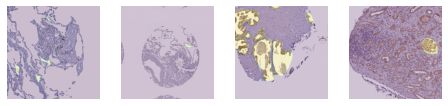

In [11]:
plt.figure(figsize=(16,16))
for i,(img,mask) in enumerate(zip(imgs,masks)):
    img = ((img.permute(1,2,0))).numpy().astype(np.uint8)  # H , W , C
    plt.subplot(8,8,i+1)
    plt.imshow(img,vmin=0,vmax=255)
    plt.imshow(mask.squeeze().numpy(), alpha=0.2)
    plt.axis('off')
    plt.subplots_adjust(wspace=None, hspace=None)
    
del ds,dl,imgs,masks

In [12]:
# CoAT-5level

# https://github.com/mlpc-ucsd/CoaT/blob/main/src/models/coat.py

"""
CoaT architecture.

Modified from timm/models/vision_transformer.py
"""

import torch
import torch.nn as nn
import torch.nn.functional as F

from timm.data import IMAGENET_DEFAULT_MEAN, IMAGENET_DEFAULT_STD
from timm.models.layers import DropPath, to_2tuple, trunc_normal_
from timm.models.registry import register_model

from einops import rearrange
from functools import partial
from torch import nn, einsum
import pdb

# __all__ = [
# 	"coat_tiny",
# 	"coat_mini",
# 	"coat_small",
# 	"coat_lite_tiny",
# 	"coat_lite_mini",
# 	"coat_lite_small"
# ]



def init_weight(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        #nn.init.xavier_uniform_(m.weight, gain=1)
        #nn.init.xavier_normal_(m.weight, gain=1)
        #nn.init.kaiming_uniform_(m.weight, mode='fan_in', nonlinearity='relu')
        nn.init.kaiming_normal_(m.weight, mode='fan_in', nonlinearity='relu')
        #nn.init.orthogonal_(m.weight, gain=1)
        if m.bias is not None:
            m.bias.data.zero_()
    elif classname.find('Batch') != -1:
        m.weight.data.normal_(1,0.02)
        m.bias.data.zero_()
    elif classname.find('Linear') != -1:
        nn.init.orthogonal_(m.weight, gain=1)
        if m.bias is not None:
            m.bias.data.zero_()
    elif classname.find('Embedding') != -1:
        nn.init.orthogonal_(m.weight, gain=1)


#---------------------------------------------
#https://github.com/facebookresearch/ConvNeXt/blob/main/models/convnext.py#L15
class LayerNorm2d(nn.Module):
	def __init__(self, dim, eps=1e-6):
		super().__init__()
		self.dim = dim
		self.weight = nn.Parameter(torch.ones(dim))
		self.bias = nn.Parameter(torch.zeros(dim))
		self.eps = eps
	
	def forward(self, x):
		batch_size,C,H,W = x.shape
		#assert C==self.dim, 'C=%d, self.dim=%d'%(C,self.dim)
		#print('C=%d, self.dim=%d'%(C,self.dim))
		
		u = x.mean(1, keepdim=True)
		s = (x - u).pow(2).mean(1, keepdim=True)
		x = (x - u) / torch.sqrt(s + self.eps)
		x = self.weight[:, None, None] * x + self.bias[:, None, None]
		return x
#---------------------------------------------

def _cfg_coat(url='', **kwargs):
	return {
		'url': url,
		'num_classes': 1000, 'input_size': (3, 224, 224), 'pool_size': None,
		'crop_pct': .9, 'interpolation': 'bicubic',
		'mean': IMAGENET_DEFAULT_MEAN, 'std': IMAGENET_DEFAULT_STD,
		'first_conv': 'patch_embed.proj', 'classifier': 'head',
		**kwargs
	}


class Mlp(nn.Module):
	""" Feed-forward network (FFN, a.k.a. MLP) class. """
	def __init__(self, in_features, hidden_features=None, out_features=None, act_layer=nn.GELU, drop=0.):
		super().__init__()
		out_features = out_features or in_features
		hidden_features = hidden_features or in_features
		self.fc1 = nn.Linear(in_features, hidden_features)
		self.act = act_layer()
		self.fc2 = nn.Linear(hidden_features, out_features)
		self.drop = nn.Dropout(drop)
	
	def forward(self, x):
		x = self.fc1(x)
		x = self.act(x)
		x = self.drop(x)
		x = self.fc2(x)
		x = self.drop(x)
		return x


class ConvRelPosEnc(nn.Module):
	""" Convolutional relative position encoding. """
	def __init__(self, Ch, h, window):
		"""
		Initialization.
			Ch: Channels per head.
			h: Number of heads.
			window: Window size(s) in convolutional relative positional encoding. It can have two forms:
					1. An integer of window size, which assigns all attention heads with the same window size in ConvRelPosEnc.
					2. A dict mapping window size to #attention head splits (e.g. {window size 1: #attention head split 1, window size 2: #attention head split 2})
					   It will apply different window size to the attention head splits.
		"""
		super().__init__()
		
		if isinstance(window, int):
			window = {window: h}                                                         # Set the same window size for all attention heads.
			self.window = window
		elif isinstance(window, dict):
			self.window = window
		else:
			raise ValueError()
		
		self.conv_list = nn.ModuleList()
		self.head_splits = []
		for cur_window, cur_head_split in window.items():
			dilation = 1                                                                 # Use dilation=1 at default.
			padding_size = (cur_window + (cur_window - 1) * (dilation - 1)) // 2         # Determine padding size. Ref: https://discuss.pytorch.org/t/how-to-keep-the-shape-of-input-and-output-same-when-dilation-conv/14338
			cur_conv = nn.Conv2d(cur_head_split*Ch, cur_head_split*Ch,
			                     kernel_size=(cur_window, cur_window),
			                     padding=(padding_size, padding_size),
			                     dilation=(dilation, dilation),
			                     groups=cur_head_split*Ch,
			                     )
			self.conv_list.append(cur_conv)
			self.head_splits.append(cur_head_split)
		self.channel_splits = [x*Ch for x in self.head_splits]
	
	def forward(self, q, v, size):
		B, h, N, Ch = q.shape
		H, W = size
		assert N == 1 + H * W
		
		# Convolutional relative position encoding.
		q_img = q[:,:,1:,:]                                                              # Shape: [B, h, H*W, Ch].
		v_img = v[:,:,1:,:]                                                              # Shape: [B, h, H*W, Ch].
		
		v_img = rearrange(v_img, 'B h (H W) Ch -> B (h Ch) H W', H=H, W=W)               # Shape: [B, h, H*W, Ch] -> [B, h*Ch, H, W].
		v_img_list = torch.split(v_img, self.channel_splits, dim=1)                      # Split according to channels.
		conv_v_img_list = [conv(x) for conv, x in zip(self.conv_list, v_img_list)]
		conv_v_img = torch.cat(conv_v_img_list, dim=1)
		conv_v_img = rearrange(conv_v_img, 'B (h Ch) H W -> B h (H W) Ch', h=h)          # Shape: [B, h*Ch, H, W] -> [B, h, H*W, Ch].
		
		EV_hat_img = q_img * conv_v_img
		zero = torch.zeros((B, h, 1, Ch), dtype=q.dtype, layout=q.layout, device=q.device)
		EV_hat = torch.cat((zero, EV_hat_img), dim=2)                                # Shape: [B, h, N, Ch].
		
		return EV_hat


class FactorAtt_ConvRelPosEnc(nn.Module):
	""" Factorized attention with convolutional relative position encoding class. """
	def __init__(self, dim, num_heads=8, qkv_bias=False, qk_scale=None, attn_drop=0., proj_drop=0., shared_crpe=None):
		super().__init__()
		self.num_heads = num_heads
		head_dim = dim // num_heads
		self.scale = qk_scale or head_dim ** -0.5
		
		self.qkv = nn.Linear(dim, dim * 3, bias=qkv_bias)
		self.attn_drop = nn.Dropout(attn_drop)                                           # Note: attn_drop is actually not used.
		self.proj = nn.Linear(dim, dim)
		self.proj_drop = nn.Dropout(proj_drop)
		
		# Shared convolutional relative position encoding.
		self.crpe = shared_crpe
	
	def forward(self, x, size):
		B, N, C = x.shape
		
		# Generate Q, K, V.
		qkv = self.qkv(x).reshape(B, N, 3, self.num_heads, C // self.num_heads).permute(2, 0, 3, 1, 4)  # Shape: [3, B, h, N, Ch].
		q, k, v = qkv[0], qkv[1], qkv[2]                                                 # Shape: [B, h, N, Ch].
		
		# Factorized attention.
		k_softmax = k.softmax(dim=2)                                                     # Softmax on dim N.
		k_softmax_T_dot_v = einsum('b h n k, b h n v -> b h k v', k_softmax, v)          # Shape: [B, h, Ch, Ch].
		factor_att        = einsum('b h n k, b h k v -> b h n v', q, k_softmax_T_dot_v)  # Shape: [B, h, N, Ch].
		
		# Convolutional relative position encoding.
		crpe = self.crpe(q, v, size=size)                                                # Shape: [B, h, N, Ch].
		
		# Merge and reshape.
		x = self.scale * factor_att + crpe
		x = x.transpose(1, 2).reshape(B, N, C)                                           # Shape: [B, h, N, Ch] -> [B, N, h, Ch] -> [B, N, C].
		
		# Output projection.
		x = self.proj(x)
		x = self.proj_drop(x)
		
		return x                                                                         # Shape: [B, N, C].


class ConvPosEnc(nn.Module):
	""" Convolutional Position Encoding.
		Note: This module is similar to the conditional position encoding in CPVT.
	"""
	def __init__(self, dim, k=3):
		super(ConvPosEnc, self).__init__()
		self.proj = nn.Conv2d(dim, dim, k, 1, k//2, groups=dim)
	
	def forward(self, x, size):
		B, N, C = x.shape
		H, W = size
		assert N == 1 + H * W
		
		# Extract CLS token and image tokens.
		cls_token, img_tokens = x[:, :1], x[:, 1:]                                       # Shape: [B, 1, C], [B, H*W, C].
		
		# Depthwise convolution.
		feat = img_tokens.transpose(1, 2).view(B, C, H, W)
		x = self.proj(feat) + feat
		x = x.flatten(2).transpose(1, 2)
		
		# Combine with CLS token.
		x = torch.cat((cls_token, x), dim=1)
		
		return x


class SerialBlock(nn.Module):
	""" Serial block class.
		Note: In this implementation, each serial block only contains a conv-attention and a FFN (MLP) module. """
	def __init__(self, dim, num_heads, mlp_ratio=4., qkv_bias=False, qk_scale=None, drop=0., attn_drop=0.,
	             drop_path=0., act_layer=nn.GELU, norm_layer=nn.LayerNorm,
	             shared_cpe=None, shared_crpe=None):
		super().__init__()
		
		# Conv-Attention.
		self.cpe = shared_cpe
		
		self.norm1 = norm_layer(dim)
		self.factoratt_crpe = FactorAtt_ConvRelPosEnc(
			dim, num_heads=num_heads, qkv_bias=qkv_bias, qk_scale=qk_scale, attn_drop=attn_drop, proj_drop=drop,
			shared_crpe=shared_crpe)
		self.drop_path = DropPath(drop_path) if drop_path > 0. else nn.Identity()
		
		# MLP.
		self.norm2 = norm_layer(dim)
		mlp_hidden_dim = int(dim * mlp_ratio)
		self.mlp = Mlp(in_features=dim, hidden_features=mlp_hidden_dim, act_layer=act_layer, drop=drop)
	
	def forward(self, x, size):
		# Conv-Attention.
		x = self.cpe(x, size)                  # Apply convolutional position encoding.
		cur = self.norm1(x)
		cur = self.factoratt_crpe(cur, size)   # Apply factorized attention and convolutional relative position encoding.
		x = x + self.drop_path(cur)
		
		# MLP.
		cur = self.norm2(x)
		cur = self.mlp(cur)
		x = x + self.drop_path(cur)
		
		return x


class ParallelBlock(nn.Module):
	""" Parallel block class. """
	def __init__(self, dims, num_heads, mlp_ratios=[], qkv_bias=False, qk_scale=None, drop=0., attn_drop=0.,
	             drop_path=0., act_layer=nn.GELU, norm_layer=nn.LayerNorm,
	             shared_cpes=None, shared_crpes=None):
		super().__init__()
		
		# Conv-Attention.
		self.cpes = shared_cpes
		
		self.norm12 = norm_layer(dims[1])
		self.norm13 = norm_layer(dims[2])
		self.norm14 = norm_layer(dims[3])
		self.norm15 = norm_layer(dims[4])


		self.factoratt_crpe2 = FactorAtt_ConvRelPosEnc(
			dims[1], num_heads=num_heads, qkv_bias=qkv_bias, qk_scale=qk_scale, attn_drop=attn_drop, proj_drop=drop,
			shared_crpe=shared_crpes[1]
		)
		self.factoratt_crpe3 = FactorAtt_ConvRelPosEnc(
			dims[2], num_heads=num_heads, qkv_bias=qkv_bias, qk_scale=qk_scale, attn_drop=attn_drop, proj_drop=drop,
			shared_crpe=shared_crpes[2]
		)
		self.factoratt_crpe4 = FactorAtt_ConvRelPosEnc(
			dims[3], num_heads=num_heads, qkv_bias=qkv_bias, qk_scale=qk_scale, attn_drop=attn_drop, proj_drop=drop,
			shared_crpe=shared_crpes[3]
		)
		self.factoratt_crpe5 = FactorAtt_ConvRelPosEnc(
			dims[4], num_heads=num_heads, qkv_bias=qkv_bias, qk_scale=qk_scale, attn_drop=attn_drop, proj_drop=drop,
			shared_crpe=shared_crpes[4]
		)


		self.drop_path = DropPath(drop_path) if drop_path > 0. else nn.Identity()
		
		# MLP.
		self.norm22 = norm_layer(dims[1])
		self.norm23 = norm_layer(dims[2])
		self.norm24 = norm_layer(dims[3])
		self.norm25 = norm_layer(dims[4])

		assert dims[1] == dims[2] == dims[3] ==dims[4]                             # In parallel block, we assume dimensions are the same and share the linear transformation.
		assert mlp_ratios[1] == mlp_ratios[2] == mlp_ratios[3]
		mlp_hidden_dim = int(dims[1] * mlp_ratios[1])
		self.mlp2 = self.mlp3 = self.mlp4 =self.mlp5= Mlp(in_features=dims[1], hidden_features=mlp_hidden_dim, act_layer=act_layer, drop=drop)
	
	def upsample(self, x, output_size, size):
		""" Feature map up-sampling. """
		return self.interpolate(x, output_size=output_size, size=size)
	
	def downsample(self, x, output_size, size):
		""" Feature map down-sampling. """
		return self.interpolate(x, output_size=output_size, size=size)
	
	def interpolate(self, x, output_size, size):
		""" Feature map interpolation. """
		B, N, C = x.shape
		H, W = size
		assert N == 1 + H * W
		
		cls_token  = x[:, :1, :]
		img_tokens = x[:, 1:, :]
		
		img_tokens = img_tokens.transpose(1, 2).reshape(B, C, H, W)
		img_tokens = F.interpolate(img_tokens, size=output_size, mode='bilinear')  # FIXME: May have alignment issue.
		img_tokens = img_tokens.reshape(B, C, -1).transpose(1, 2)
		
		out = torch.cat((cls_token, img_tokens), dim=1)
		
		return out
	
	def forward(self, x1, x2, x3, x4, x5,sizes):
		_, (H2, W2), (H3, W3), (H4, W4),(H5,W5) = sizes
		
		# Conv-Attention.
		x2 = self.cpes[1](x2, size=(H2, W2))  # Note: x1 is ignored.
		x3 = self.cpes[2](x3, size=(H3, W3))
		x4 = self.cpes[3](x4, size=(H4, W4))
		x5 = self.cpes[4](x5, size=(H5, W5))
		
		cur2 = self.norm12(x2)
		cur3 = self.norm13(x3)
		cur4 = self.norm14(x4)
		cur5 = self.norm15(x5)

		cur2 = self.factoratt_crpe2(cur2, size=(H2,W2))
		cur3 = self.factoratt_crpe3(cur3, size=(H3,W3))
		cur4 = self.factoratt_crpe4(cur4, size=(H4,W4))
		cur5 = self.factoratt_crpe4(cur5, size=(H5,W5))


		upsample3_2 = self.upsample(cur3, output_size=(H2,W2), size=(H3,W3))
		upsample4_3 = self.upsample(cur4, output_size=(H3,W3), size=(H4,W4))
		upsample4_2 = self.upsample(cur4, output_size=(H2,W2), size=(H4,W4))
		downsample2_3 = self.downsample(cur2, output_size=(H3,W3), size=(H2,W2))
		downsample3_4 = self.downsample(cur3, output_size=(H4,W4), size=(H3,W3))
		downsample2_4 = self.downsample(cur2, output_size=(H4,W4), size=(H2,W2))
		upsample5_2 = self.upsample(cur5, output_size=(H2,W2), size=(H5,W5))
		upsample5_3 = self.upsample(cur5, output_size=(H3,W3), size=(H5,W5))
		downsample3_5 = self.downsample(cur3, output_size=(H5,W5), size=(H3,W3))
		upsample5_4 = self.upsample(cur5, output_size=(H4,W4), size=(H5,W5))
		downsample2_5 = self.downsample(cur2, output_size=(H5,W5), size=(H2,W2))
		downsample4_5 = self.downsample(cur4, output_size=(H5,W5), size=(H4,W4))
        
     

		# cur2 = cur2  + upsample3_2   + upsample4_2+  upsample5_2
		# cur3 = cur3  + upsample4_3   + downsample2_3 + upsample5_3
		# cur4 = cur4  + downsample3_4 + downsample2_4 + upsample5_4 
		# cur5 = cur5  + downsample3_5 + downsample2_5 + downsample4_5 4
        # not use all connetction
		cur2 = cur2  + upsample3_2   + upsample4_2
		cur3 = cur3  + upsample4_3   + downsample2_3
		cur4 = cur4  + upsample5_4   + downsample2_4
		cur5 = cur5  + downsample4_5 + downsample2_5


		x2 = x2 + self.drop_path(cur2)
		x3 = x3 + self.drop_path(cur3)
		x4 = x4 + self.drop_path(cur4)
		x5 = x5 + self.drop_path(cur5)
		
		# MLP.
		cur2 = self.norm22(x2)
		cur3 = self.norm23(x3)
		cur4 = self.norm24(x4)
		cur5 = self.norm25(x5)

		cur2 = self.mlp2(cur2)
		cur3 = self.mlp3(cur3)
		cur4 = self.mlp4(cur4)
		cur5 = self.mlp5(cur5)

		x2 = x2 + self.drop_path(cur2)
		x3 = x3 + self.drop_path(cur3)
		x4 = x4 + self.drop_path(cur4)
		x5 = x5 + self.drop_path(cur5)
		
		return x1, x2, x3, x4, x5


class PatchEmbed(nn.Module):
	""" Image to Patch Embedding """
	def __init__(self, patch_size=16, in_chans=3, embed_dim=768):
		super().__init__()
		patch_size = to_2tuple(patch_size)
		
		self.patch_size = patch_size
		self.proj = nn.Conv2d(in_chans, embed_dim, kernel_size=patch_size, stride=patch_size)
		self.norm = nn.LayerNorm(embed_dim)
	
	def forward(self, x):
		_, _, H, W = x.shape
		out_H, out_W = H // self.patch_size[0], W // self.patch_size[1]
		
		x = self.proj(x).flatten(2).transpose(1, 2)
		out = self.norm(x)
		
		return out, (out_H, out_W)


class CoaT(nn.Module):
	""" CoaT class. """
	def __init__(self, patch_size=16, in_chans=3, embed_dims=[0, 0, 0, 0],
	             serial_depths=[0, 0, 0, 0], parallel_depth=0,
	             num_heads=0, mlp_ratios=[0, 0, 0, 0], qkv_bias=True, qk_scale=None, drop_rate=0., attn_drop_rate=0.,
	             drop_path_rate=0.,
	             norm_layer=partial(nn.LayerNorm, eps=1e-6),
	             return_interm_layers=True,
	             out_features=['x1_nocls','x2_nocls','x3_nocls','x4_nocls','x5_nocls'],
	             crpe_window={3:2, 5:3, 7:3},
	             pretrain=None,
	             out_norm = nn.Identity, #use nn.Identity, nn.BatchNorm2d, LayerNorm2d
	             **kwargs):
		super().__init__()
		self.return_interm_layers = return_interm_layers
		self.pretrain     = pretrain
		self.embed_dims   = embed_dims
		self.out_features = out_features
		#self.num_classes  = num_classes
		
		# Patch embeddings.
		self.patch_embed1 = PatchEmbed(patch_size=patch_size, in_chans=in_chans, embed_dim=embed_dims[0])
		self.patch_embed2 = PatchEmbed(patch_size=2, in_chans=embed_dims[0], embed_dim=embed_dims[1])
		self.patch_embed3 = PatchEmbed(patch_size=2, in_chans=embed_dims[1], embed_dim=embed_dims[2])
		self.patch_embed4 = PatchEmbed(patch_size=2, in_chans=embed_dims[2], embed_dim=embed_dims[3])
		self.patch_embed5 = PatchEmbed(patch_size=2, in_chans=embed_dims[3], embed_dim=embed_dims[4])
		
		# Class tokens.
		self.cls_token1 = nn.Parameter(torch.zeros(1, 1, embed_dims[0]))
		self.cls_token2 = nn.Parameter(torch.zeros(1, 1, embed_dims[1]))
		self.cls_token3 = nn.Parameter(torch.zeros(1, 1, embed_dims[2]))
		self.cls_token4 = nn.Parameter(torch.zeros(1, 1, embed_dims[3]))
		self.cls_token5 = nn.Parameter(torch.zeros(1, 1, embed_dims[4]))
		
		# Convolutional position encodings.
		self.cpe1 = ConvPosEnc(dim=embed_dims[0], k=3)
		self.cpe2 = ConvPosEnc(dim=embed_dims[1], k=3)
		self.cpe3 = ConvPosEnc(dim=embed_dims[2], k=3)
		self.cpe4 = ConvPosEnc(dim=embed_dims[3], k=3)
		self.cpe5 = ConvPosEnc(dim=embed_dims[4], k=3)
		
		# Convolutional relative position encodings.
		self.crpe1 = ConvRelPosEnc(Ch=embed_dims[0] // num_heads, h=num_heads, window=crpe_window)
		self.crpe2 = ConvRelPosEnc(Ch=embed_dims[1] // num_heads, h=num_heads, window=crpe_window)
		self.crpe3 = ConvRelPosEnc(Ch=embed_dims[2] // num_heads, h=num_heads, window=crpe_window)
		self.crpe4 = ConvRelPosEnc(Ch=embed_dims[3] // num_heads, h=num_heads, window=crpe_window)
		self.crpe5 = ConvRelPosEnc(Ch=embed_dims[4] // num_heads, h=num_heads, window=crpe_window)

		# Enable stochastic depth.
		dpr = drop_path_rate
		
		# Serial blocks 1.
		self.serial_blocks1 = nn.ModuleList([
			SerialBlock(
				dim=embed_dims[0], num_heads=num_heads, mlp_ratio=mlp_ratios[0], qkv_bias=qkv_bias, qk_scale=qk_scale,
				drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr, norm_layer=norm_layer,
				shared_cpe=self.cpe1, shared_crpe=self.crpe1
			)
			for _ in range(serial_depths[0])]
		)
		
		# Serial blocks 2.
		self.serial_blocks2 = nn.ModuleList([
			SerialBlock(
				dim=embed_dims[1], num_heads=num_heads, mlp_ratio=mlp_ratios[1], qkv_bias=qkv_bias, qk_scale=qk_scale,
				drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr, norm_layer=norm_layer,
				shared_cpe=self.cpe2, shared_crpe=self.crpe2
			)
			for _ in range(serial_depths[1])]
		)
		
		# Serial blocks 3.
		self.serial_blocks3 = nn.ModuleList([
			SerialBlock(
				dim=embed_dims[2], num_heads=num_heads, mlp_ratio=mlp_ratios[2], qkv_bias=qkv_bias, qk_scale=qk_scale,
				drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr, norm_layer=norm_layer,
				shared_cpe=self.cpe3, shared_crpe=self.crpe3
			)
			for _ in range(serial_depths[2])]
		)
		
		# Serial blocks 4.
		self.serial_blocks4 = nn.ModuleList([
			SerialBlock(
				dim=embed_dims[3], num_heads=num_heads, mlp_ratio=mlp_ratios[3], qkv_bias=qkv_bias, qk_scale=qk_scale,
				drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr, norm_layer=norm_layer,
				shared_cpe=self.cpe4, shared_crpe=self.crpe4
			)
			for _ in range(serial_depths[3])]
		)

		# Serial blocks 5.
		self.serial_blocks5 = nn.ModuleList([
			SerialBlock(
				dim=embed_dims[4], num_heads=num_heads, mlp_ratio=mlp_ratios[4], qkv_bias=qkv_bias, qk_scale=qk_scale,
				drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr, norm_layer=norm_layer,
				shared_cpe=self.cpe4, shared_crpe=self.crpe4
			)
			for _ in range(serial_depths[4])]
		)
		
		# Parallel blocks.
		self.parallel_depth = parallel_depth
		if self.parallel_depth > 0:
			self.parallel_blocks = nn.ModuleList([
				ParallelBlock(
					dims=embed_dims, num_heads=num_heads, mlp_ratios=mlp_ratios, qkv_bias=qkv_bias, qk_scale=qk_scale,
					drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr, norm_layer=norm_layer,
					shared_cpes=[self.cpe1, self.cpe2, self.cpe3, self.cpe4,  self.cpe5],
					shared_crpes=[self.crpe1, self.crpe2, self.crpe3, self.crpe4,  self.cpe5]
				)
				for _ in range(parallel_depth)]
			)
		
		# Classification head(s).
		# if not self.return_interm_layers:
		# 	self.norm1 = norm_layer(embed_dims[0])
		# 	self.norm2 = norm_layer(embed_dims[1])
		# 	self.norm3 = norm_layer(embed_dims[2])
		# 	self.norm4 = norm_layer(embed_dims[3])
		#
		# 	if self.parallel_depth > 0:                                  # CoaT series: Aggregate features of last three scales for classification.
		# 		assert embed_dims[1] == embed_dims[2] == embed_dims[3]
		# 		self.aggregate = torch.nn.Conv1d(in_channels=3, out_channels=1, kernel_size=1)
		# 		self.head = nn.Linear(embed_dims[3], num_classes)
		# 	else:
		# 		self.head = nn.Linear(embed_dims[3], num_classes)        # CoaT-Lite series: Use feature of last scale for classification.
		#---
		# add a norm layer for each output
		self.out_norm = nn.ModuleList(
			[ out_norm(embed_dims[i]) for i in range(4)]
		)
		
		# Initialize weights.
		trunc_normal_(self.cls_token1, std=.02)
		trunc_normal_(self.cls_token2, std=.02)
		trunc_normal_(self.cls_token3, std=.02)
		trunc_normal_(self.cls_token4, std=.02)
		trunc_normal_(self.cls_token5, std=.02)
		self.apply(self._init_weights)
	
	def _init_weights(self, m):
		if isinstance(m, nn.Linear):
			trunc_normal_(m.weight, std=.02)
			if isinstance(m, nn.Linear) and m.bias is not None:
				nn.init.constant_(m.bias, 0)
		elif isinstance(m, nn.LayerNorm):
			nn.init.constant_(m.bias, 0)
			nn.init.constant_(m.weight, 1.0)
	
	@torch.jit.ignore
	def no_weight_decay(self):
		return {'cls_token1', 'cls_token2', 'cls_token3', 'cls_token4'}
	
	# def get_classifier(self):
	# 	return self.head
	
	# def reset_classifier(self, num_classes, global_pool=''):
	# 	self.num_classes = num_classes
	# 	self.head = nn.Linear(self.embed_dim, num_classes) if num_classes > 0 else nn.Identity()
	
	def insert_cls(self, x, cls_token):
		""" Insert CLS token. """
		cls_tokens = cls_token.expand(x.shape[0], -1, -1)
		x = torch.cat((cls_tokens, x), dim=1)
		return x
	
	def remove_cls(self, x):
		""" Remove CLS token. """
		return x[:, 1:, :]
	
	def forward(self, x0):
		B = x0.shape[0]
		
		
		# Serial blocks 1.
		x1, (H1, W1) = self.patch_embed1(x0)
		cls = self.cls_token1#torch.zeros_like(self.cls_token1)#self.cls_token1
		x1 = self.insert_cls(x1, cls)
		for blk in self.serial_blocks1:
			x1 = blk(x1, size=(H1, W1))
		x1_nocls = self.remove_cls(x1)
		x1_nocls = x1_nocls.reshape(B, H1, W1, -1).permute(0, 3, 1, 2).contiguous()
		
		# Serial blocks 2.
		x2, (H2, W2) = self.patch_embed2(x1_nocls)
		cls = self.cls_token2# torch.zeros_like(self.cls_token2)#self.cls_token2#
		x2 = self.insert_cls(x2,cls)
		for blk in self.serial_blocks2:
			x2 = blk(x2, size=(H2, W2))
		x2_nocls = self.remove_cls(x2)
		x2_nocls = x2_nocls.reshape(B, H2, W2, -1).permute(0, 3, 1, 2).contiguous()
		
		# Serial blocks 3.
		x3, (H3, W3) = self.patch_embed3(x2_nocls)
		cls = self.cls_token3#torch.zeros_like(self.cls_token3)# self.cls_token3
		x3 = self.insert_cls(x3, cls)
		for blk in self.serial_blocks3:
			x3 = blk(x3, size=(H3, W3))
		x3_nocls = self.remove_cls(x3)
		x3_nocls = x3_nocls.reshape(B, H3, W3, -1).permute(0, 3, 1, 2).contiguous()
		
		# Serial blocks 4.
		x4, (H4, W4) = self.patch_embed4(x3_nocls)
		cls = self.cls_token5#torch.zeros_like(self.cls_token4)#self.cls_token4
		x4 = self.insert_cls(x4, cls)
		for blk in self.serial_blocks4:
			x4 = blk(x4, size=(H4, W4))
		x4_nocls = self.remove_cls(x4)
		x4_nocls = x4_nocls.reshape(B, H4, W4, -1).permute(0, 3, 1, 2).contiguous()

		# Serial blocks 5.
		x5, (H5, W5) = self.patch_embed4(x4_nocls)
		cls = self.cls_token4#torch.zeros_like(self.cls_token4)#self.cls_token4
		x5 = self.insert_cls(x5, cls)
		for blk in self.serial_blocks5:
			x5 = blk(x5, size=(H5, W5))
		x5_nocls = self.remove_cls(x5)
		x5_nocls = x5_nocls.reshape(B, H5, W5, -1).permute(0, 3, 1, 2).contiguous()
		
		# Only serial blocks: Early return.
		if self.parallel_depth == 0:
			x1_nocls = self.out_norm[0](x1_nocls)
			x2_nocls = self.out_norm[1](x2_nocls)
			x3_nocls = self.out_norm[2](x3_nocls)
			x4_nocls = self.out_norm[3](x4_nocls)
			return [x1_nocls,x2_nocls,x3_nocls,x4_nocls]
		 
	 
			
		
		# Parallel blocks.
		for blk in self.parallel_blocks:
			x1, x2, x3, x4,x5 = blk(x1, x2, x3, x4,x5, sizes=[(H1, W1), (H2, W2), (H3, W3), (H4, W4), (H5, W5)])
		# pdb.set_trace()
		# remove cls and return feature for seg
		if self.return_interm_layers:       # Return intermediate features for down-stream tasks (e.g. Deformable DETR and Detectron2).
			feat_out = {}
			if 'x1_nocls' in self.out_features:
				x1_nocls = self.remove_cls(x1)
				x1_nocls = x1_nocls.reshape(B, H1, W1, -1).permute(0, 3, 1, 2).contiguous()
				feat_out['x1_nocls'] = x1_nocls
			if 'x2_nocls' in self.out_features:
				x2_nocls = self.remove_cls(x2)
				x2_nocls = x2_nocls.reshape(B, H2, W2, -1).permute(0, 3, 1, 2).contiguous()
				feat_out['x2_nocls'] = x2_nocls
			if 'x3_nocls' in self.out_features:
				x3_nocls = self.remove_cls(x3)
				x3_nocls = x3_nocls.reshape(B, H3, W3, -1).permute(0, 3, 1, 2).contiguous()
				feat_out['x3_nocls'] = x3_nocls
			if 'x4_nocls' in self.out_features:
				x4_nocls = self.remove_cls(x4)
				x4_nocls = x4_nocls.reshape(B, H4, W4, -1).permute(0, 3, 1, 2).contiguous()
				feat_out['x4_nocls'] = x4_nocls
			if 'x5_nocls' in self.out_features:
				x5_nocls = self.remove_cls(x5)
				x5_nocls = x5_nocls.reshape(B, H5, W5, -1).permute(0, 3, 1, 2).contiguous()
				feat_out['x5_nocls'] = x5_nocls
			feat_out = list(feat_out.values())
			return feat_out
		else:
			x2 = self.norm2(x2)
			x3 = self.norm3(x3)
			x4 = self.norm4(x4)
			x2_cls = x2[:, :1]              # Shape: [B, 1, C].
			x3_cls = x3[:, :1]
			x4_cls = x4[:, :1]
			merged_cls = torch.cat((x2_cls, x3_cls, x4_cls), dim=1)       # Shape: [B, 3, C].
			merged_cls = self.aggregate(merged_cls).squeeze(dim=1)        # Shape: [B, C].
			return merged_cls
	
 



 #CoaT.
#@register_model
# def coat_tiny(**kwargs):
# 	model = CoaT(patch_size=4, embed_dims=[152, 152, 152, 152], serial_depths=[2, 2, 2, 2], parallel_depth=6, num_heads=8, mlp_ratios=[4, 4, 4, 4], **kwargs)
# 	model.default_cfg = _cfg_coat()
# 	return model
#
# #@register_model
# def coat_mini(**kwargs):
# 	model = CoaT(patch_size=4, embed_dims=[152, 216, 216, 216], serial_depths=[2, 2, 2, 2], parallel_depth=6, num_heads=8, mlp_ratios=[4, 4, 4, 4], **kwargs)
# 	model.default_cfg = _cfg_coat()
# 	return model
#
# #@register_model
# def coat_small(**kwargs):
# 	model = CoaT(patch_size=4, embed_dims=[152, 320, 320, 320,320], serial_depths=[2, 2, 2, 2,2], parallel_depth=6, num_heads=8, mlp_ratios=[4,4, 4, 4, 4], **kwargs)
# 	model.default_cfg = _cfg_coat()
# 	return model
# #
# # CoaT-Lite.
# #@register_model
# def coat_lite_tiny(**kwargs):
# 	model = CoaT(patch_size=4, embed_dims=[64, 128, 256, 320], serial_depths=[2, 2, 2, 2], parallel_depth=0, num_heads=8, mlp_ratios=[8, 8, 4, 4], **kwargs)
# 	model.default_cfg = _cfg_coat()
# 	return model
#
# #@register_model
# def coat_lite_mini(**kwargs):
# 	model = CoaT(patch_size=4, embed_dims=[64, 128, 320, 512], serial_depths=[2, 2, 2, 2], parallel_depth=0, num_heads=8, mlp_ratios=[8, 8, 4, 4], **kwargs)
# 	model.default_cfg = _cfg_coat()
# 	return model

#@register_model
class coat_lite_small (CoaT):
	def __init__(self, **kwargs):
		super(coat_lite_small, self).__init__(
	        patch_size=4, embed_dims=[64, 128, 320, 512], serial_depths=[2, 2, 2, 2],
			parallel_depth=6, num_heads=8, mlp_ratios=[8,8,4,4], **kwargs)
	 

 #@register_model
class coat_lite_medium (CoaT):
	def __init__(self, **kwargs):
		super(coat_lite_medium, self).__init__(
			patch_size=4, embed_dims=[128, 256, 320, 512],
			serial_depths=[3, 6, 10, 8],
		    parallel_depth=0, num_heads=8, mlp_ratios=[4, 4, 4, 4],
		    pretrain = 'coat_lite_medium_384x384_f9129688.pth',
			**kwargs)

#@register_model
class coat_parallel_small_plus (CoaT):
	def __init__(self, **kwargs):
		super(coat_parallel_small_plus, self).__init__(
			patch_size=4, embed_dims=[152, 320, 320, 320, 320],
			serial_depths=[2, 2, 2, 2, 2],
			parallel_depth=6, num_heads=8, mlp_ratios=[4, 4, 4, 4, 4], 
			pretrain = 'coat_small_7479cf9b.pth',
			**kwargs)


            
#@register_model
class coat_parallel_small (CoaT):
	def __init__(self, **kwargs):
		super(coat_parallel_small, self).__init__(
			patch_size=4, embed_dims=[152, 320, 320, 320],
			serial_depths=[2, 2, 2, 2],
			parallel_depth=6, num_heads=8, mlp_ratios=[4, 4, 4, 4], 
			pretrain = 'coat_small_7479cf9b.pth',
			**kwargs)
			
			
			


if 0:
	net = coat_parallel_small()
	# print(net)
	x = torch.rand(2,3,786,786)
	out = net(x)
	# pdb.set_trace()
	print([f.shape for f in out])
	
	# checkpoint = '/root/share1/data/pretrain_model/coat_lite_medium_384x384_f9129688.pth'
	# checkpoint = torch.load(checkpoint, map_location=lambda storage, loc: storage)
	# print(list(checkpoint.keys()))
	# #['epoch', 'arch', 'state_dict', 'optimizer', 'version', 'args', 'amp', 'metric']
	# state_dict = checkpoint['model']
	# print( net.load_state_dict(state_dict,strict=False) )

In [13]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

class MixUpSample(nn.Module):
	def __init__( self, scale_factor=2):
		super().__init__()
		assert(scale_factor!=1)
		
		self.mixing = nn.Parameter(torch.tensor(0.5))
		self.scale_factor = scale_factor
	
	def forward(self, x):
		x = self.mixing *F.interpolate(x, scale_factor=self.scale_factor, mode='bilinear', align_corners=False) \
			+ (1-self.mixing )*F.interpolate(x, scale_factor=self.scale_factor, mode='nearest')
		return x

#https://github.com/lhoyer/DAFormer/blob/master/mmseg/models/decode_heads/daformer_head.py
def Conv2dBnReLU(in_channel, out_channel, kernel_size=3, padding=1,stride=1, dilation=1):
	return nn.Sequential(
		nn.Conv2d(in_channel, out_channel, kernel_size=kernel_size, padding=padding, stride=stride, dilation=dilation, bias=False),
		nn.BatchNorm2d(out_channel),
		nn.ReLU(inplace=True),
	)

class ASPP(nn.Module):
	
	def __init__(self,
				 in_channel,
				 channel,
				 dilation,
				 ):
		super(ASPP, self).__init__()
		
		self.conv = nn.ModuleList()
		for d in dilation:
			self.conv.append(
				Conv2dBnReLU(
					in_channel,
					channel,
					kernel_size=1 if d == 1 else 3,
					dilation=d,
					padding=0 if d == 1 else d,
				)
			)
		
		self.out = Conv2dBnReLU(
			len(dilation) * channel,
			channel,
			kernel_size=3,
			padding=1,
			)
	
	def forward(self, x):
		aspp = []
		for conv in self.conv:
			aspp.append(conv(x))
		aspp = torch.cat(aspp, dim=1)
		out = self.out(aspp)
		return out

#DepthwiseSeparable
class DSConv2d(nn.Module):
	def __init__(self,
				 in_channel,
				 out_channel,
				 kernel_size,
				 stride   = 1,
				 padding  = 0,
				 dilation = 1
		):
		super().__init__()
		
		self.depthwise = nn.Sequential(
			nn.Conv2d( in_channel, in_channel, kernel_size, stride=stride, padding=padding, dilation=dilation),
			nn.BatchNorm2d(in_channel),
			nn.ReLU(inplace=True)
		)
		
		self.pointwise = nn.Sequential(
			nn.Conv2d( in_channel, out_channel, kernel_size=1, stride=1, padding=0),
			nn.BatchNorm2d(out_channel),
			nn.ReLU(inplace=True)
		)
	
	def forward(self, x):
		x = self.depthwise(x)
		x = self.pointwise(x)
		return x

class DSASPP(nn.Module):
	
	def __init__(self,
				 in_channel,
				 channel,
				 dilation,
				 ):
		super(DSASPP, self).__init__()
		
		self.conv = nn.ModuleList()
		for d in dilation:
			if d == 1:
				self.conv.append(
					Conv2dBnReLU(
						in_channel,
						channel,
						kernel_size=1 if d == 1 else 3,
						dilation=d,
						padding=0 if d == 1 else d,
					)
				)
			else:
				self.conv.append(
					DSConv2d(
						in_channel,
						channel,
						kernel_size=3,
						dilation=d,
						padding=d,
					)
				)
		
		self.out = Conv2dBnReLU(
			len(dilation) * channel,
			channel,
			kernel_size=3,
			padding=1,
		)
	 
	def forward(self, x):
		aspp = []
		for conv in self.conv:
			aspp.append(conv(x))
		aspp = torch.cat(aspp, dim=1)
		out = self.out(aspp)
		return out

	
##############################################################################################33

class DaformerDecoder(nn.Module):
	def __init__(
			self,
			encoder_dim = [32, 64, 160, 256],
			decoder_dim = 256,
			dilation = [1, 6, 12, 18],
			use_bn_mlp  = True,
			fuse = 'conv3x3',
	):
		super().__init__()
		self.mlp = nn.ModuleList([
			nn.Sequential(
				# Conv2dBnReLU(dim, decoder_dim, 1, padding=0), #follow mmseg to use conv-bn-relu
				*(
				  ( nn.Conv2d(dim, decoder_dim, 1, padding= 0,  bias=False),
					nn.BatchNorm2d(decoder_dim),
					nn.ReLU(inplace=True),
				)if use_bn_mlp else
				  ( nn.Conv2d(dim, decoder_dim, 1, padding= 0,  bias=True),)
				),
				
				MixUpSample(2**i) if i!=0 else nn.Identity(),
			) for i, dim in enumerate(encoder_dim)])
	  
		if fuse=='conv1x1':
			self.fuse = nn.Sequential(
				nn.Conv2d(len(encoder_dim) * decoder_dim, decoder_dim, 1, padding=0, bias=False),
				nn.BatchNorm2d(decoder_dim),
				nn.ReLU(inplace=True),
			)
		
		if fuse=='conv3x3':
			self.fuse = nn.Sequential(
				nn.Conv2d(len(encoder_dim) * decoder_dim, decoder_dim, 3, padding=1, bias=False),
				nn.BatchNorm2d(decoder_dim),
				nn.ReLU(inplace=True),
			)
		
		if fuse=='aspp':
			self.fuse = ASPP(
				decoder_dim*len(encoder_dim),
				decoder_dim,
				dilation,
			)
			
		if fuse=='ds-aspp':
			self.fuse = DSASPP(
				decoder_dim*len(encoder_dim),
				decoder_dim,
				dilation,
			)
		
	
	def forward(self, feature):
		
		out = []
		for i,f in enumerate(feature):
			f = self.mlp[i](f)
			out.append(f)
			#print(f.shape)
		x = self.fuse(torch.cat(out, dim = 1))
		return x, out


class daformer_conv3x3 (DaformerDecoder):
	def __init__(self, **kwargs):
		super(daformer_conv3x3, self).__init__(
			fuse = 'conv3x3',
			**kwargs
		)
class daformer_conv1x1 (DaformerDecoder):
	def __init__(self, **kwargs):
		super(daformer_conv1x1, self).__init__(
			fuse = 'conv1x1',
			**kwargs
		)

class daformer_aspp (DaformerDecoder):
	def __init__(self, **kwargs):
		super(daformer_aspp, self).__init__(
			fuse = 'aspp',
			**kwargs
		)

In [14]:
import torch
import numpy as np
import tifffile as tiff
from torch import nn

class RGB(nn.Module):
    IMAGE_RGB_MEAN = [0.485, 0.456, 0.406]  # [0.5, 0.5, 0.5]
    IMAGE_RGB_STD = [0.229, 0.224, 0.225]  # [0.5, 0.5, 0.5]

    def __init__(self, ):
        super(RGB, self).__init__()
        self.register_buffer('mean', torch.zeros(1, 3, 1, 1))
        self.register_buffer('std', torch.ones(1, 3, 1, 1))
        self.mean.data = torch.FloatTensor(self.IMAGE_RGB_MEAN).view(self.mean.shape)
        self.std.data = torch.FloatTensor(self.IMAGE_RGB_STD).view(self.std.shape)

    def forward(self, x):
        x = (x - self.mean) / self.std
        return x

class dotdict(dict):
    """dot.notation access to dictionary attributes"""
    __getattr__ = dict.get
    __setattr__ = dict.__setitem__
    __delattr__ = dict.__delitem__


def rle_encode(mask):
	m = mask.T.flatten()
	m = np.concatenate([[0], m, [0]])
	run = np.where(m[1:] != m[:-1])[0] + 1
	run[1::2] -= run[::2]
	rle =  ' '.join(str(r) for r in run)
	return rle

def read_tiff(image_file, mode='rgb'):
	image = tiff.imread(image_file)
	image = image.squeeze()
	if image.shape[0] == 3:
		image = image.transpose(1, 2, 0)
	if mode=='bgr':
		image = image[:,:,::-1]
	image = np.ascontiguousarray(image)
	return image


organ_meta = dotdict(
	kidney = dotdict(
		label = 1,
		um    = 0.5000,
		ftu   ='glomeruli',
	),
	prostate = dotdict(
		label = 2,
		um    = 6.2630,
		ftu   ='glandular acinus',
	),
	largeintestine = dotdict(
		label = 3,
		um    = 0.2290,
		ftu   ='crypt',
	),
	spleen = dotdict(
		label = 4,
		um    = 0.4945,
		ftu   ='white pulp',
	),
	lung = dotdict(
		label = 5,
		um    = 0.7562,
		ftu   ='alveolus',
	),
)

organ_to_label = {k: organ_meta[k].label for k in organ_meta.keys()}
label_to_organ = {v:k for k,v in organ_to_label.items()}

def image_to_tensor(image, mode='rgb'):
    if  mode=='bgr' :
        image = image[:,:,::-1]
    
    x = image.transpose(2,0,1)
    x = np.ascontiguousarray(x)
    x = torch.tensor(x)
    return x


In [15]:
class Net(nn.Module):
    
    def __init__(self,
                 encoder=coat_parallel_small_plus,
                 decoder=daformer_conv1x1,
                 encoder_cfg={},
                 decoder_cfg={},
                 ):
        
        super(Net, self).__init__()
        decoder_dim = decoder_cfg.get('decoder_dim', 320)

        self.encoder = encoder

        self.rgb = RGB()

        encoder_dim = self.encoder.embed_dims
        # [64, 128, 320, 512]

        self.decoder = decoder(
            encoder_dim=encoder_dim,
            decoder_dim=decoder_dim,
        )
        self.logit = nn.Sequential(
            nn.Conv2d(decoder_dim, 1, kernel_size=1),
            nn.Upsample(scale_factor = 4, mode='bilinear', align_corners=False),
        )

    def forward(self, batch):

        x = self.rgb(batch)

        B, C, H, W = x.shape
        encoder = self.encoder(x)

        last, decoder = self.decoder(encoder)
        logit = self.logit(last)

        output = {}
        probability_from_logit = torch.sigmoid(logit)
        output['probability'] = probability_from_logit

        return output

## CV

In [16]:
class CustomLoss(nn.Module):
    def __init__(self):
        super(CustomLoss,self).__init__()
        self.diceloss = smp.losses.DiceLoss(mode='binary')
        self.binloss = smp.losses.SoftBCEWithLogitsLoss(reduction = 'mean' , smooth_factor = 0.1)

    def forward(self, output, mask):
        dice = self.diceloss(outputs,mask)
        bce = self.binloss(outputs , mask)
        loss = dice * 0.7 + bce * 0.3
        return loss

## Dataset

In [17]:
class DiceCoef(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super().__init__()

    def forward(self, y_pred, y_true, smooth=1.):
        y_true = y_true.view(-1)
        y_pred = y_pred.view(-1)
        
        #Round off y_pred
        y_pred = torch.round((y_pred - y_pred.min()) / (y_pred.max() - y_pred.min()))
        
        intersection = (y_true * y_pred).sum()
        dice = (2.0*intersection + smooth)/(y_true.sum() + y_pred.sum() + smooth)
        
        return dice

In [18]:
def plot_df(df):
    fig,ax = plt.subplots(1,2,figsize=(15,5))
    ax[0].plot(df['Train_loss'])
    ax[0].plot(df['Val_loss'])
    ax[0].legend()
    ax[0].set_title('Loss')
    ax[1].plot(df['Train_Dice'])
    ax[1].plot(df['Val_Dice'])
    ax[1].legend()
    ax[1].set_title('Dice')

In [19]:
def init_model():
    #encoder = coat_parallel_small_plus()
    #checkpoint = '../input/coat-model/Coat/FOLD0_best_loss.pth'
    #checkpoint = torch.load(checkpoint, map_location=lambda storage, loc: storage)
    #state_dict = checkpoint #['model']
    #encoder.load_state_dict(state_dict,strict=False)
    
    #net = torch.load(checkpoint)#Net(encoder=encoder).cuda()
    
    encoder = coat_parallel_small_plus()
    checkpoint = '../input/hubmapsmall/coat_small_7479cf9b.pth'
    checkpoint = torch.load(checkpoint, map_location=lambda storage, loc: storage)
    #print(checkpoint)
    state_dict = checkpoint['model']
    encoder.load_state_dict(state_dict,strict=False)
    
    #encoder = coat_parallel_small()
        #checkpoint = '../input/hubmap-coat-medium/coat_lite_medium_384x384_f9129688.pth'
        #checkpoint = torch.load(checkpoint, map_location=lambda storage, loc: storage)
        #state_dict = checkpoint['model']
        #encoder.load_state_dict(state_dict,strict=False)

    model = Net(encoder=encoder).cuda()

        # insert in the checkpoint the folder destination with your folds
    #checkpoint = '../input/coat-model/Coat/0_best_score.pth'
        
    #model.load_state_dict(torch.load(checkpoint))
    
    return model

Running on device :  cuda


/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


######## FOLD: 0 ##############


  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 1, train_loss: 0.598747718334198 , Dice coe : 0.5115481275725428 


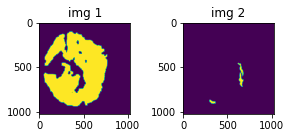

0.17597848176956177


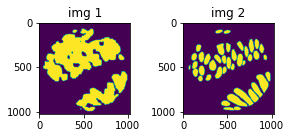

1.2600536346435547


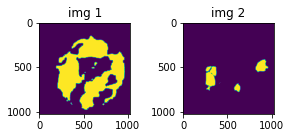

0.7378451228141785


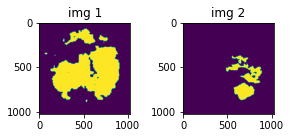

0.8516746759414673


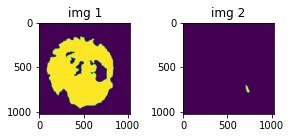

0.041456736624240875


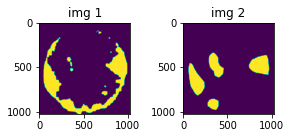

0.8294926881790161


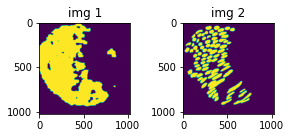

1.1462560892105103


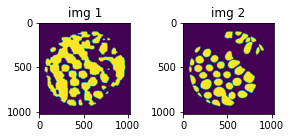

1.1146197319030762


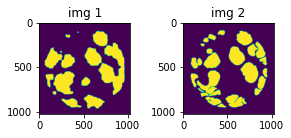

0.7623468041419983


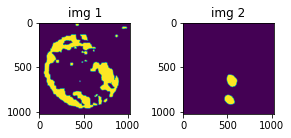

0.2905220687389374


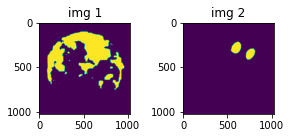

0.6782637238502502


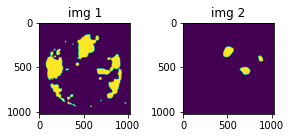

0.7837744951248169


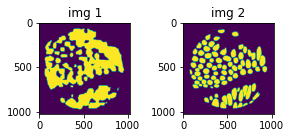

1.1721473932266235


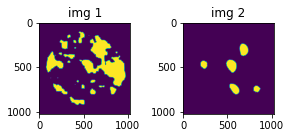

0.8486877679824829


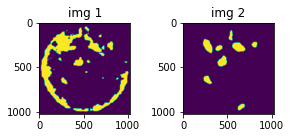

0.602242112159729


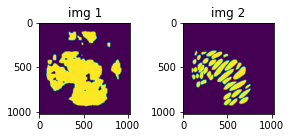

1.1708754301071167


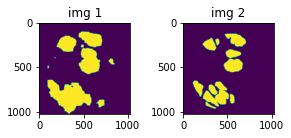

0.7866660952568054


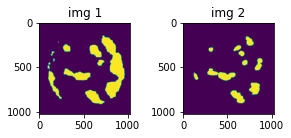

0.6311212778091431


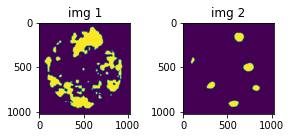

0.8195419907569885


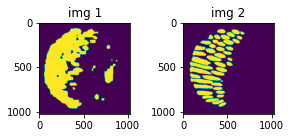

1.1731493473052979


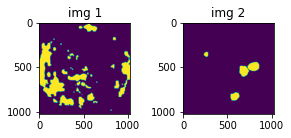

0.19851960241794586


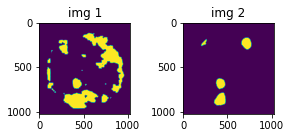

0.9749706387519836


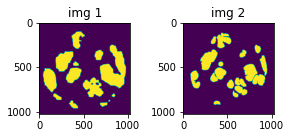

0.7697902917861938


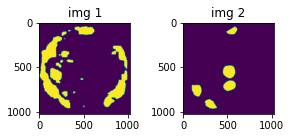

0.5462855100631714


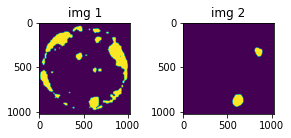

0.6973884701728821


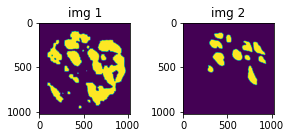

0.5093225836753845


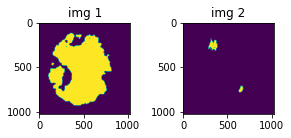

0.15785282850265503


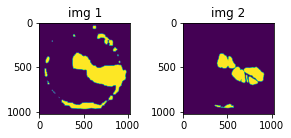

0.6699738502502441


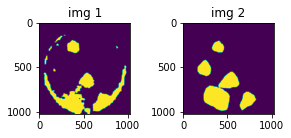

0.8398522734642029


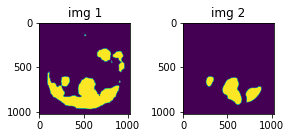

0.5515679121017456


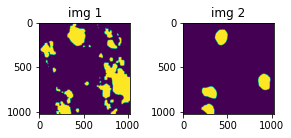

1.070957064628601


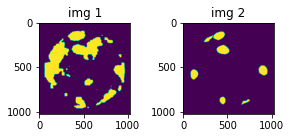

1.0454930067062378


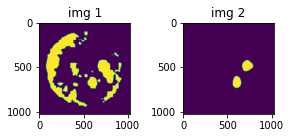

0.7355160713195801


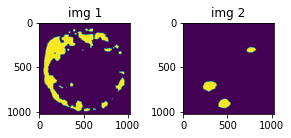

0.28523510694503784


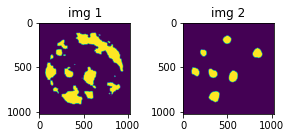

1.226527214050293


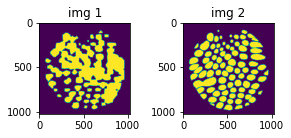

1.1576099395751953


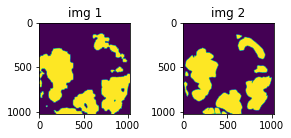

0.8650921583175659


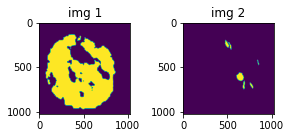

0.19835728406906128


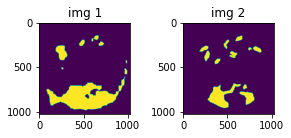

0.547700047492981


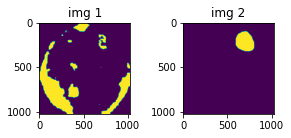

0.104014091193676


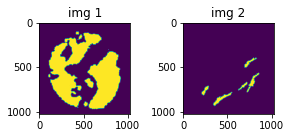

0.3917492926120758


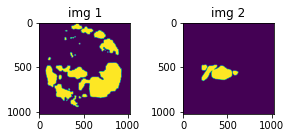

0.20532160997390747


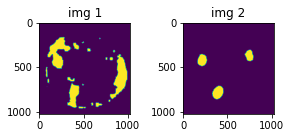

0.8087584376335144


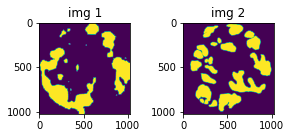

0.6208633184432983


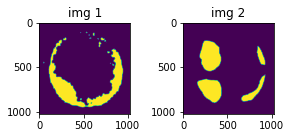

0.6582349538803101


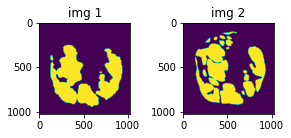

0.8050443530082703


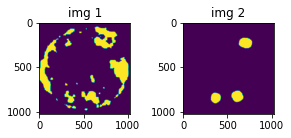

0.7657876014709473


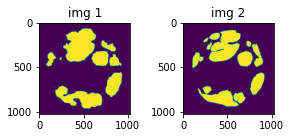

0.8551276922225952


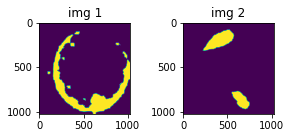

0.39906805753707886


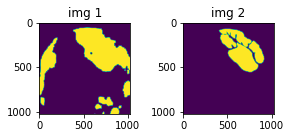

0.6475794911384583


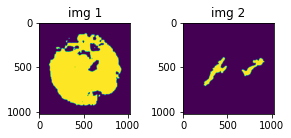

0.5089842081069946


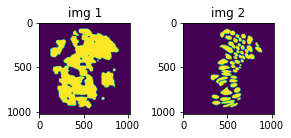

1.067426085472107


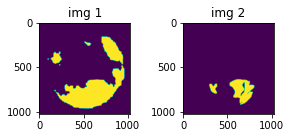

0.3954463303089142


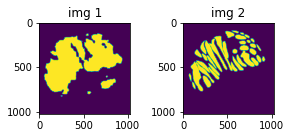

1.226151704788208


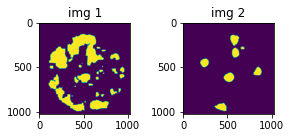

0.9564207792282104


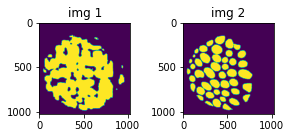

1.2847849130630493


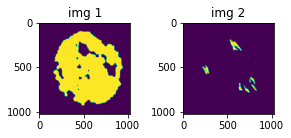

0.2624865472316742


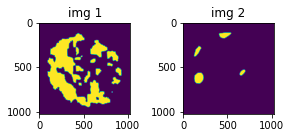

0.5290457606315613


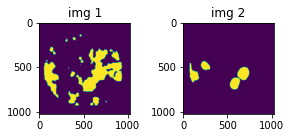

0.998816192150116


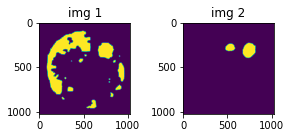

0.9019514322280884


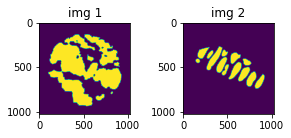

0.9439771175384521


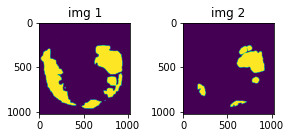

0.5573557615280151


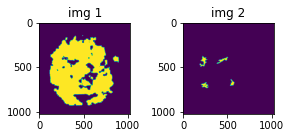

0.18681299686431885


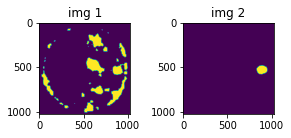

0.5477057099342346


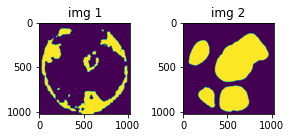

0.49458378553390503


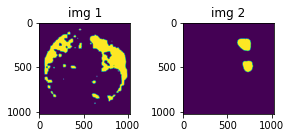

0.7652748823165894


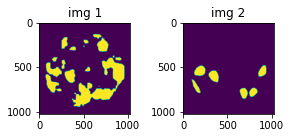

1.0778378248214722


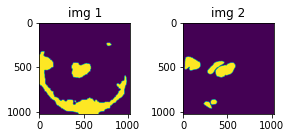

0.43256646394729614


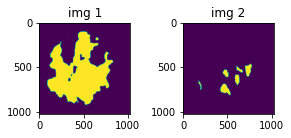

0.5260423421859741


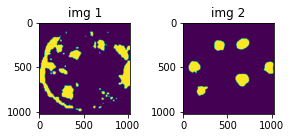

0.4157107174396515


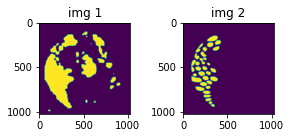

0.9729465842247009


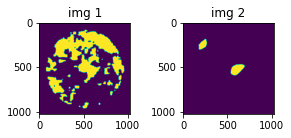

0.5377180576324463


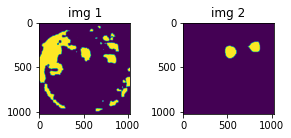

0.5474362969398499


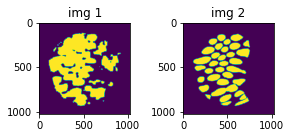

1.1996095180511475


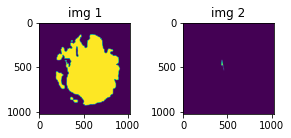

0.0175491850823164


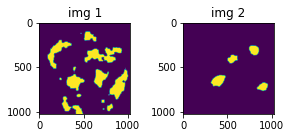

0.8738386631011963


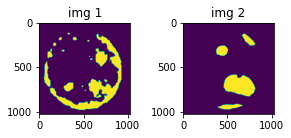

0.514936625957489


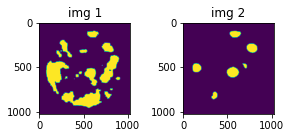

0.9073253870010376


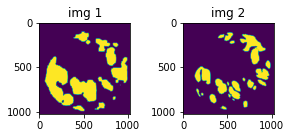

0.6722757816314697


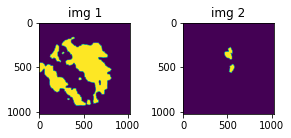

0.3087875247001648


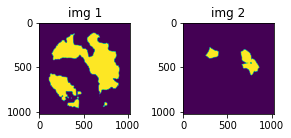

0.7815932035446167


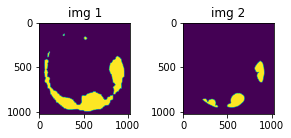

0.5029862523078918


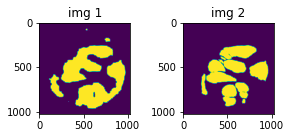

0.7852427363395691


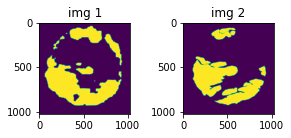

0.7241452932357788


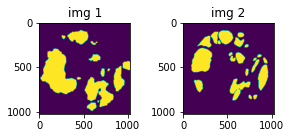

0.6101392507553101


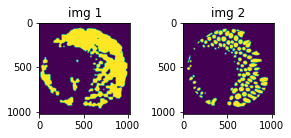

1.092006802558899


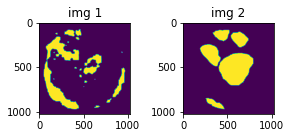

0.44570884108543396


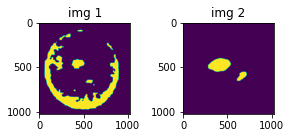

0.1873810589313507


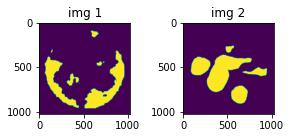

0.45726001262664795


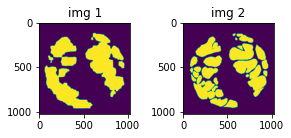

0.843734622001648


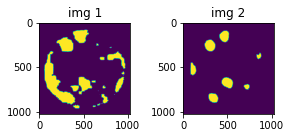

1.211095929145813


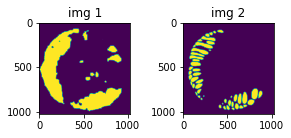

1.1751357316970825


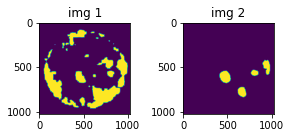

0.8764103055000305


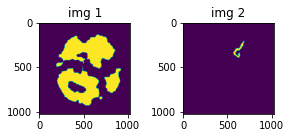

0.15738211572170258


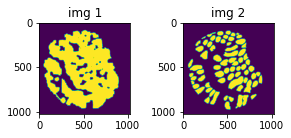

1.2384625673294067


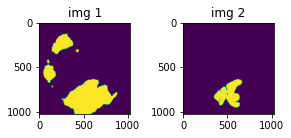

0.4513299763202667


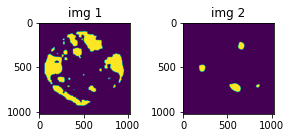

0.5247833132743835


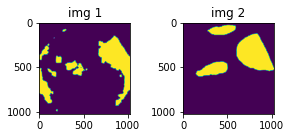

0.7392715215682983


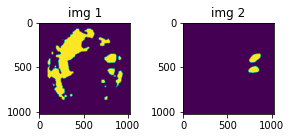

0.4786003828048706


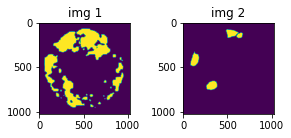

0.8274782299995422


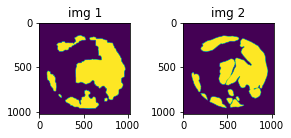

0.8885400891304016


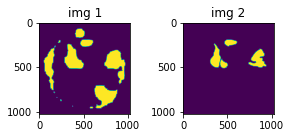

0.4944789409637451


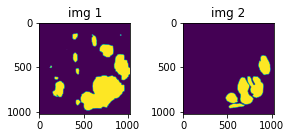

0.6730245351791382


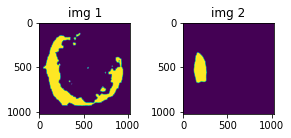

0.47187191247940063


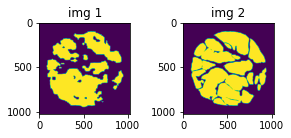

0.8066768050193787


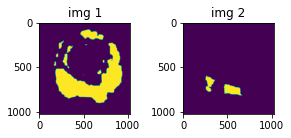

0.6712529063224792


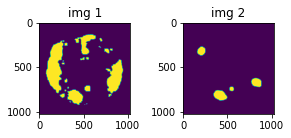

0.9753816723823547


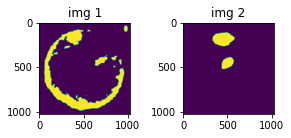

0.24478979408740997


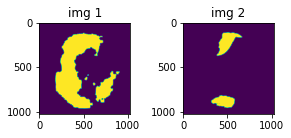

0.9129568338394165


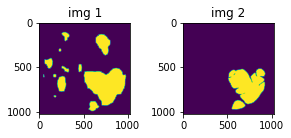

0.7242016196250916


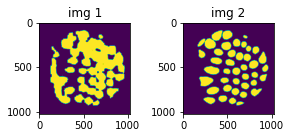

1.2416690587997437


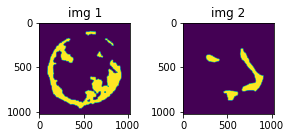

0.5609074831008911


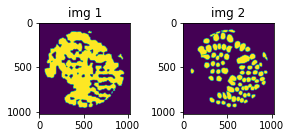

1.1873831748962402


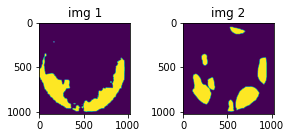

0.947969377040863


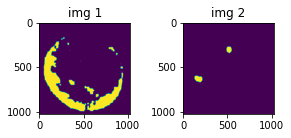

0.12988752126693726


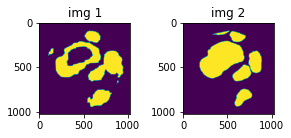

0.7780616879463196


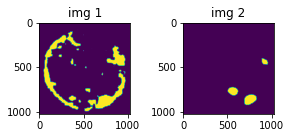

0.6880269646644592


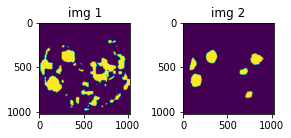

0.6639564037322998


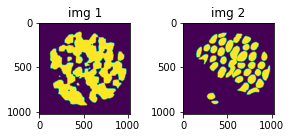

1.1856768131256104


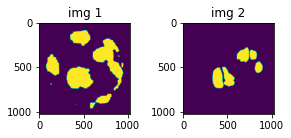

0.5482773780822754


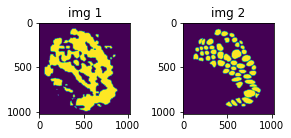

1.1167644262313843


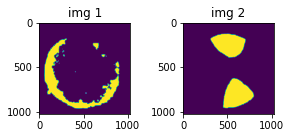

0.18891513347625732


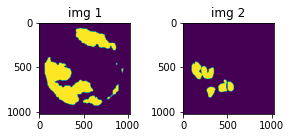

0.4255324900150299


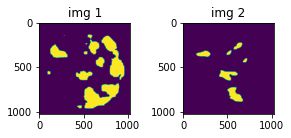

0.38502106070518494


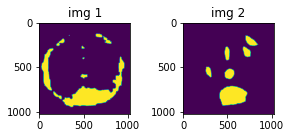

0.6884053945541382


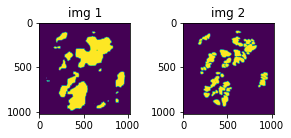

0.7342461943626404


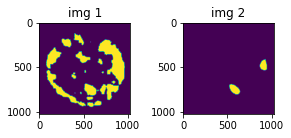

0.6274887919425964


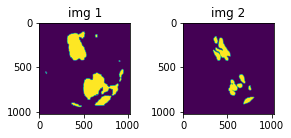

0.5906186103820801


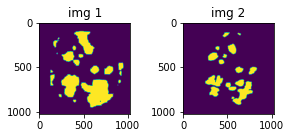

0.6949102878570557


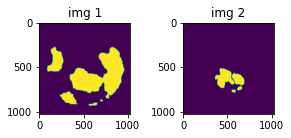

0.3459062874317169


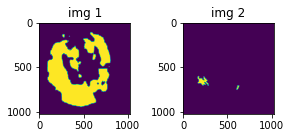

0.19498798251152039


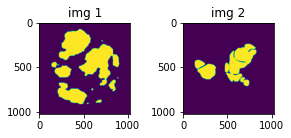

0.4835427701473236


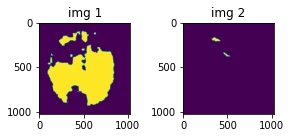

0.04553336650133133


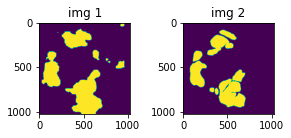

0.7682592272758484


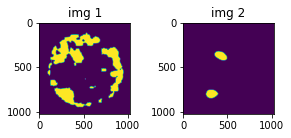

0.737706184387207


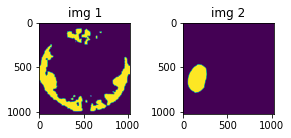

0.3734440803527832


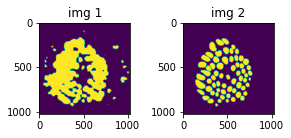

1.266467571258545


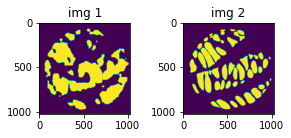

1.1195566654205322


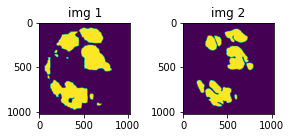

0.8089547753334045


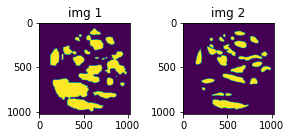

0.6389338374137878


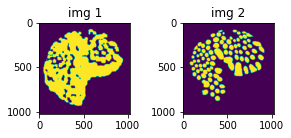

1.219991683959961


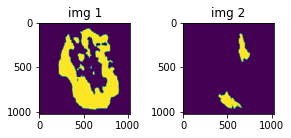

0.6698004603385925


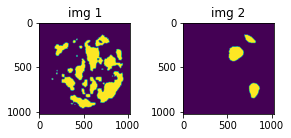

0.9281510710716248


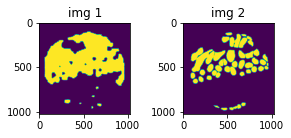

1.2364604473114014


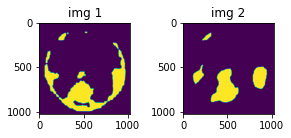

0.8470248579978943


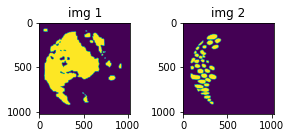

0.8951297998428345


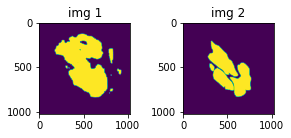

0.7004632353782654


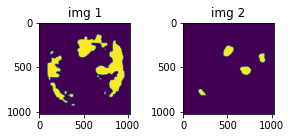

0.9548581838607788


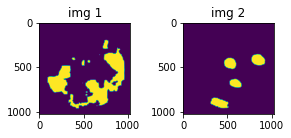

0.720818042755127


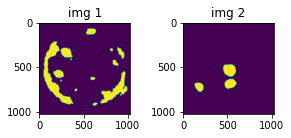

0.23734547197818756


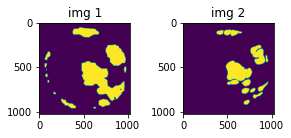

0.7713777422904968


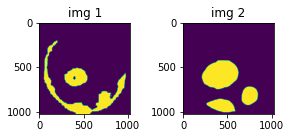

0.6637543439865112


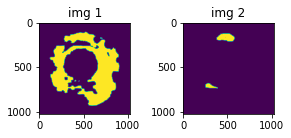

0.40367522835731506


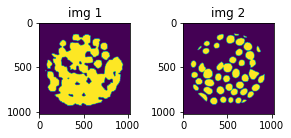

1.1602373123168945


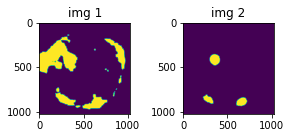

0.9269622564315796


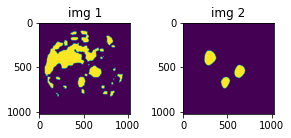

1.0053642988204956


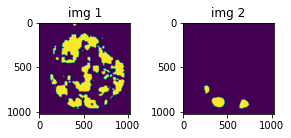

0.4588915705680847


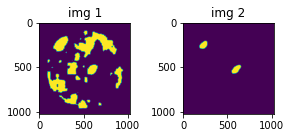

0.5722714066505432


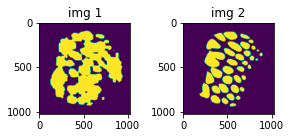

1.2033038139343262


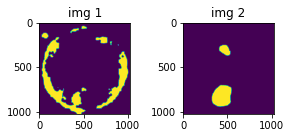

0.22589251399040222


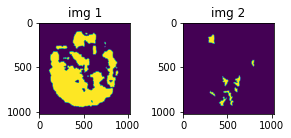

0.3181024491786957


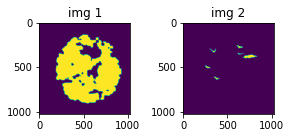

0.12262400984764099


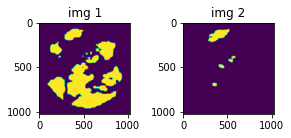

0.14328229427337646


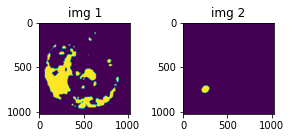

0.33062589168548584


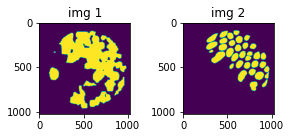

1.1822243928909302


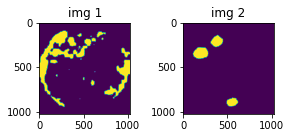

0.4504198431968689


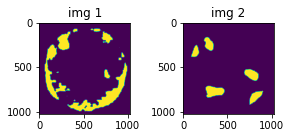

0.5300233960151672


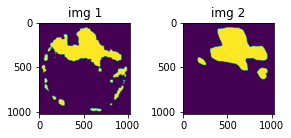

0.8995709419250488


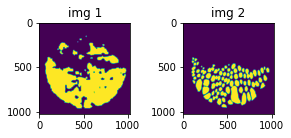

1.1702879667282104


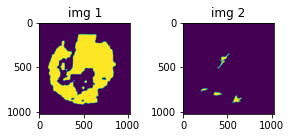

0.24652810394763947


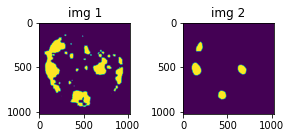

1.1206783056259155


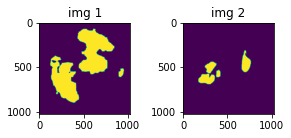

0.31616833806037903


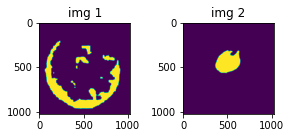

0.12024971097707748


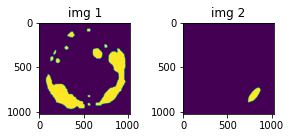

0.14339004456996918


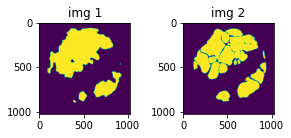

0.8632411360740662


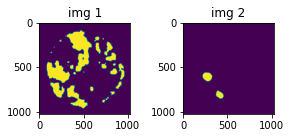

0.5313193798065186
FOLD: 0, EPOCH: 1, valid_loss: 0.6693923867900263 , Val Dice COE : 0.6889143511547114
Saved model for best score : FOLD0_best_score.pth
Saved model for best loss : FOLD0_best_loss.pth


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 2, train_loss: 0.5858609488180705 , Dice coe : 0.5479697009027366 
0.06536874175071716
0.8174998164176941
0.2730952501296997
0.43401363492012024
0.015589776448905468
0.4131123423576355
0.8239754438400269
0.7999837398529053
0.41777878999710083
0.18942563235759735
0.18046550452709198
0.19032901525497437
0.9413322806358337
0.33478525280952454
0.21913406252861023
0.6301097869873047
0.2674761116504669
0.17184844613075256
0.2975561320781708
0.7656429409980774
0.2539345622062683
0.308522492647171
0.2869533896446228
0.4290662705898285
0.18010900914669037
0.1574632227420807
0.07545807212591171
0.16458509862422943
0.46904879808425903
0.13230523467063904
0.5063201189041138
0.40444496273994446
0.194467693567276
0.2728368639945984
0.44255876541137695
1.088903546333313
0.5422306060791016
0.08669669926166534
0.19336140155792236
0.13819588720798492
0.17547544836997986
0.08402513712644577
0.2850947380065918
0.43143004179000854
0.5140752196311951
0.4403225779533386
0.3610042333602905
0.3

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 3, train_loss: 0.6080997226067951 , Dice coe : 0.4420872623176183 
0.06507189571857452
0.7985368371009827
0.27133995294570923
0.43435391783714294
0.015625517815351486
0.3605765104293823
0.7405818700790405
0.7967610955238342
0.4048980474472046
0.184675931930542
0.18005751073360443
0.17917674779891968
0.8885404467582703
0.32875683903694153
0.1774149090051651
0.6204016804695129
0.2443818598985672
0.13143499195575714
0.2839715778827667
0.7403237819671631
0.25107014179229736
0.3002907335758209
0.2791295349597931
0.4244953691959381
0.1726122945547104
0.1574803739786148
0.07558613270521164
0.13802467286586761
0.4397270679473877
0.12346068024635315
0.49361762404441833
0.36185595393180847
0.1875159740447998
0.23869091272354126
0.4176407754421234
1.0224759578704834
0.4696377217769623
0.08641337603330612
0.14699101448059082
0.13209810853004456
0.17274288833141327
0.08336018770933151
0.2801583409309387
0.4245019853115082
0.43228879570961
0.43140357732772827
0.306913286447525
0.3678

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 4, train_loss: 0.6318218725068229 , Dice coe : 0.455210699178207 
2.793686326185707e-05
0.00017370606656186283
5.979359229968395e-06
3.4411325486871647e-06
0.00012130034156143665
0.0005076142260804772
0.0009561626357026398
2.7438090910436586e-05
0.00025952240685001016
9.401500392414164e-06
9.65791696216911e-06
9.695935659692623e-06
0.00020910752937197685
4.869948043051409e-06
9.805556146602612e-06
2.1227140223345486e-06
0.0004198268288746476
0.00025813112733885646
5.7748056860873476e-06
2.1160611140658148e-05
6.649201623076806e-06
5.400938789534848e-06
5.885642167413607e-06
3.5429332001513103e-06
1.0127915629709605e-05
1.1157974768138956e-05
2.432143264741171e-05
0.000604649365413934
3.3900143989740172e-06
1.4541647033183835e-05
0.00011966924648731947
4.340711257100338e-06
9.236680853064172e-06
7.044882750051329e-06
3.6283811368775787e-06
9.123288577939093e-07
9.648844570619985e-05
2.1063273379695602e-05
1.202009752887534e-05
1.3498191037797369e-05
1.0112552445207257e-0

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 5, train_loss: 0.601954169699124 , Dice coe : 0.43155757376776427 
0.06492230296134949
0.7983986139297485
0.270862877368927
0.4340888559818268
0.015590543858706951
0.36065128445625305
0.7401480078697205
0.7955742478370667
0.40453970432281494
0.18423208594322205
0.1797616183757782
0.17910562455654144
0.8878508806228638
0.32758066058158875
0.17734842002391815
0.6200467944145203
0.24338401854038239
0.13120032846927643
0.2835189402103424
0.7391062378883362
0.2512648105621338
0.30018141865730286
0.2789102792739868
0.42423534393310547
0.1721302568912506
0.15747539699077606
0.07546742260456085
0.1379951387643814
0.4391758143901825
0.12309396266937256
0.4927564561367035
0.3602384626865387
0.18720337748527527
0.23848114907741547
0.416336327791214
1.0223896503448486
0.4684383273124695
0.08620773255825043
0.14702339470386505
0.13198228180408478
0.17234988510608673
0.08324122428894043
0.2794911563396454
0.42388710379600525
0.43794167041778564
0.4300028681755066
0.30645790696144104


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 6, train_loss: 0.6260837413583483 , Dice coe : 0.45191451840971697 


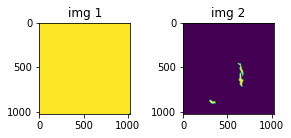

0.06491744518280029


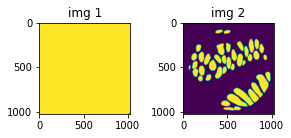

0.7984365820884705


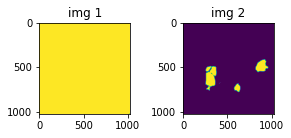

0.27083808183670044


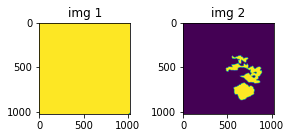

0.4340437948703766


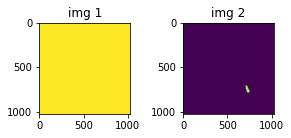

0.015588773414492607


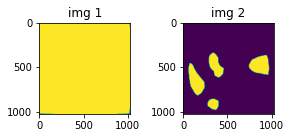

0.3610999584197998


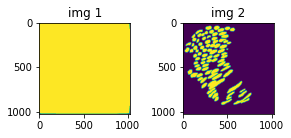

0.7421656250953674


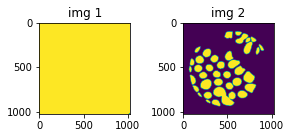

0.795534074306488


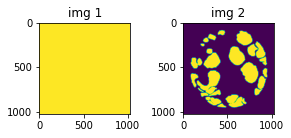

0.40449047088623047


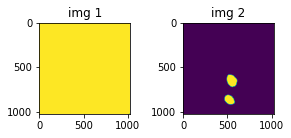

0.1842004954814911


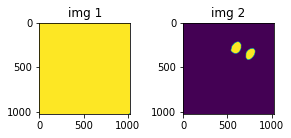

0.17975255846977234


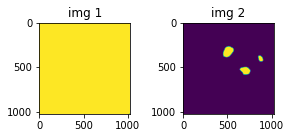

0.17908494174480438


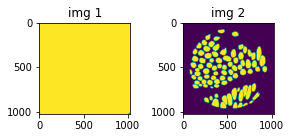

0.8879238963127136


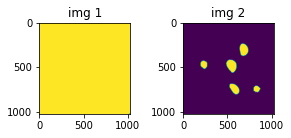

0.32753753662109375


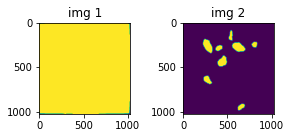

0.17810966074466705


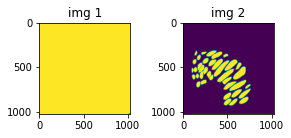

0.6199553608894348


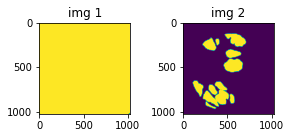

0.24334344267845154


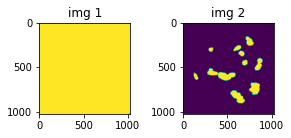

0.1311846673488617


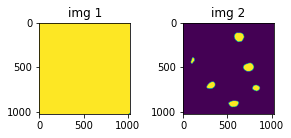

0.2834961712360382


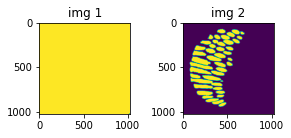

0.7389163970947266


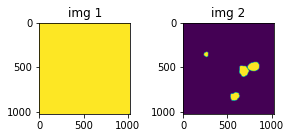

0.25087770819664


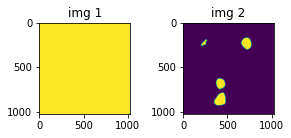

0.3001663386821747


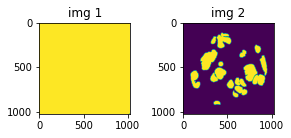

0.27889585494995117


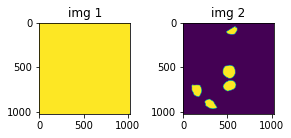

0.42418432235717773


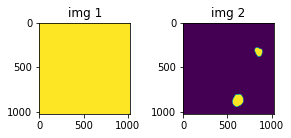

0.17210130393505096


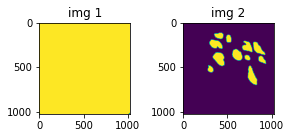

0.1574639081954956


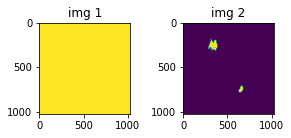

0.07545550912618637


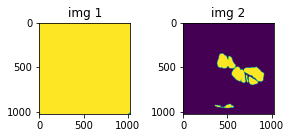

0.13802075386047363


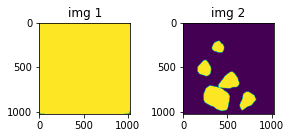

0.43945616483688354


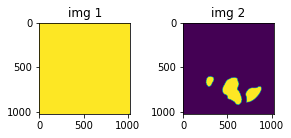

0.12307390570640564


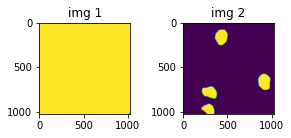

0.4926129877567291


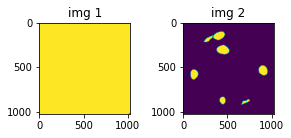

0.3601956367492676


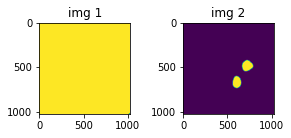

0.1871854066848755


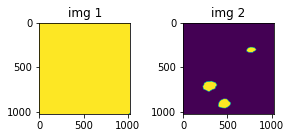

0.238459512591362


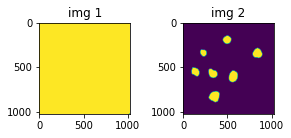

0.4162910580635071


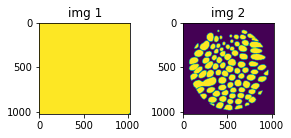

1.0222303867340088


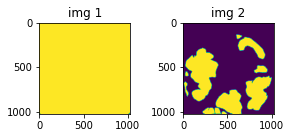

0.4684499502182007


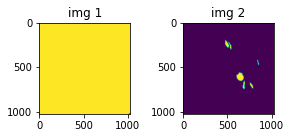

0.08616650104522705


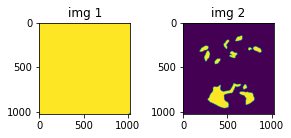

0.14691488444805145


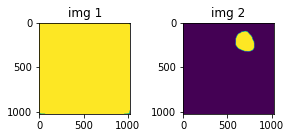

0.1321069449186325


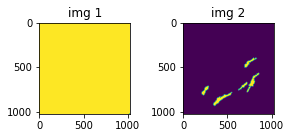

0.1723335087299347


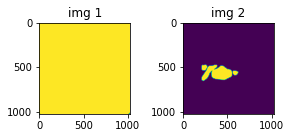

0.08323970437049866


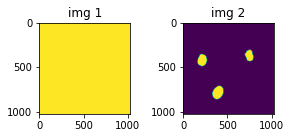

0.2794540226459503


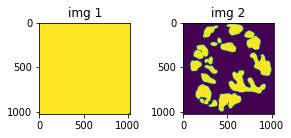

0.42395085096359253


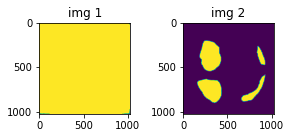

0.432714581489563


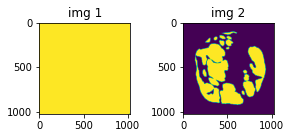

0.42994940280914307


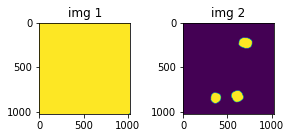

0.3064286708831787


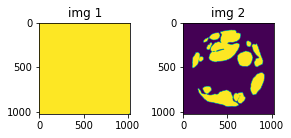

0.3670382797718048


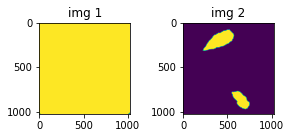

0.22460076212882996


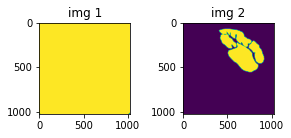

0.22721408307552338


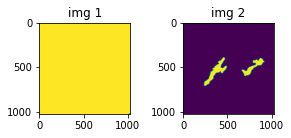

0.24376153945922852


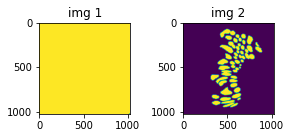

0.604219377040863


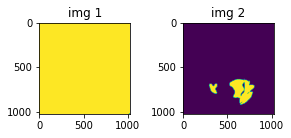

0.09837958216667175


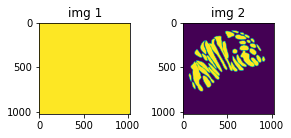

0.7333202362060547


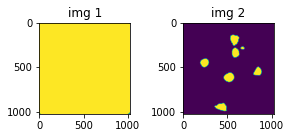

0.37098050117492676


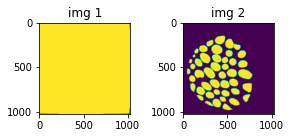

0.8771229982376099


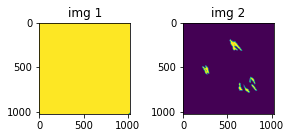

0.12031151354312897


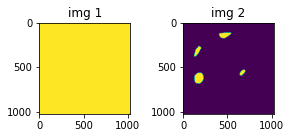

0.20303158462047577


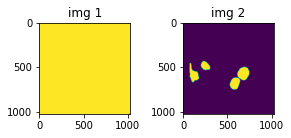

0.36530017852783203


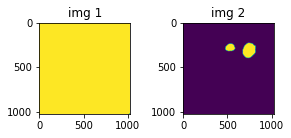

0.22256645560264587


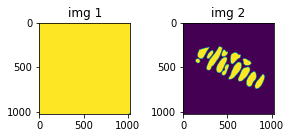

0.48849979043006897


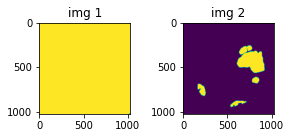

0.1455971598625183


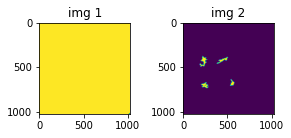

0.08170212805271149


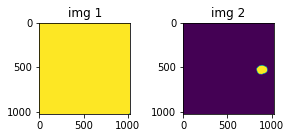

0.08591562509536743


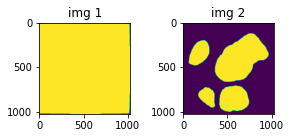

0.817429780960083


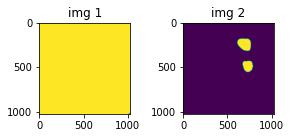

0.23941399157047272


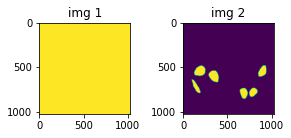

0.3960590660572052


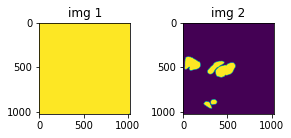

0.11441054940223694


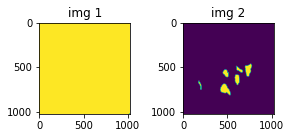

0.1916448175907135


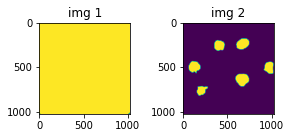

0.528672993183136


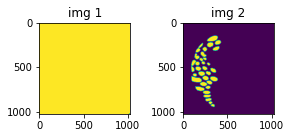

0.36226820945739746


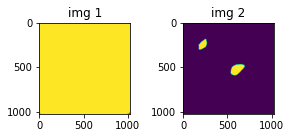

0.17879325151443481


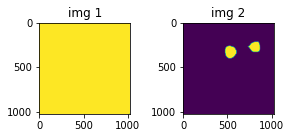

0.21720105409622192


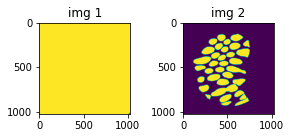

0.80132657289505


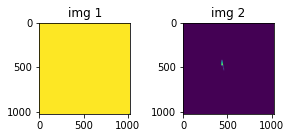

0.005881726276129484


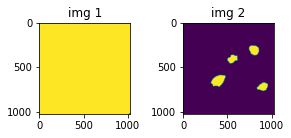

0.31634247303009033


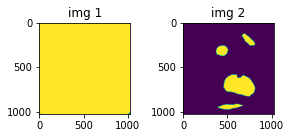

0.3090772330760956


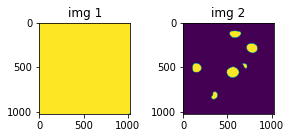

0.34544846415519714


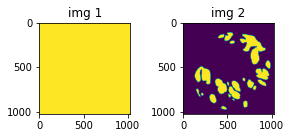

0.2530817985534668


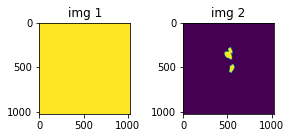

0.08122461289167404


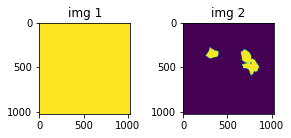

0.2753639817237854


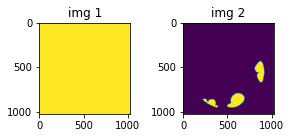

0.08247925341129303


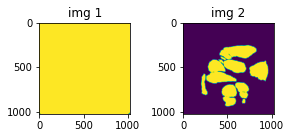

0.3557557761669159


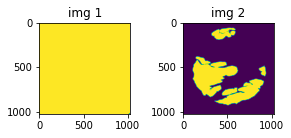

0.36081448197364807


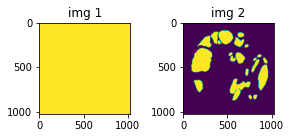

0.307011216878891


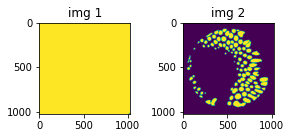

0.6800535321235657


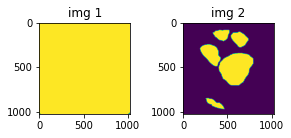

0.5314582586288452


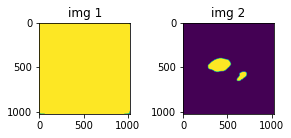

0.12681129574775696


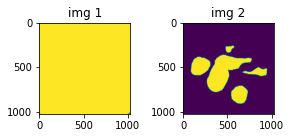

0.5169941186904907


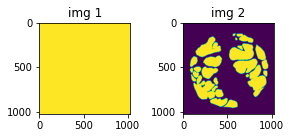

0.4653778374195099


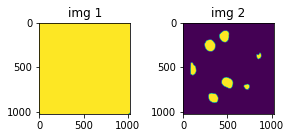

0.422370970249176


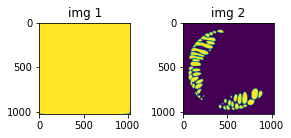

0.4893888533115387


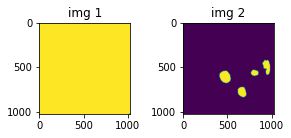

0.2904593050479889


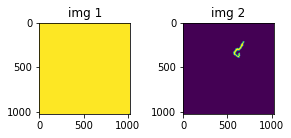

0.043480247259140015


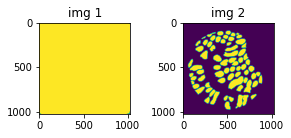

0.8507821559906006


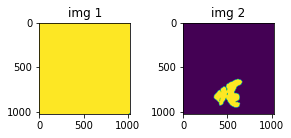

0.10059269517660141


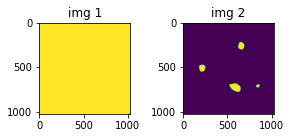

0.16570235788822174


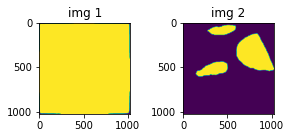

0.5190538167953491


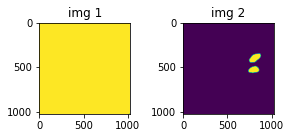

0.13876736164093018


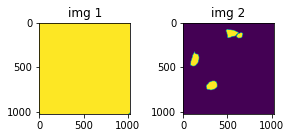

0.2585721015930176


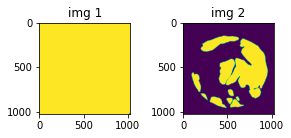

0.42365628480911255


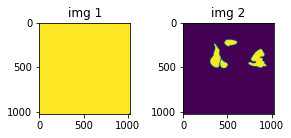

0.09871887415647507


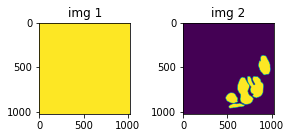

0.17707911133766174


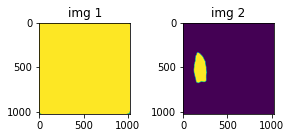

0.1336941421031952


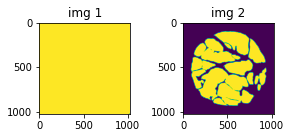

0.6008599400520325


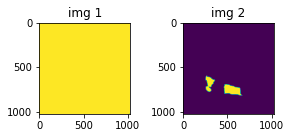

0.18843992054462433


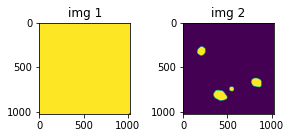

0.2620052695274353


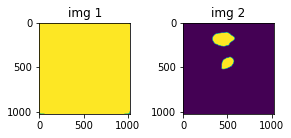

0.14834162592887878


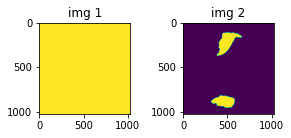

0.37524688243865967


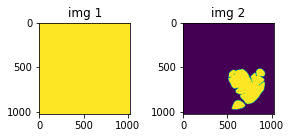

0.20874285697937012


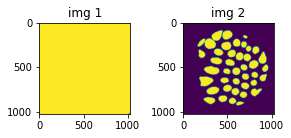

0.8376561403274536


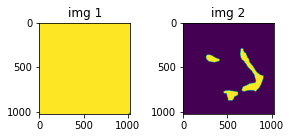

0.20156264305114746


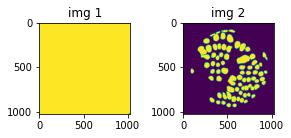

0.7592422366142273


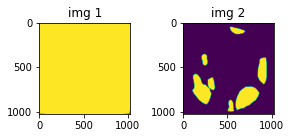

0.4273938834667206


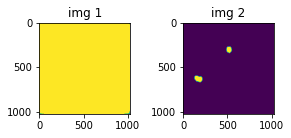

0.031839750707149506


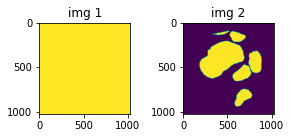

0.36214321851730347


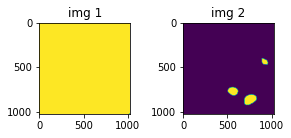

0.20569364726543427


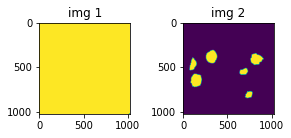

0.43822306394577026


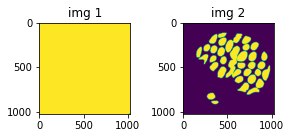

0.818487286567688


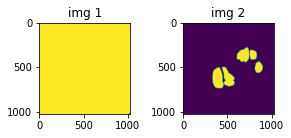

0.13246537744998932


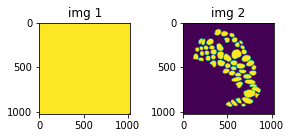

0.6781027317047119


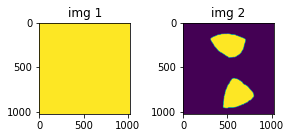

0.4496318995952606


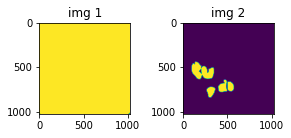

0.09964188933372498


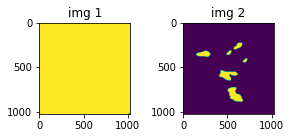

0.08208499103784561


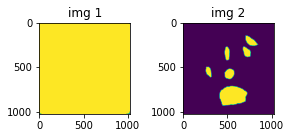

0.29850056767463684


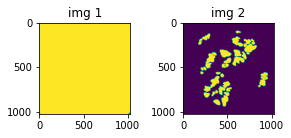

0.22534914314746857


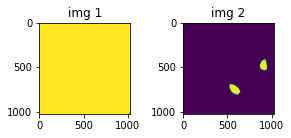

0.1472417563199997


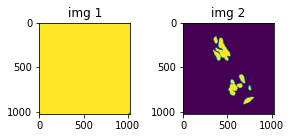

0.09403969347476959


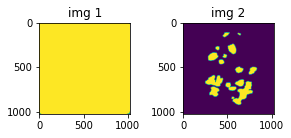

0.1701897829771042


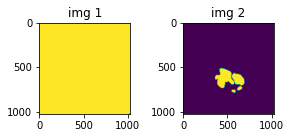

0.08248014003038406


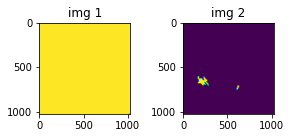

0.05502278357744217


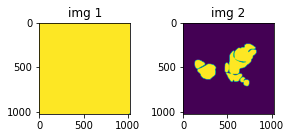

0.2067541480064392


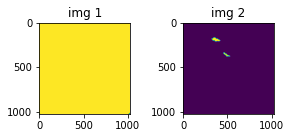

0.028486939147114754


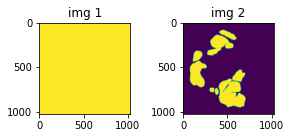

0.2983079254627228


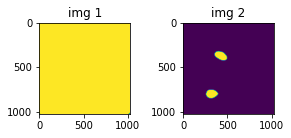

0.1754496991634369


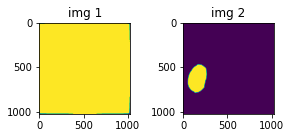

0.17909236252307892


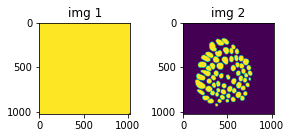

0.7241623401641846


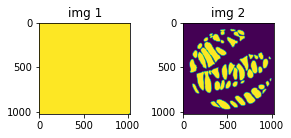

0.8696598410606384


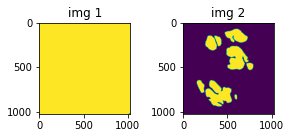

0.2657311260700226


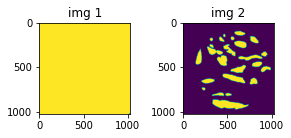

0.24278689920902252


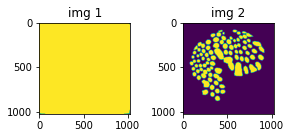

0.7729539275169373


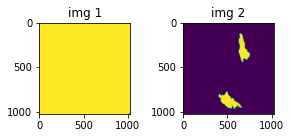

0.2860359847545624


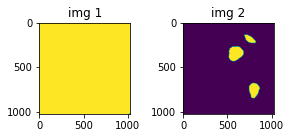

0.34325170516967773


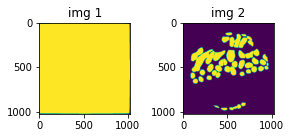

0.7395063638687134


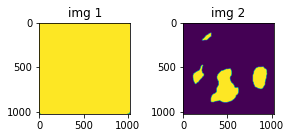

0.37293490767478943


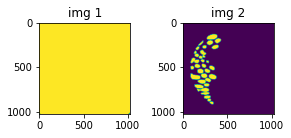

0.3672062158584595


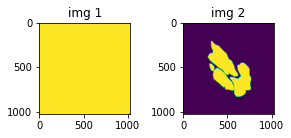

0.2514369785785675


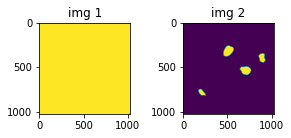

0.2354021817445755


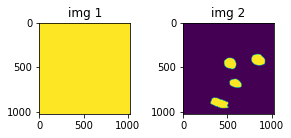

0.4151148796081543


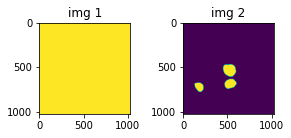

0.2867475748062134


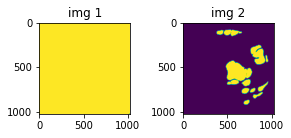

0.1929883360862732


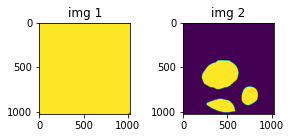

0.48087021708488464


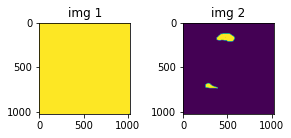

0.12994588911533356


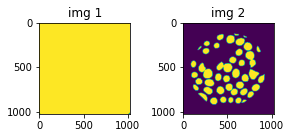

0.7619751691818237


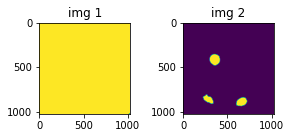

0.2321760654449463


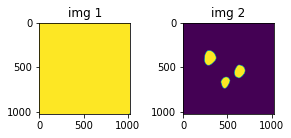

0.30840450525283813


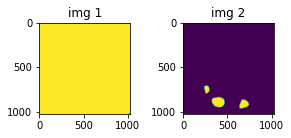

0.21203114092350006


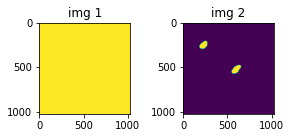

0.11110250651836395


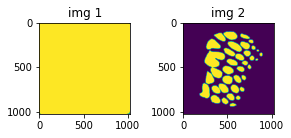

0.792716920375824


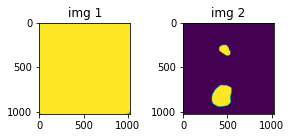

0.18771319091320038


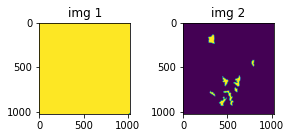

0.17225728929042816


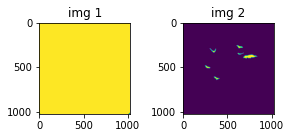

0.057629525661468506


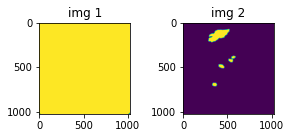

0.04853497073054314


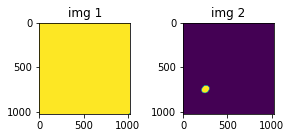

0.0530645027756691


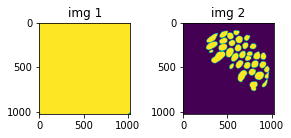

0.650545060634613


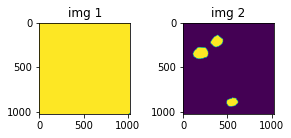

0.31661203503608704


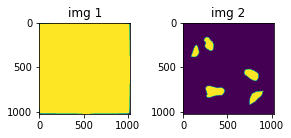

0.2232397198677063


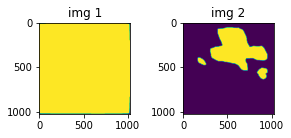

0.5287860631942749


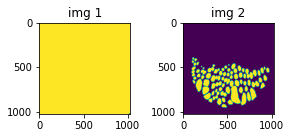

0.6988732218742371


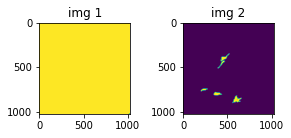

0.08383067697286606


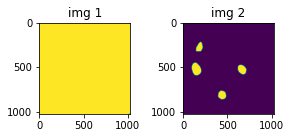

0.26483896374702454


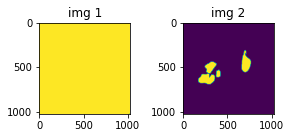

0.08539978414773941


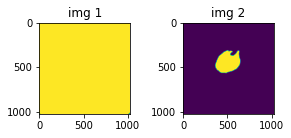

0.1825571209192276


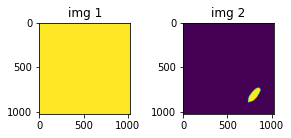

0.022868936881422997


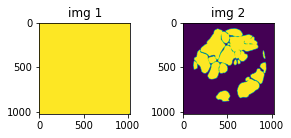

0.447098046541214


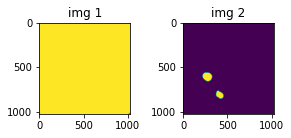

0.12069589644670486
FOLD: 0, EPOCH: 6, valid_loss: 0.8017260335724462 , Val Dice COE : 0.32454365348729136


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 7, train_loss: 0.6274187903744833 , Dice coe : 0.46855633510937356 
0.06502185761928558
0.8339664936065674
0.27088990807533264
0.4417033791542053
0.015599978156387806
0.43135061860084534
0.8380378484725952
0.7996174097061157
0.40502050518989563
0.18435470759868622
0.18042415380477905
0.17917923629283905
0.9452434778213501
0.32974329590797424
0.21581390500068665
0.6377812027931213
0.2495802491903305
0.13379284739494324
0.28579196333885193
0.7503175735473633
0.2509216368198395
0.3015241324901581
0.28081557154655457
0.4243428111076355
0.17223748564720154
0.15872398018836975
0.07546845823526382
0.1475188434123993
0.5102908611297607
0.12337759882211685
0.5200707316398621
0.38594019412994385
0.1885923594236374
0.2403380423784256
0.4187038838863373
1.0638070106506348
0.4860595166683197
0.08726547658443451
0.1635504961013794
0.1539437621831894
0.17345057427883148
0.08666077256202698
0.28000929951667786
0.45428764820098877
0.5035295486450195
0.4317162334918976
0.3094589412212372

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 8, train_loss: 0.6035391242163521 , Dice coe : 0.5313664039184953 
0.10170518606901169
0.9492084980010986
0.44711267948150635
0.5776861310005188
0.023087110370397568
0.465084433555603
0.9205935597419739
0.9677073359489441
0.5054714679718018
0.24504147469997406
0.24313953518867493
0.24033530056476593
1.057210087776184
0.4417338967323303
0.22686216235160828
0.8162895441055298
0.3326970636844635
0.18671779334545135
0.3831700384616852
0.921297013759613
0.2914670705795288
0.39826080203056335
0.36283618211746216
0.5077324509620667
0.21575437486171722
0.21001338958740234
0.09822104126214981
0.19183005392551422
0.5580379366874695
0.1671033650636673
0.5531899333000183
0.48284006118774414
0.25396856665611267
0.3080441653728485
0.5495949983596802
1.1774078607559204
0.5399112701416016
0.13625656068325043
0.19883351027965546
0.16043205559253693
0.23737980425357819
0.11690022051334381
0.3592815399169922
0.5023630857467651
0.6074746251106262
0.5736432671546936
0.3861784338951111
0.485

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 9, train_loss: 0.5946365157834121 , Dice coe : 0.5529305098206052 
0.06591690331697464
0.8532297611236572
0.27257418632507324
0.4436495900154114
0.015677612274885178
0.44089382886886597
0.8936018943786621
0.8066172003746033
0.40819600224494934
0.18621546030044556
0.18289582431316376
0.1813088357448578
0.9591102004051208
0.3330521881580353
0.21990813314914703
0.6370677351951599
0.25129449367523193
0.13599276542663574
0.29061567783355713
0.7514427900314331
0.2521442174911499
0.3055711090564728
0.28319814801216125
0.42670726776123047
0.1744273453950882
0.16130678355693817
0.07572906464338303
0.16165852546691895
0.5142556428909302
0.12486366927623749
0.5121657848358154
0.3792280852794647
0.19205066561698914
0.24427250027656555
0.4235028028488159
1.0512683391571045
0.5134277939796448
0.08835429698228836
0.16360458731651306
0.1540619283914566
0.17433762550354004
0.08679161965847015
0.28223636746406555
0.4594934284687042
0.5699800848960876
0.43473029136657715
0.314310193061828

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 10, train_loss: 0.6057749280759267 , Dice coe : 0.552554319643159 
0.10064958035945892
0.894256055355072
0.37907564640045166
0.509742796421051
0.01813478022813797
0.43720731139183044
0.9201173186302185
0.8761879801750183
0.4383147358894348
0.2061411738395691
0.20683954656124115
0.19951550662517548
0.9993939399719238
0.3713895380496979
0.21436461806297302
0.745657205581665
0.28675299882888794
0.15446652472019196
0.3252063989639282
0.8185614943504333
0.2620999813079834
0.3380950391292572
0.30910632014274597
0.44830238819122314
0.18646429479122162
0.1827288269996643
0.0823025107383728
0.1724826544523239
0.5179344415664673
0.13679133355617523
0.5194088220596313
0.4196080267429352
0.21794046461582184
0.26687106490135193
0.4664354622364044
1.102630615234375
0.5148146748542786
0.1256379932165146
0.17248545587062836
0.1510501652956009
0.19953195750713348
0.10110428184270859
0.3056461811065674
0.4719509780406952
0.5713108777999878
0.4853840470314026
0.33530324697494507
0.4193222

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 11, train_loss: 0.5875886838350978 , Dice coe : 0.5247580148696248 


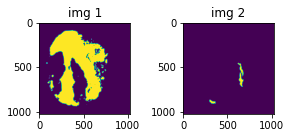

0.1500755101442337


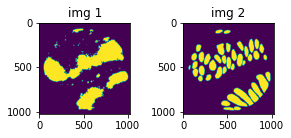

0.867316722869873


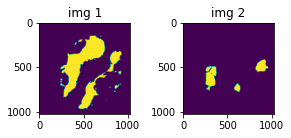

0.4108496308326721


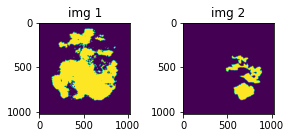

0.8203858137130737


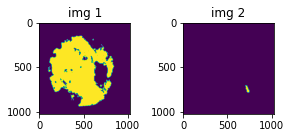

0.021429462358355522


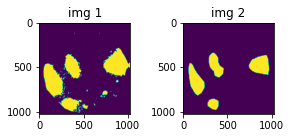

1.1224899291992188


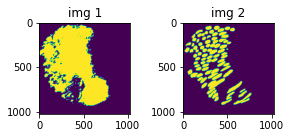

1.0594671964645386


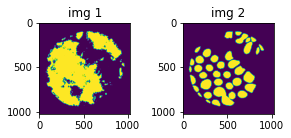

0.8359535336494446


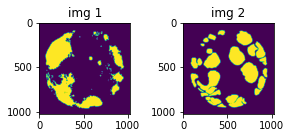

0.49713653326034546


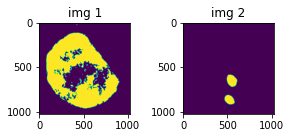

0.3787764012813568


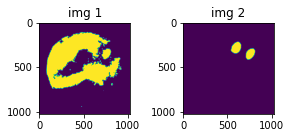

0.48243770003318787


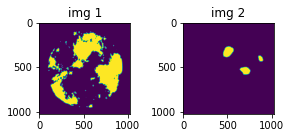

0.6556569337844849


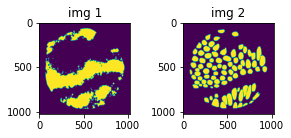

0.7997092008590698


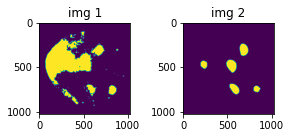

0.9040672183036804


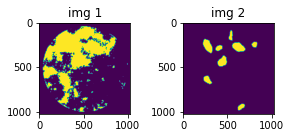

0.5203303098678589


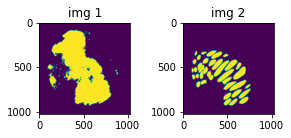

0.9444712996482849


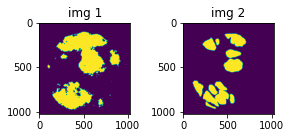

0.6578797698020935


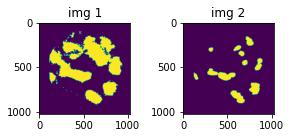

0.4852812886238098


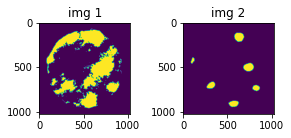

0.8897770047187805


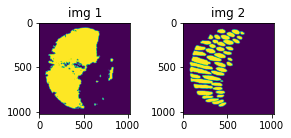

1.1739368438720703


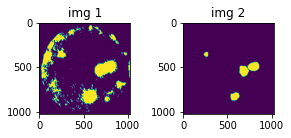

1.071106195449829


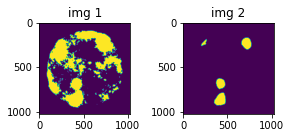

0.8903254270553589


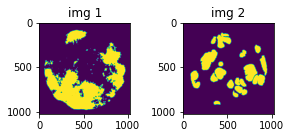

0.3736901581287384


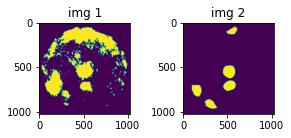

0.8930000066757202


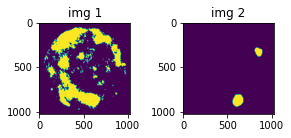

0.5602962970733643


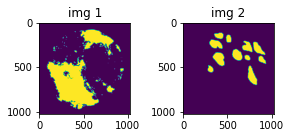

0.06599871814250946


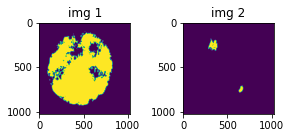

0.17482252418994904


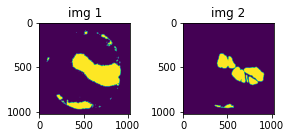

0.7175185084342957


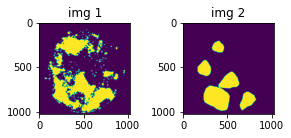

0.6761316657066345


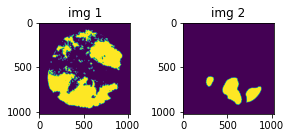

0.32018157839775085


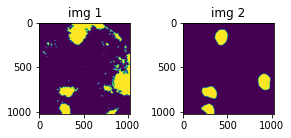

1.2768629789352417


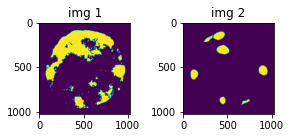

1.0678701400756836


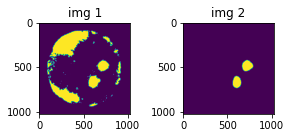

0.8338260650634766


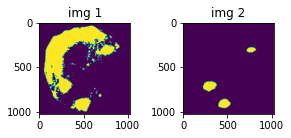

0.7161539793014526


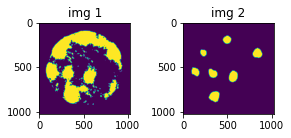

1.0681596994400024


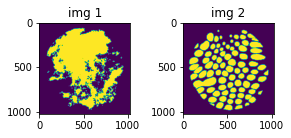

0.699052095413208


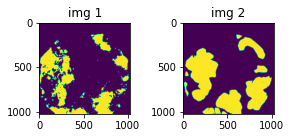

0.45229655504226685


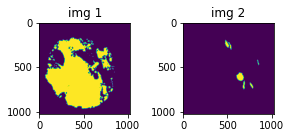

0.10070623457431793


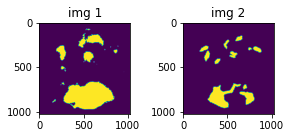

0.5816403031349182


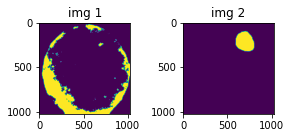

0.019162222743034363


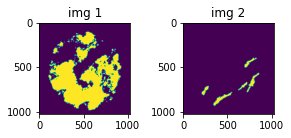

0.32613247632980347


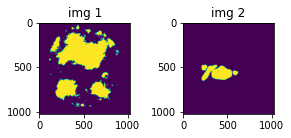

0.0007034047157503664


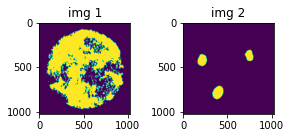

0.5925949811935425


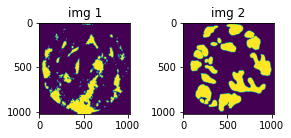

0.2735481262207031


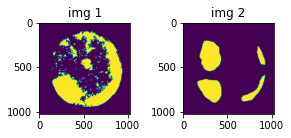

0.6797443628311157


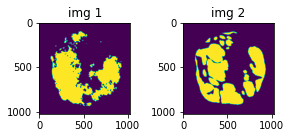

0.6749544143676758


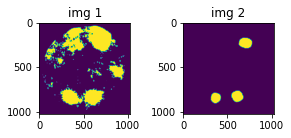

0.9840819835662842


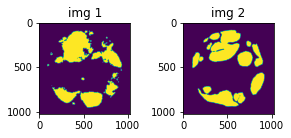

0.6991590857505798


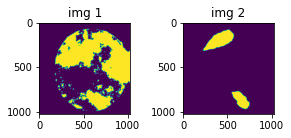

0.46299242973327637


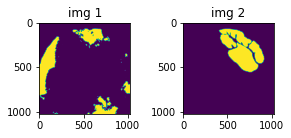

0.1851208508014679


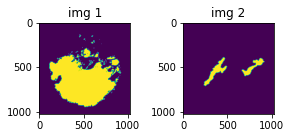

0.56717449426651


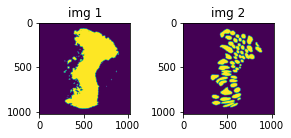

1.0956801176071167


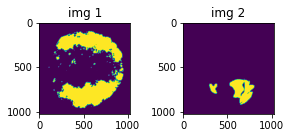

0.30360427498817444


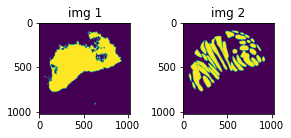

1.0467016696929932


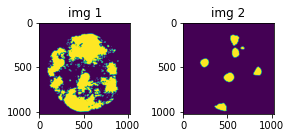

0.8671362996101379


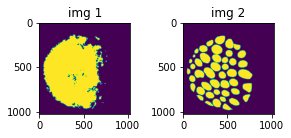

1.1177562475204468


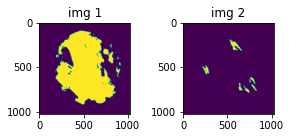

0.31724417209625244


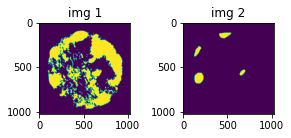

0.5859891176223755


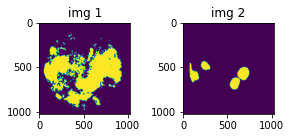

0.88276207447052


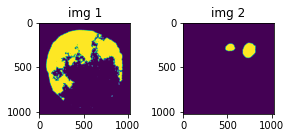

0.6689401865005493


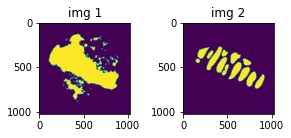

1.0160764455795288


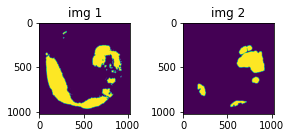

0.4573313593864441


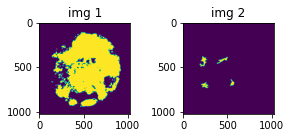

0.12395637482404709


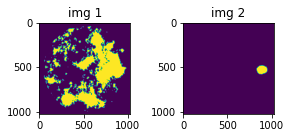

0.32015687227249146


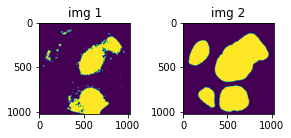

0.7315441370010376


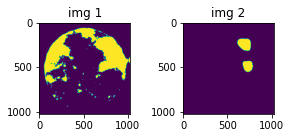

0.7363969087600708


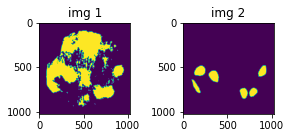

0.9807338714599609


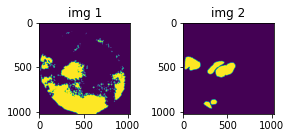

0.2928883135318756


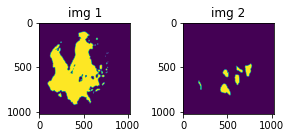

0.43363839387893677


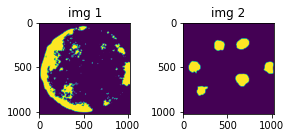

0.3842397630214691


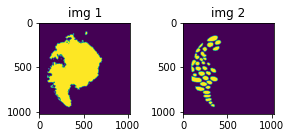

0.7159774303436279


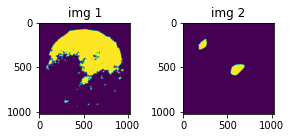

0.5507897138595581


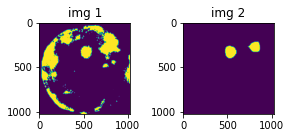

0.8081350326538086


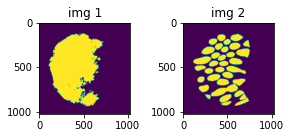

1.039843201637268


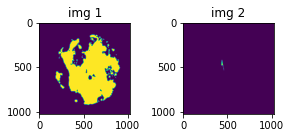

0.0028942201752215624


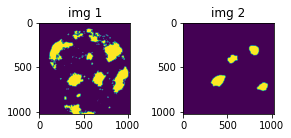

0.9567854404449463


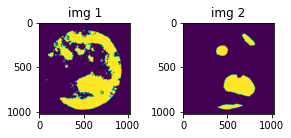

0.7280710339546204


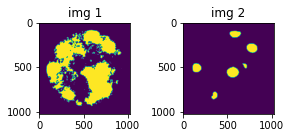

0.8536580801010132


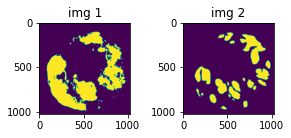

0.46241214871406555


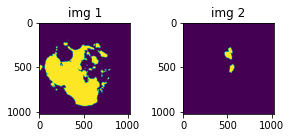

0.12630833685398102


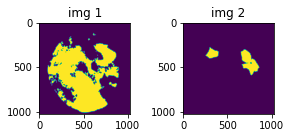

0.47308415174484253


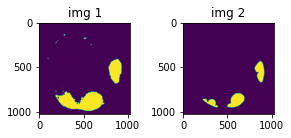

0.6164029240608215


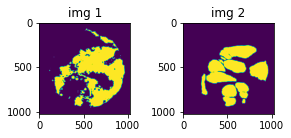

0.6220534443855286


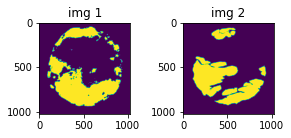

0.7084013819694519


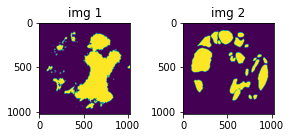

0.3446846902370453


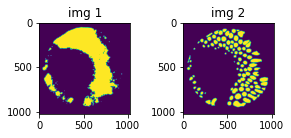

0.9365289807319641


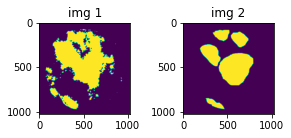

1.0440154075622559


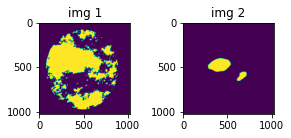

0.36031508445739746


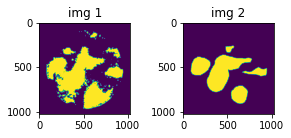

1.0383448600769043


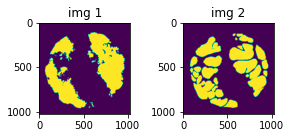

0.7248910665512085


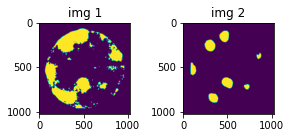

1.2005093097686768


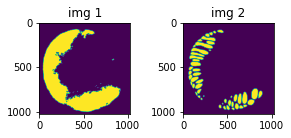

1.1083060503005981


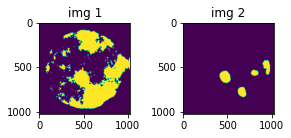

0.7749966382980347


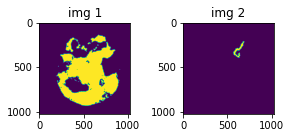

0.08951428532600403


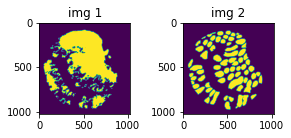

0.9467914700508118


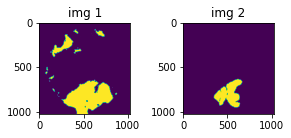

0.5120091438293457


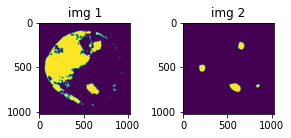

0.5547118186950684


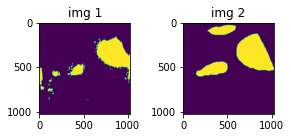

0.8058375120162964


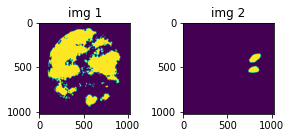

0.4212873578071594


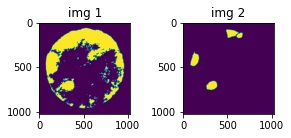

0.8107103705406189


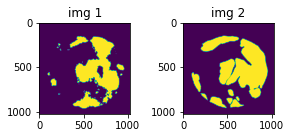

0.6891316175460815


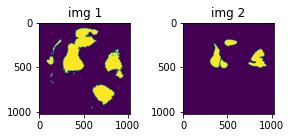

0.4762464761734009


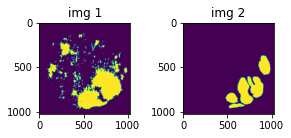

0.5316678881645203


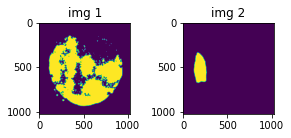

0.3326335847377777


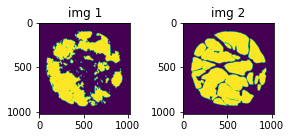

0.7019979953765869


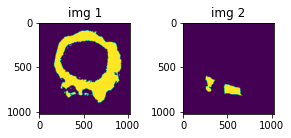

0.41724202036857605


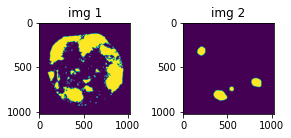

0.8376984596252441


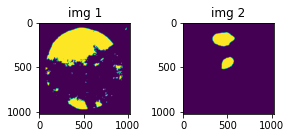

0.42809659242630005


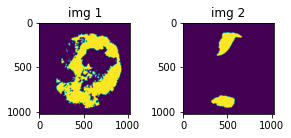

0.6524861454963684


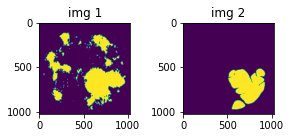

0.5808881521224976


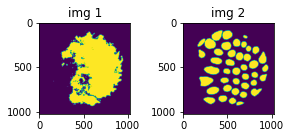

0.836667537689209


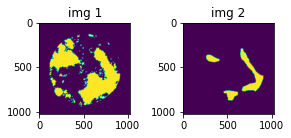

0.6959251761436462


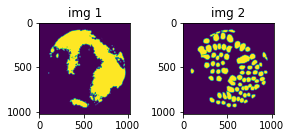

0.8373998403549194


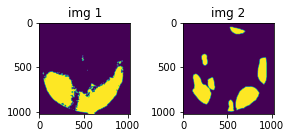

0.9399518966674805


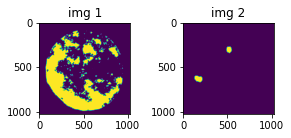

0.12186577916145325


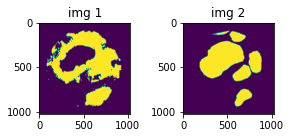

0.5670796036720276


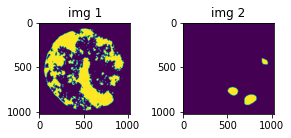

0.6021021008491516


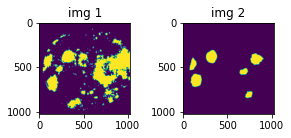

0.9126879572868347


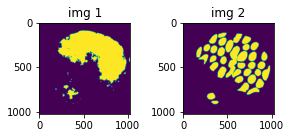

0.8297487497329712


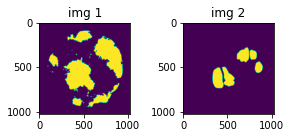

0.4510985314846039


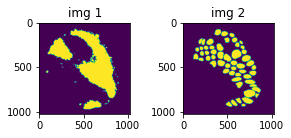

0.9072718620300293


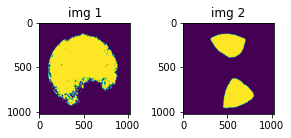

0.40252119302749634


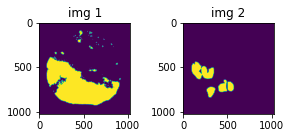

0.3748313784599304


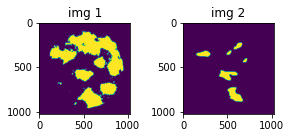

0.3005351722240448


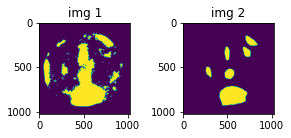

0.8762165904045105


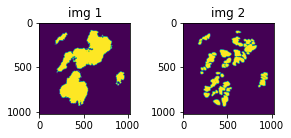

0.7205305695533752


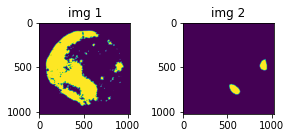

0.44303715229034424


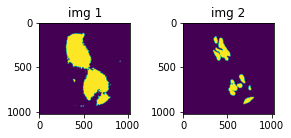

0.49361690878868103


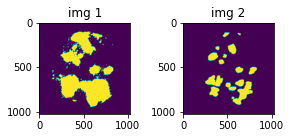

0.6232330799102783


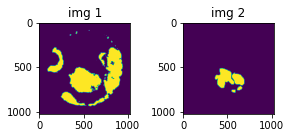

0.36952733993530273


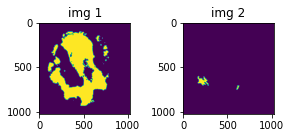

0.19573190808296204


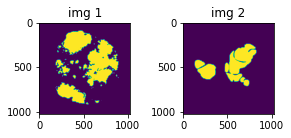

0.4202985465526581


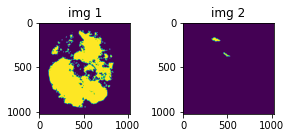

0.04199598729610443


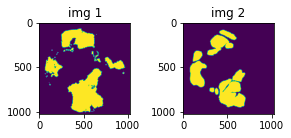

0.6711888909339905


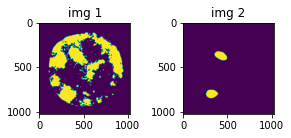

0.6209244728088379


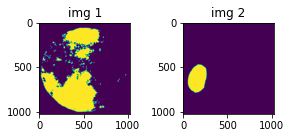

0.297725647687912


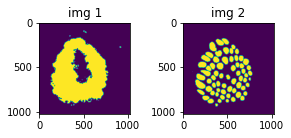

1.1770809888839722


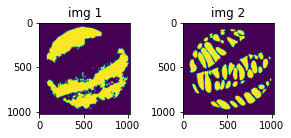

0.7095683813095093


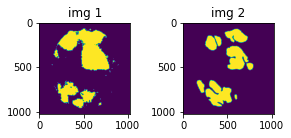

0.7196558713912964


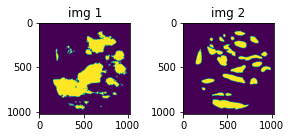

0.42250388860702515


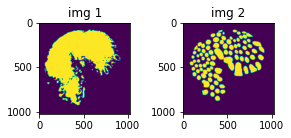

1.0389528274536133


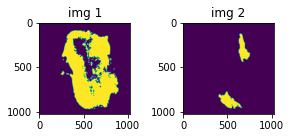

0.694915235042572


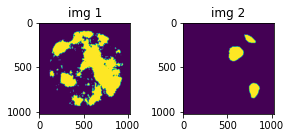

0.8352389931678772


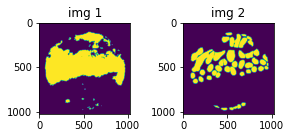

1.1253081560134888


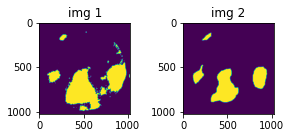

1.0889345407485962


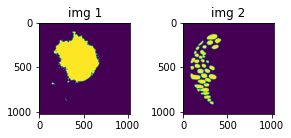

0.2527804970741272


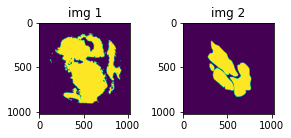

0.5822395086288452


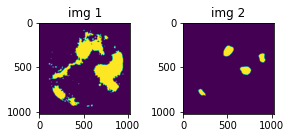

0.9027075171470642


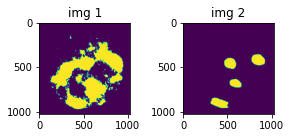

1.0642441511154175


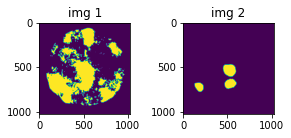

0.8385944962501526


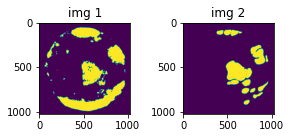

0.5786934494972229


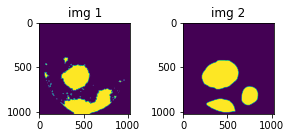

0.9758242964744568


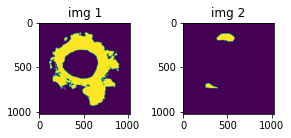

0.3237554430961609


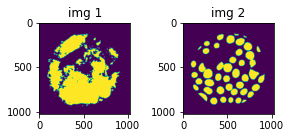

0.8079742789268494


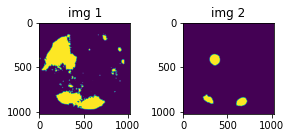

0.905572772026062


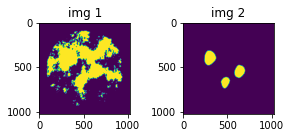

0.891238808631897


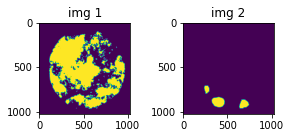

0.2866267263889313


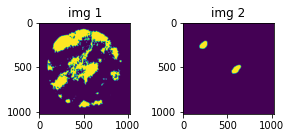

0.5246387720108032


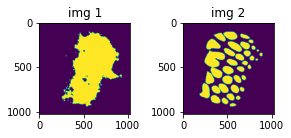

0.8554365038871765


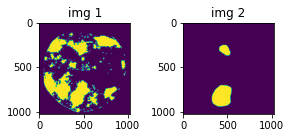

0.5052932500839233


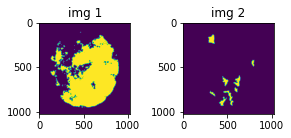

0.3247937262058258


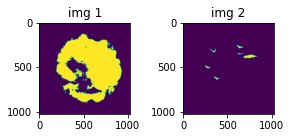

0.17379291355609894


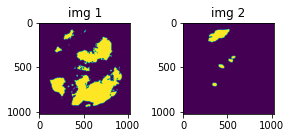

0.06589385867118835


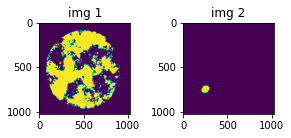

0.16269496083259583


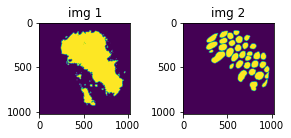

1.0531808137893677


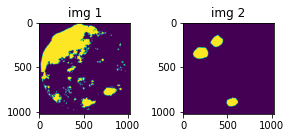

0.9410766959190369


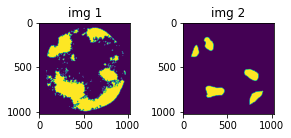

0.6976156234741211


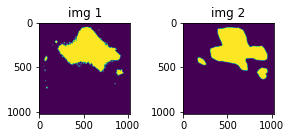

1.081931471824646


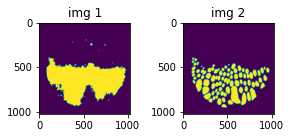

1.0531189441680908


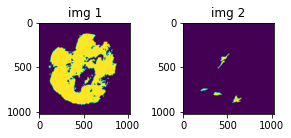

0.23666790127754211


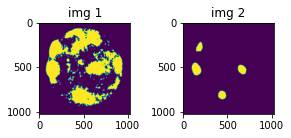

0.7609970569610596


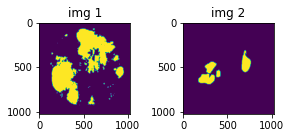

0.2828521430492401


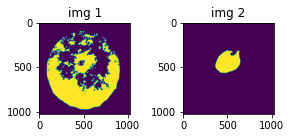

0.35286322236061096


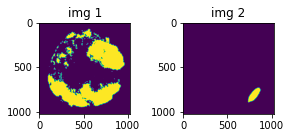

0.08928421139717102


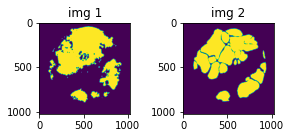

0.7608640789985657


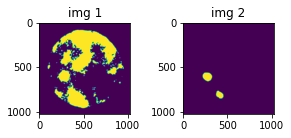

0.4392241835594177
FOLD: 0, EPOCH: 11, valid_loss: 0.6748688517307694 , Val Dice COE : 0.6316472580567113


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 12, train_loss: 0.6027762123516628 , Dice coe : 0.5591619893138731 
0.1588152050971985
0.863684892654419
0.5719237923622131
0.778311014175415
0.027005024254322052
1.003391146659851
1.115438461303711
0.7864386439323425
0.2359129935503006
0.40285810828208923
0.4193093180656433
0.9795761704444885
0.8302391767501831
0.6840007901191711
0.43971145153045654
1.037392020225525
0.6841940879821777
0.5643807053565979
0.9444746375083923
1.1561366319656372
0.4570959210395813
1.184766411781311
0.3008686304092407
0.3865956664085388
0.45922261476516724
0.1362149715423584
0.054803162813186646
0.6509037613868713
0.6914488077163696
0.3068506419658661
1.1295963525772095
1.0040556192398071
0.741814374923706
0.6976444721221924
1.2640517950057983
0.46091997623443604
0.5273820161819458
0.17152798175811768
0.5822505354881287
0.016113653779029846
0.3122393786907196
0.03443203866481781
0.022319365292787552
0.26736998558044434
0.7347230315208435
0.6840217113494873
1.2305976152420044
0.7432117462158

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 13, train_loss: 0.5885746527782508 , Dice coe : 0.556993481933523 
0.19098493456840515
0.9833394885063171
0.4813852310180664
0.8348472118377686
0.04047346115112305
0.9856892824172974
1.0966030359268188
1.0367153882980347
0.39188021421432495
0.29176241159439087
0.4480985105037689
0.7449647188186646
0.8998307585716248
0.8607098460197449
0.39569100737571716
1.067589282989502
0.7113847732543945
0.44158658385276794
0.6718904376029968
1.1943212747573853
0.9698200821876526
0.8015954494476318
0.5142678618431091
0.6448964476585388
0.5356935262680054
0.11223286390304565
0.0758630707859993
0.6812034845352173
0.9880093336105347
0.5090207457542419
1.165284276008606
0.8754652142524719
0.5943892598152161
0.6051890850067139
1.0804400444030762
0.8357263207435608
0.6671398878097534
0.17230209708213806
0.5593677163124084
0.007941442541778088
0.4030957818031311
0.0002557319530751556
0.4512597322463989
0.42532485723495483
0.6009488105773926
0.7087974548339844
1.222707748413086
0.72988736629

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 14, train_loss: 0.5837451766218458 , Dice coe : 0.5814839851844487 
0.01406300812959671
0.17342661321163177
0.38058844208717346
0.5147190093994141
0.008717473596334457
0.553054928779602
0.14603587985038757
0.261258065700531
0.17601801455020905
0.36399298906326294
0.5814316272735596
0.631114661693573
0.21752828359603882
0.2010568380355835
0.31843671202659607
0.04523564502596855
0.5762375593185425
0.5523375272750854
0.8368316888809204
0.363797128200531
0.342324823141098
1.0111918449401855
0.2746836841106415
0.5776569247245789
0.3397757112979889
0.28326988220214844
0.11937743425369263
0.7179995179176331
0.2311858981847763
0.37249755859375
0.8357354998588562
0.34923866391181946
0.05629497766494751
0.32155612111091614
0.776199460029602
0.3416456878185272
0.23474954068660736
0.1594417840242386
0.5237613320350647
9.289277841162402e-06
0.0782209187746048
0.11880423873662949
0.4647423028945923
0.08724208176136017
0.5490638017654419
0.3744332790374756
1.2114375829696655
0.4786814

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 15, train_loss: 0.5923892190200942 , Dice coe : 0.5783402444251818 
0.15757794678211212
0.8054332733154297
0.5999786853790283
0.7695498466491699
0.04005514830350876
0.8239304423332214
1.1250325441360474
1.0336871147155762
0.6354331374168396
0.36580008268356323
0.42627638578414917
0.45608165860176086
0.9116491079330444
0.7768754959106445
0.3705037534236908
1.0955536365509033
0.5439695715904236
0.3465624153614044
0.5591550469398499
1.198958396911621
1.2556512355804443
0.6843343377113342
0.4246333837509155
0.8303799033164978
0.5850869417190552
0.23251506686210632
0.1703692078590393
0.4153616726398468
0.7244830131530762
0.3719835579395294
1.1089286804199219
0.6759874224662781
0.4131163954734802
0.6293524503707886
0.8236775398254395
1.028449535369873
0.6761528849601746
0.17156797647476196
0.4767872095108032
0.2858639359474182
0.35921791195869446
0.08960631489753723
0.6386348605155945
0.5094422698020935
0.8216424584388733
0.769080638885498
0.8579559922218323
0.746320605278015

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 16, train_loss: 0.5994871666601725 , Dice coe : 0.5420050421436475 


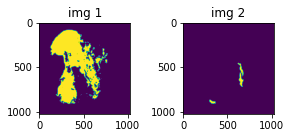

0.1466607004404068


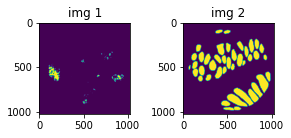

0.0855303630232811


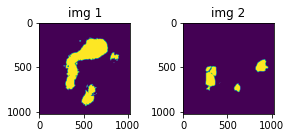

0.38164517283439636


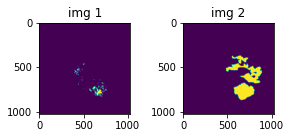

0.12236175686120987


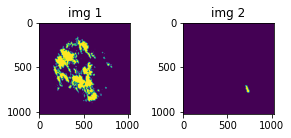

0.00022482014901470393


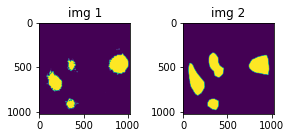

0.8260024189949036


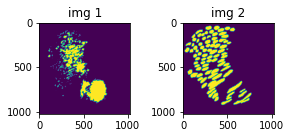

0.45008450746536255


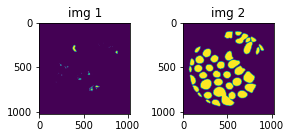

0.0008203056640923023


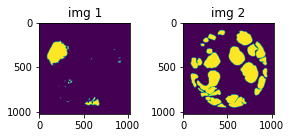

0.09917867928743362


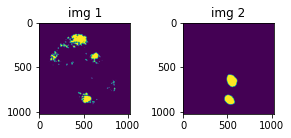

0.375108003616333


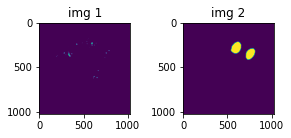

0.023787152022123337


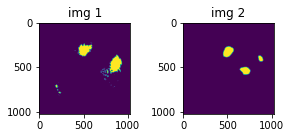

0.8614981174468994


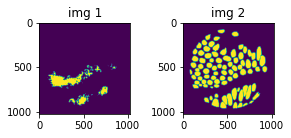

0.2778785824775696


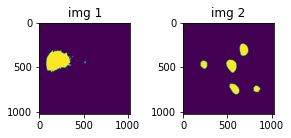

0.20718805491924286


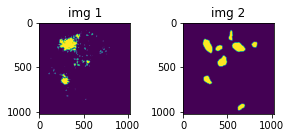

0.409257709980011


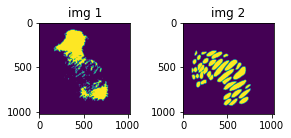

0.4006110429763794


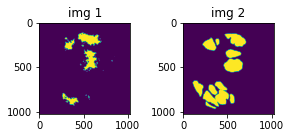

0.449444979429245


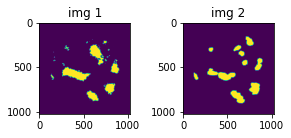

0.6913279294967651


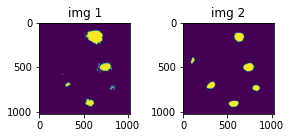

1.0777406692504883


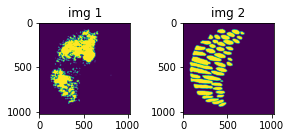

0.683163583278656


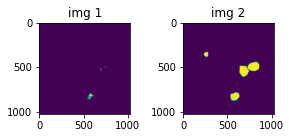

0.09491723775863647


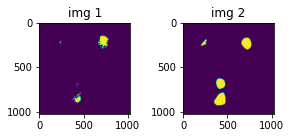

0.5247334241867065


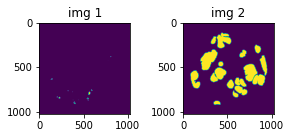

0.008437708020210266


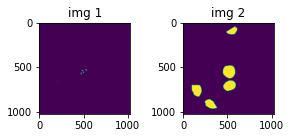

0.013060308992862701


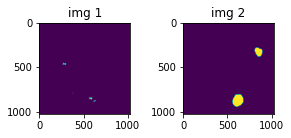

0.05208553001284599


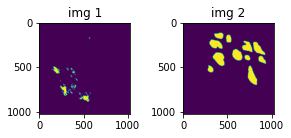

0.0024997303262352943


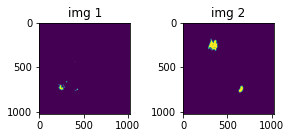

2.3381420760415494e-05


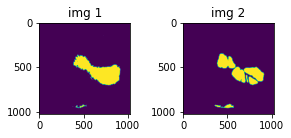

0.8248531222343445


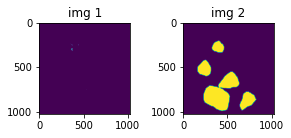

0.002456369809806347


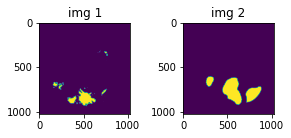

0.2365117073059082


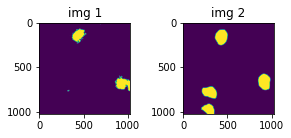

0.65729820728302


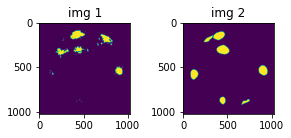

0.6255464553833008


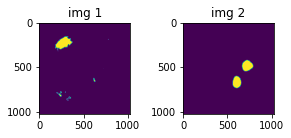

0.030497515574097633


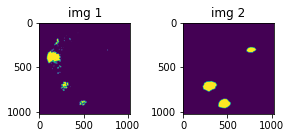

0.2699970304965973


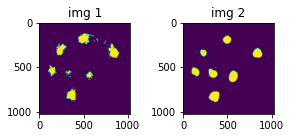

1.0218607187271118


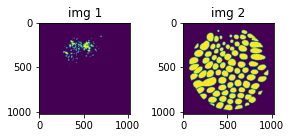

0.046056538820266724


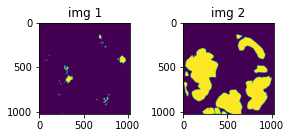

0.015520676970481873


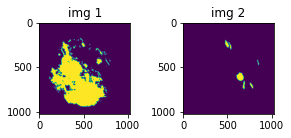

0.12782780826091766


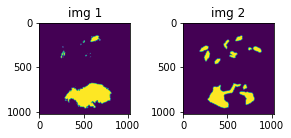

0.5344547629356384


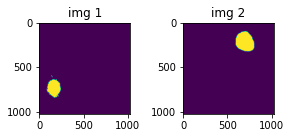

1.0385078894614708e-05


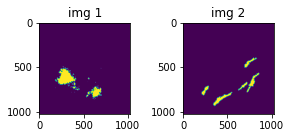

0.02863018587231636


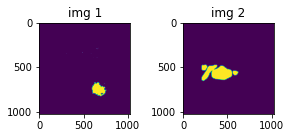

1.6504101949976757e-05


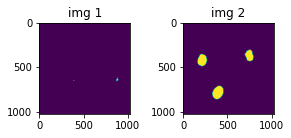

5.85727002544445e-06


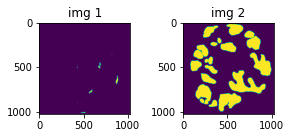

0.0011557444231584668


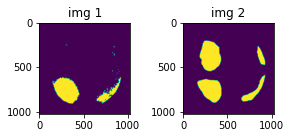

0.7040023803710938


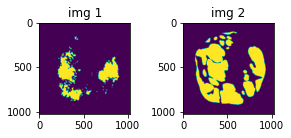

0.384902685880661


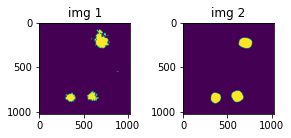

1.152152419090271


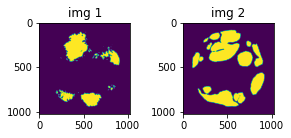

0.5260153412818909


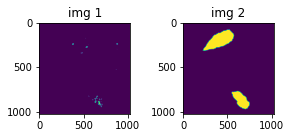

0.03215911611914635


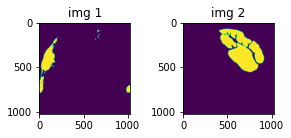

0.00219819531776011


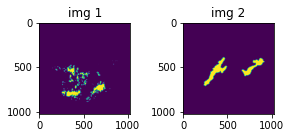

0.15340670943260193


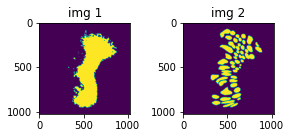

0.9863525032997131


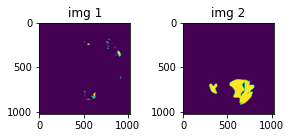

0.03394436836242676


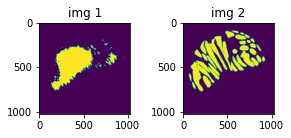

0.6617097854614258


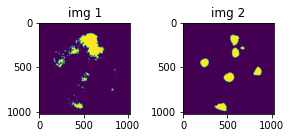

0.811416745185852


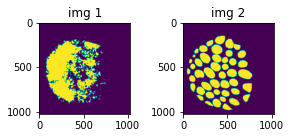

0.8582665920257568


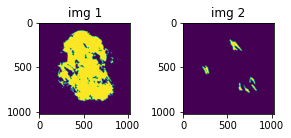

0.31587815284729004


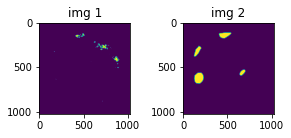

0.09119180589914322


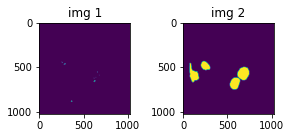

0.01218660268932581


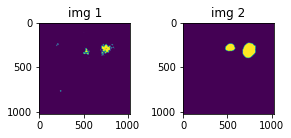

0.43864232301712036


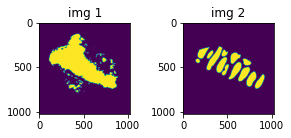

1.0108472108840942


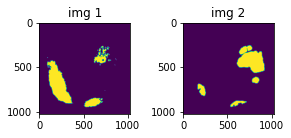

0.2980063259601593


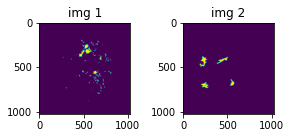

0.005984005518257618


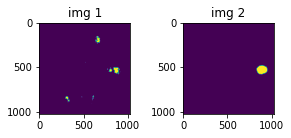

0.5109867453575134


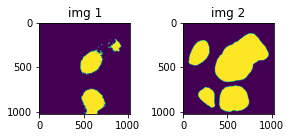

0.4931477904319763


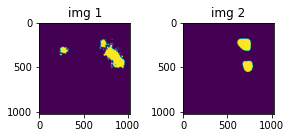

0.24821820855140686


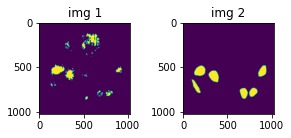

0.679617702960968


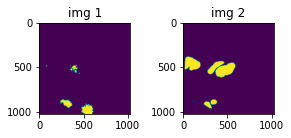

0.13413920998573303


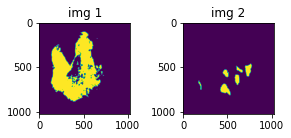

0.4568626284599304


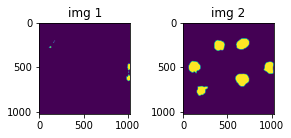

0.027170397341251373


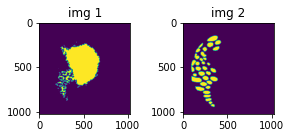

0.18137270212173462


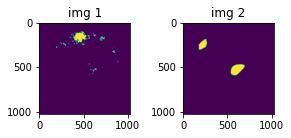

0.04807309806346893


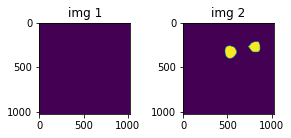

0.003763781627640128


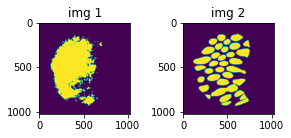

0.9326369166374207


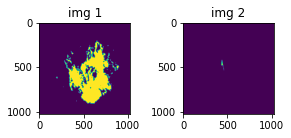

6.292711987043731e-06


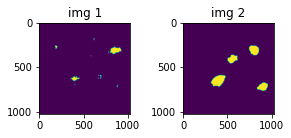

0.2460542917251587


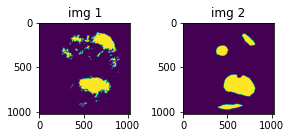

0.7714022397994995


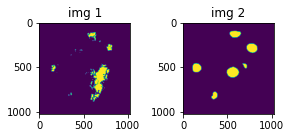

0.37320199608802795


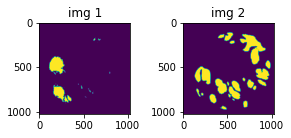

0.095708467066288


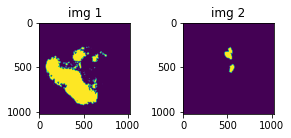

0.11433447897434235


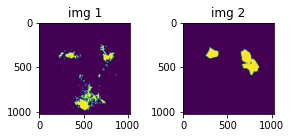

0.2554716467857361


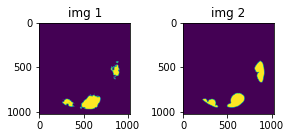

0.7105768918991089


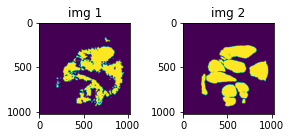

0.6792477369308472


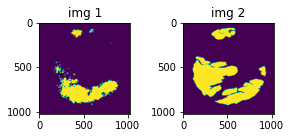

0.5089600682258606


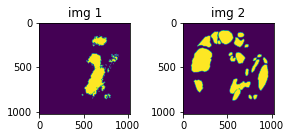

0.29573529958724976


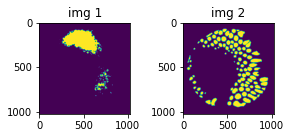

0.44299113750457764


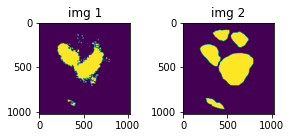

0.7812915444374084


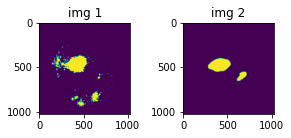

0.8927105665206909


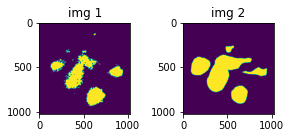

0.8521202206611633


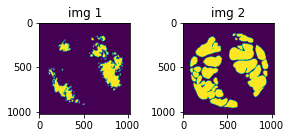

0.4194898307323456


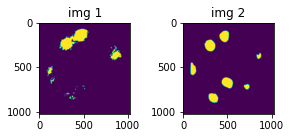

0.8105369210243225


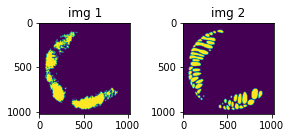

0.7947329878807068


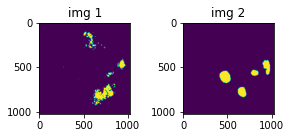

0.44928696751594543


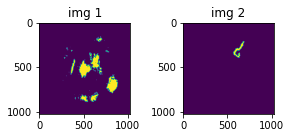

0.09066670387983322


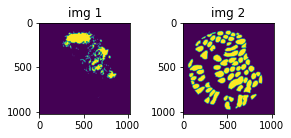

0.28060969710350037


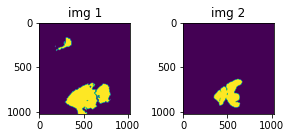

0.5873370170593262


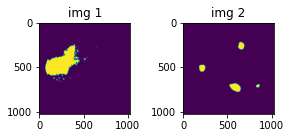

0.27417904138565063


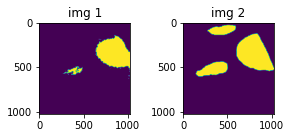

0.7652658820152283


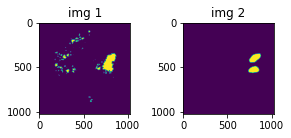

1.0875493288040161


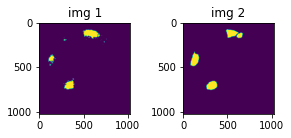

1.0431640148162842


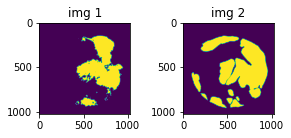

0.6478319764137268


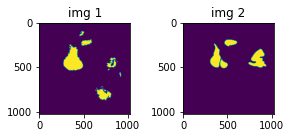

0.5584684610366821


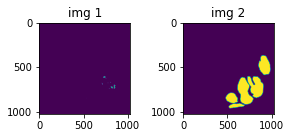

0.014745582826435566


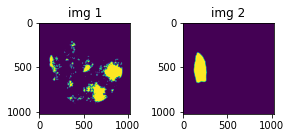

0.1640303134918213


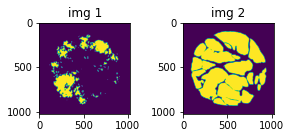

0.3379019498825073


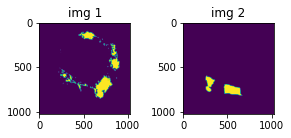

0.13238085806369781


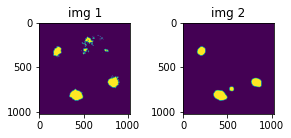

1.3631433248519897


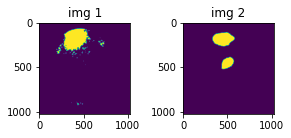

0.745497465133667


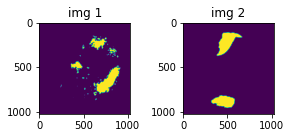

0.016092946752905846


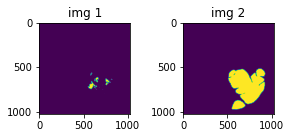

0.08244297653436661


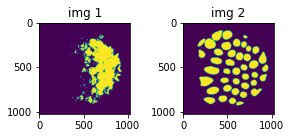

0.6073446869850159


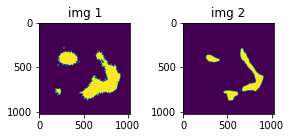

0.9153431057929993


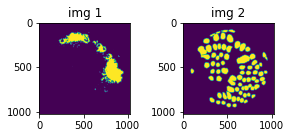

0.3658744692802429


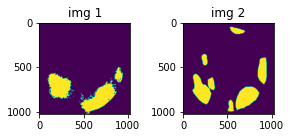

0.9717525839805603


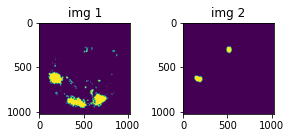

0.3467525839805603


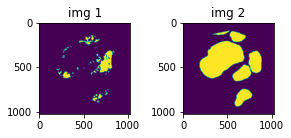

0.23825697600841522


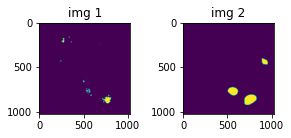

0.3653806447982788


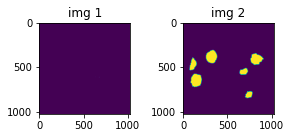

3.396473857719684e-06


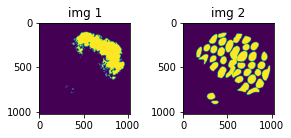

0.426557332277298


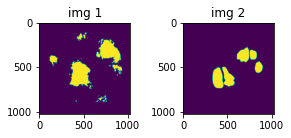

0.5298840403556824


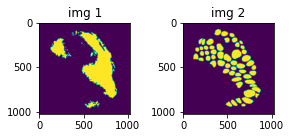

0.7775452733039856


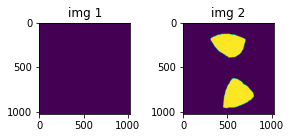

3.2882730920391623e-06


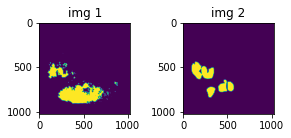

0.4407397210597992


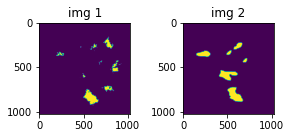

0.35700127482414246


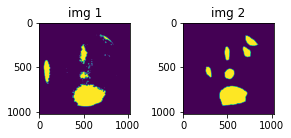

0.944203794002533


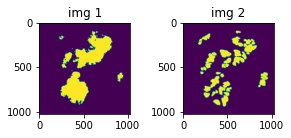

0.7094831466674805


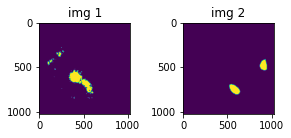

0.44705313444137573


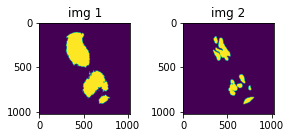

0.5622774362564087


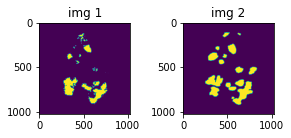

0.6439096927642822


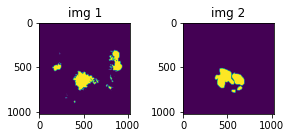

0.4674144387245178


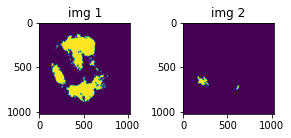

0.19736848771572113


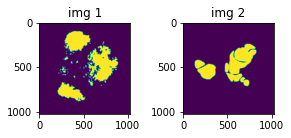

0.31137001514434814


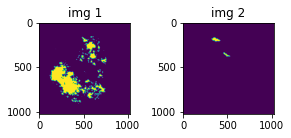

0.01281999982893467


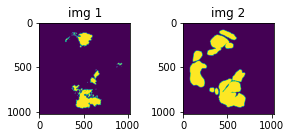

0.41211554408073425


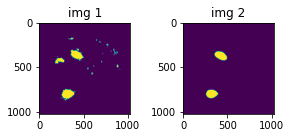

1.4361501932144165


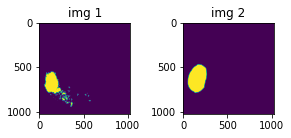

0.7984176874160767


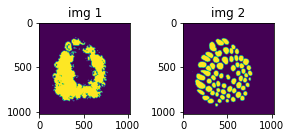

1.0281569957733154


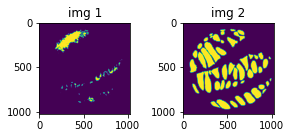

0.1507508009672165


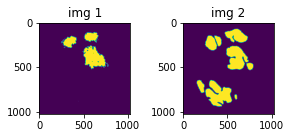

0.5234209895133972


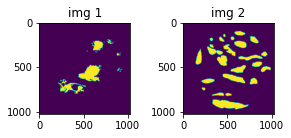

0.2822285294532776


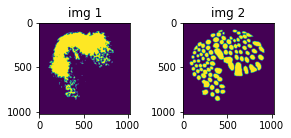

0.7512489557266235


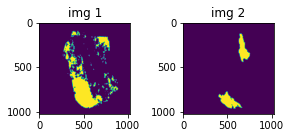

0.6783865094184875


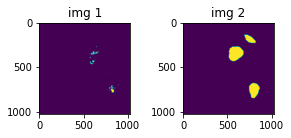

0.10618557035923004


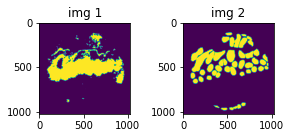

0.8753071427345276


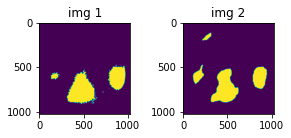

1.0899267196655273


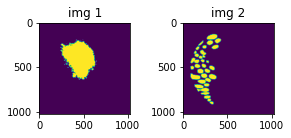

0.050307612866163254


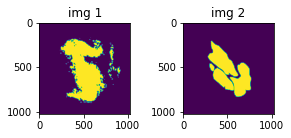

0.6107515096664429


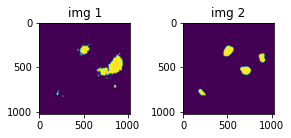

0.9524610638618469


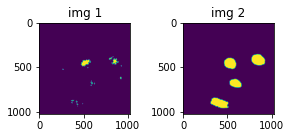

0.26368337869644165


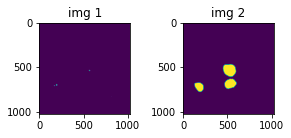

0.012412921525537968


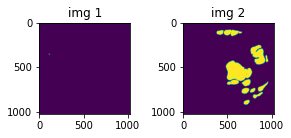

4.459865522221662e-05


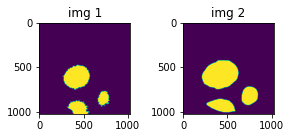

0.866747260093689


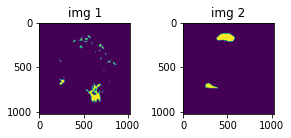

0.08380502462387085


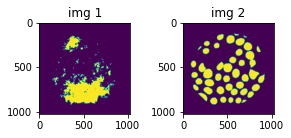

0.4792258143424988


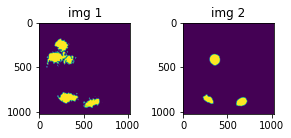

0.8161570429801941


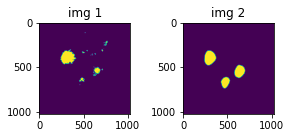

0.8611425161361694


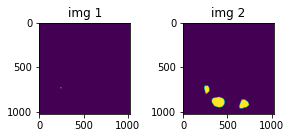

0.009971154853701591


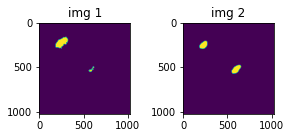

0.8133793473243713


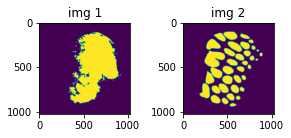

0.8101386427879333


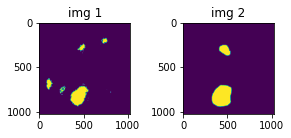

0.8067025542259216


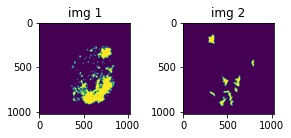

0.18570196628570557


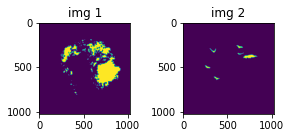

0.1749044507741928


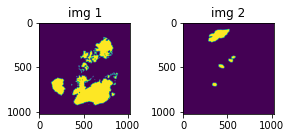

0.019461052492260933


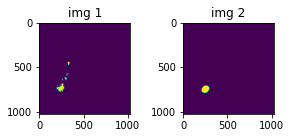

0.8899316191673279


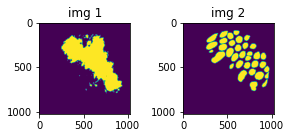

0.9774693846702576


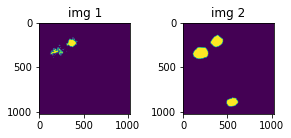

0.4447300434112549


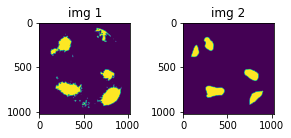

0.9088354110717773


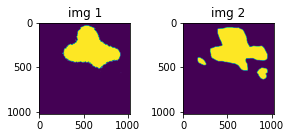

1.1038342714309692


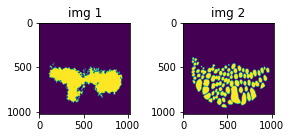

0.7865341305732727


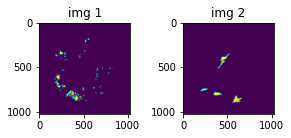

0.1350994110107422


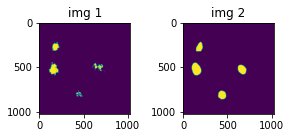

0.7782818675041199


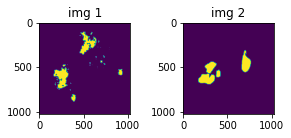

0.25557464361190796


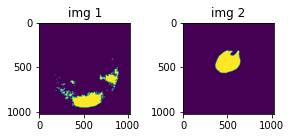

6.056348411220824e-06


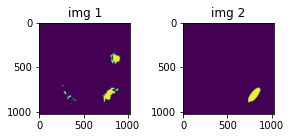

0.4991711378097534


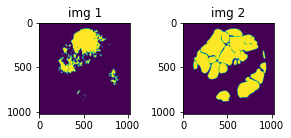

0.4651779532432556


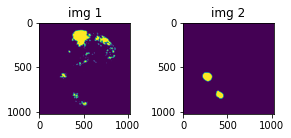

0.26405829191207886
FOLD: 0, EPOCH: 16, valid_loss: 0.6918112346055832 , Val Dice COE : 0.4355950473432131


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 17, train_loss: 0.5834437863315854 , Dice coe : 0.5683384597069003 
0.1318860799074173
0.8704940676689148
0.5943021774291992
0.7508164048194885
0.03744535893201828
0.857971727848053
1.0811163187026978
0.9077120423316956
0.10281496495008469
0.3849623501300812
0.4503936469554901
0.6737885475158691
0.9061358571052551
0.783435583114624
0.27835792303085327
1.0225919485092163
0.5819215774536133
0.5521763563156128
1.0198472738265991
1.2018170356750488
0.04685445502400398
1.064348578453064
0.2535879611968994
0.17781640589237213
0.038609620183706284
0.24164451658725739
0.059485193341970444
0.5653956532478333
0.30375298857688904
0.12523941695690155
1.0921833515167236
0.8320876955986023
0.6407576203346252
0.3498168885707855
1.0364152193069458
0.5637148022651672
0.6593019962310791
0.15855200588703156
0.553650438785553
0.004988954868167639
0.36622685194015503
0.03021438606083393
0.016942761838436127
0.384311318397522
0.6381489038467407
0.7179197669029236
0.3200153410434723
0.7256207

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 18, train_loss: 0.5917029027427946 , Dice coe : 0.5224198522664899 
0.1427834928035736
0.9008734822273254
0.5559341907501221
0.6997677087783813
0.03555963188409805
0.5920155644416809
1.0727124214172363
1.0853960514068604
0.6689556241035461
0.3507741093635559
0.35263413190841675
0.3175882399082184
1.0983285903930664
0.5603463053703308
0.2697458863258362
0.9990746974945068
0.3968788981437683
0.25082793831825256
0.4586414694786072
1.1508179903030396
0.8965304493904114
0.5101273059844971
0.45285168290138245
0.7672157287597656
0.3621211647987366
0.2551466226577759
0.15916253626346588
0.2724704444408417
0.6025623679161072
0.23852036893367767
0.8198142647743225
0.5509543418884277
0.3158872127532959
0.44683635234832764
0.6672844886779785
1.2060728073120117
0.6051701903343201
0.16752855479717255
0.2911413609981537
0.2434774786233902
0.3019169867038727
0.139820858836174
0.44741782546043396
0.5365108847618103
0.6798142194747925
0.7081029415130615
0.5806218981742859
0.6293963193893

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 19, train_loss: 0.5846304700204304 , Dice coe : 0.6247170902000653 
0.1500927060842514
0.9986103177070618
0.6003125309944153
0.7684562802314758
0.03852936625480652
0.8587732911109924
1.0937234163284302
1.0982170104980469
0.6559367179870605
0.31868988275527954
0.41552969813346863
0.5320448279380798
1.0029386281967163
0.7595798969268799
0.3696666657924652
1.0907697677612305
0.5607897043228149
0.3801352381706238
0.5973054766654968
1.206855297088623
0.9862455129623413
0.7131746411323547
0.437035471200943
0.8401585817337036
0.599038302898407
0.27411434054374695
0.16717329621315002
0.49347740411758423
0.5240135788917542
0.3533010482788086
1.049837589263916
0.7563040256500244
0.4629920423030853
0.6338462829589844
0.9029127955436707
0.9933307766914368
0.7417488098144531
0.17861352860927582
0.5106616020202637
0.16455693542957306
0.3485189378261566
0.0612577460706234
0.6800954937934875
0.5187773704528809
0.7118076086044312
0.7779388427734375
0.9356374740600586
0.7693077325820923


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 20, train_loss: 0.594453747017043 , Dice coe : 0.5929619893809897 
0.1807974874973297
0.7270662188529968
0.5268023014068604
0.6103509664535522
0.04647834599018097
0.5252493619918823
1.113366961479187
0.8988149762153625
0.5874060988426208
0.24460247159004211
0.5368664860725403
0.5297935009002686
0.9386957883834839
0.6676338315010071
0.22315825521945953
1.1008964776992798
0.6045209765434265
0.34084615111351013
0.506788432598114
1.211193323135376
0.8457687497138977
0.9009044766426086
0.3848685622215271
0.8215621709823608
0.5879049301147461
0.0008751635905355215
0.05489283427596092
0.5006037950515747
0.6842032074928284
0.3909401297569275
0.7221046686172485
0.6553899049758911
0.7943190932273865
0.5294933319091797
0.7476168870925903
1.2099244594573975
0.6052159070968628
0.18268194794654846
0.48309049010276794
0.16079725325107574
0.3883568346500397
0.08392513543367386
0.6460784077644348
0.5230427384376526
0.6630265712738037
0.738950252532959
0.613807201385498
0.709662437438964

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 21, train_loss: 0.5975342105116163 , Dice coe : 0.5851266754183364 


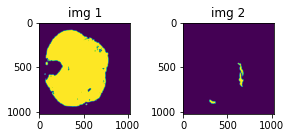

0.1465255320072174


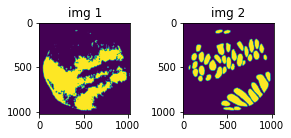

0.6966192722320557


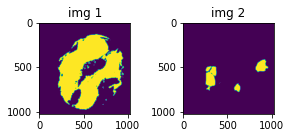

0.6155643463134766


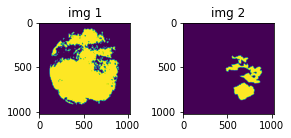

0.7805126905441284


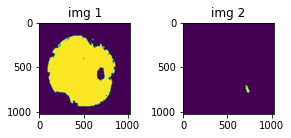

0.037926334887742996


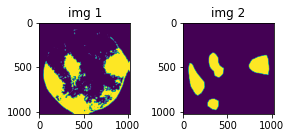

0.9344149231910706


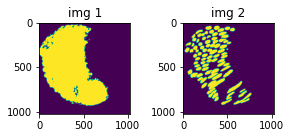

1.1582928895950317


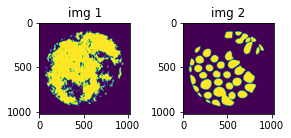

0.8817313313484192


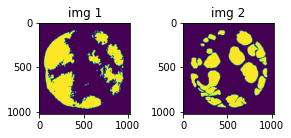

0.6420226693153381


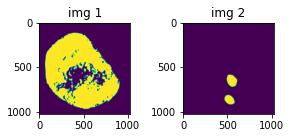

0.33322301506996155


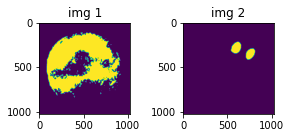

0.5035694241523743


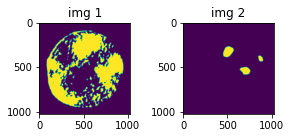

0.5207552313804626


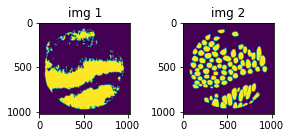

0.8975282907485962


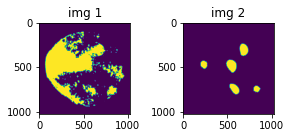

0.7770082354545593


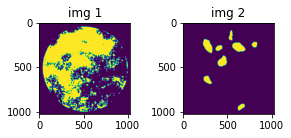

0.39675793051719666


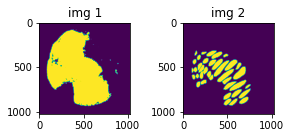

1.1186704635620117


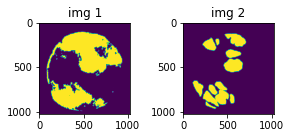

0.6215737462043762


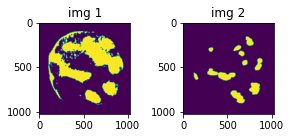

0.4489153027534485


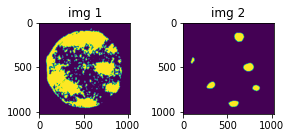

0.7411606311798096


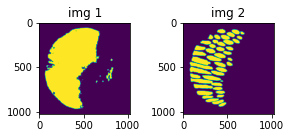

1.226204752922058


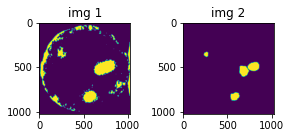

1.1217026710510254


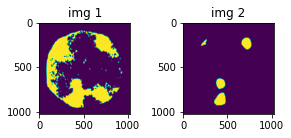

0.899019718170166


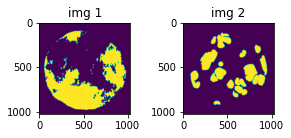

0.39957869052886963


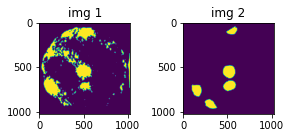

1.008497953414917


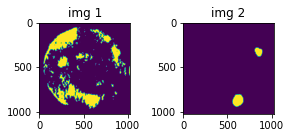

0.6998170018196106


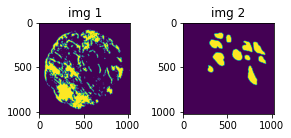

0.1508706510066986


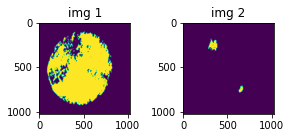

0.08441976457834244


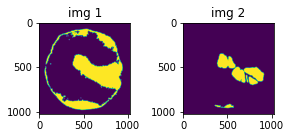

0.533731997013092


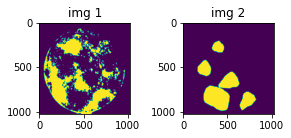

0.44401854276657104


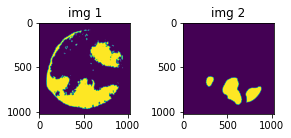

0.40355122089385986


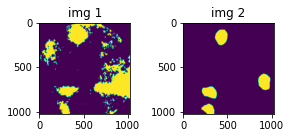

1.1005852222442627


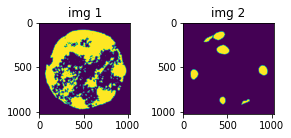

0.8083081841468811


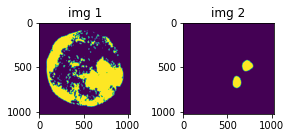

0.5598687529563904


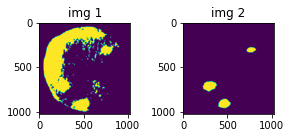

0.6784858703613281


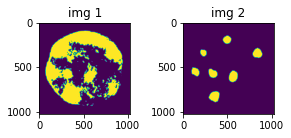

0.9601569771766663


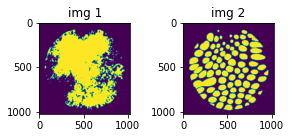

0.9704118967056274


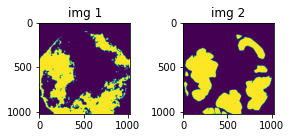

0.7054475545883179


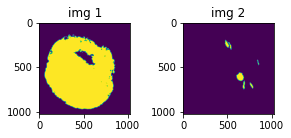

0.17332209646701813


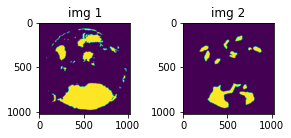

0.576697826385498


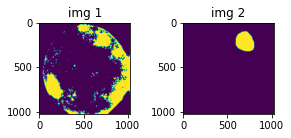

0.3468034565448761


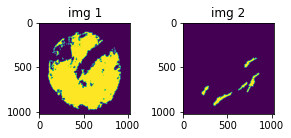

0.3735131621360779


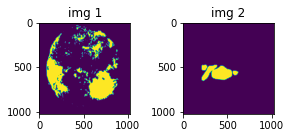

0.10853997617959976


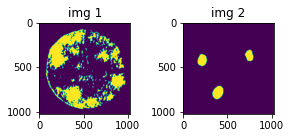

0.8099080920219421


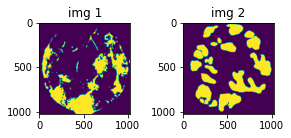

0.4583667516708374


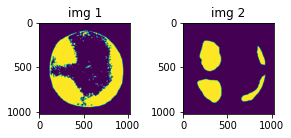

0.9545471668243408


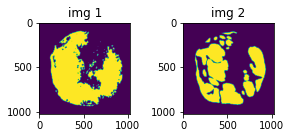

0.7893308997154236


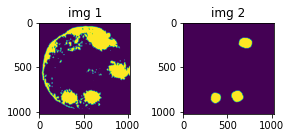

0.9660179615020752


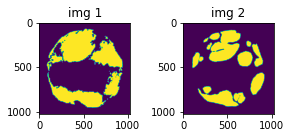

0.7914239764213562


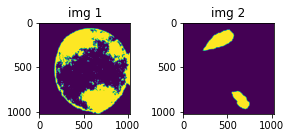

0.6475571393966675


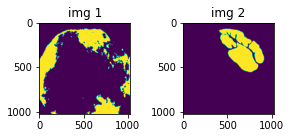

0.3109470009803772


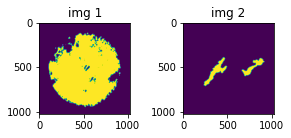

0.484529972076416


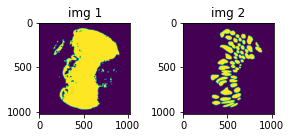

1.1139129400253296


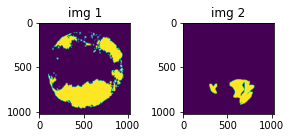

0.3655383884906769


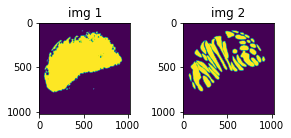

1.2006878852844238


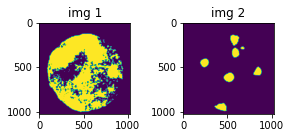

0.7696751952171326


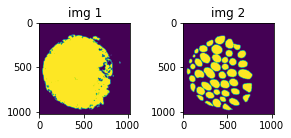

1.2177786827087402


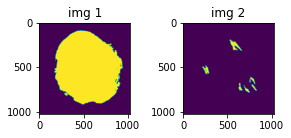

0.24780815839767456


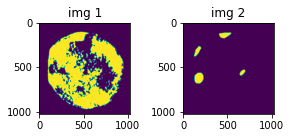

0.4626907706260681


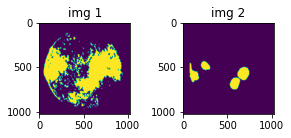

0.9420551657676697


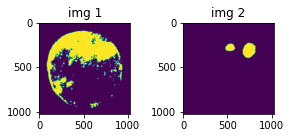

0.7376915812492371


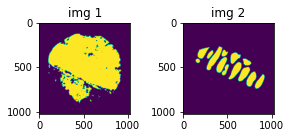

0.903453528881073


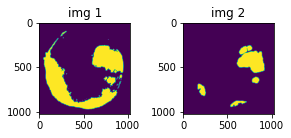

0.49648118019104004


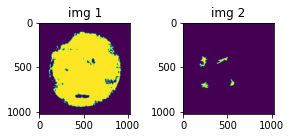

0.16857858002185822


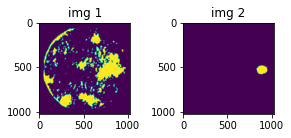

0.4121749997138977


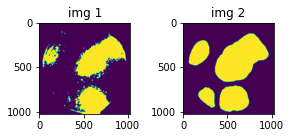

0.9388606548309326


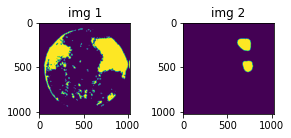

0.7876029014587402


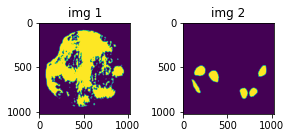

0.8527714610099792


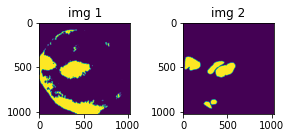

0.5222804546356201


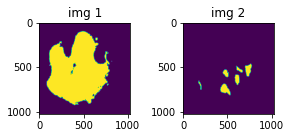

0.4627787172794342


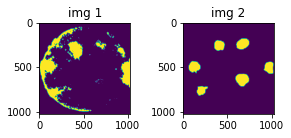

0.8085785508155823


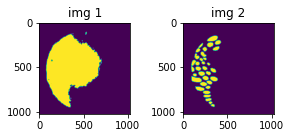

0.8619888424873352


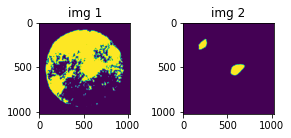

0.4765070676803589


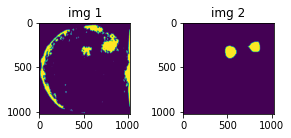

0.7755218148231506


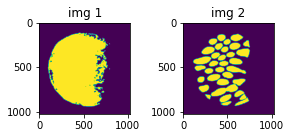

1.1912434101104736


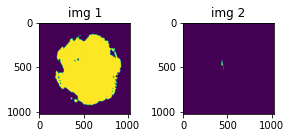

0.014488030225038528


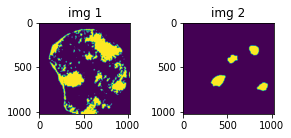

0.8982580304145813


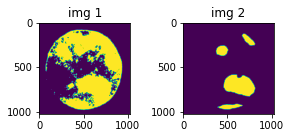

0.6760642528533936


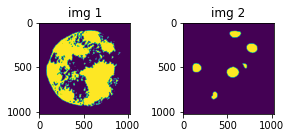

0.7699881792068481


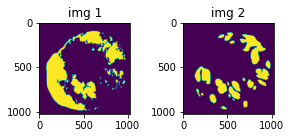

0.5327743887901306


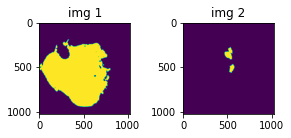

0.21385586261749268


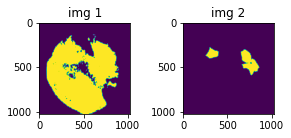

0.5512585639953613


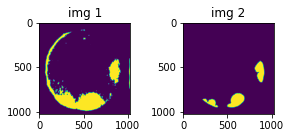

0.49899914860725403


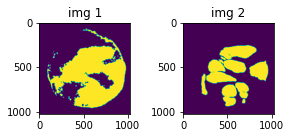

0.735722005367279


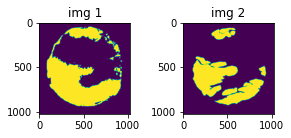

0.7833008766174316


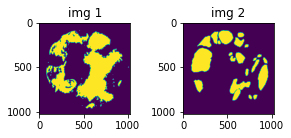

0.4949369430541992


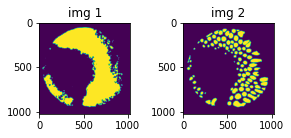

1.0689090490341187


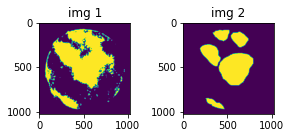

1.0630812644958496


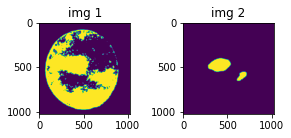

0.34356197714805603


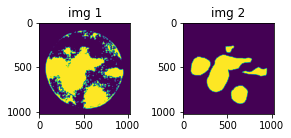

1.065388798713684


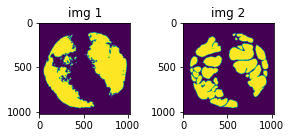

0.8006832003593445


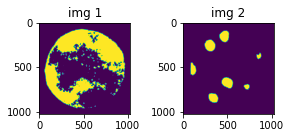

0.9285861253738403


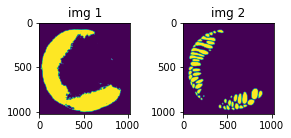

1.0916759967803955


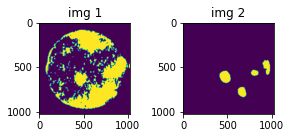

0.6998313665390015


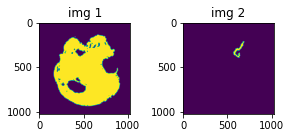

0.10623602569103241


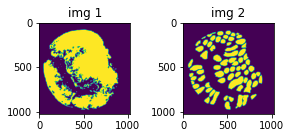

1.0846341848373413


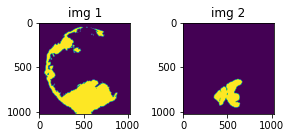

0.4085063934326172


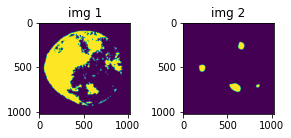

0.4200860261917114


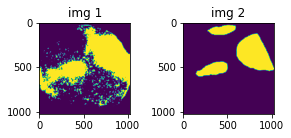

0.914577305316925


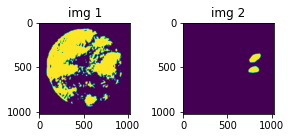

0.3929184675216675


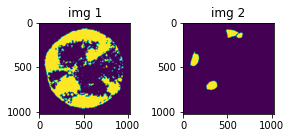

0.6864327788352966


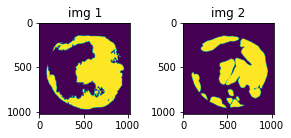

0.8129013776779175


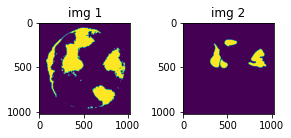

0.4336314797401428


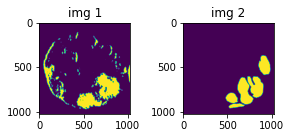

0.5450900793075562


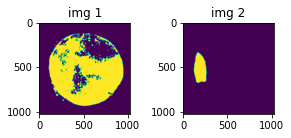

0.30325978994369507


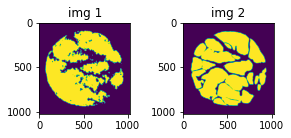

0.8649799823760986


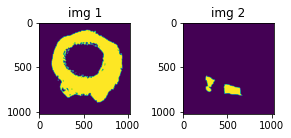

0.46962782740592957


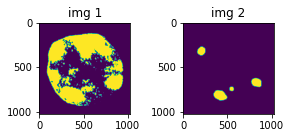

0.7030081152915955


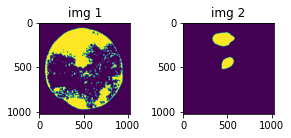

0.4629397690296173


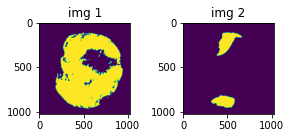

0.7087512016296387


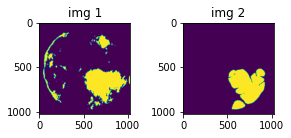

0.7024248242378235


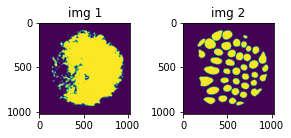

1.0078717470169067


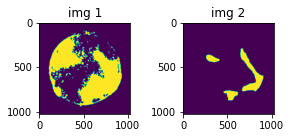

0.5894144177436829


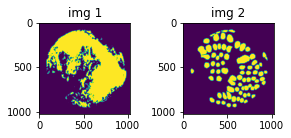

0.9590969085693359


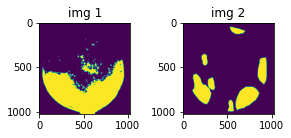

0.8507422208786011


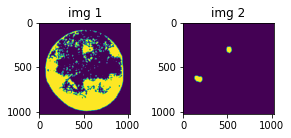

0.10744377225637436


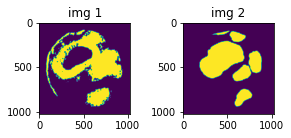

0.6537168025970459


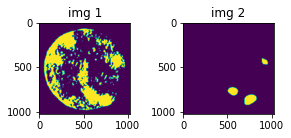

0.6208662390708923


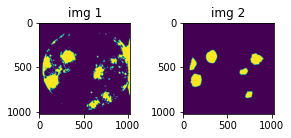

1.0368233919143677


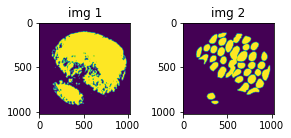

1.1189838647842407


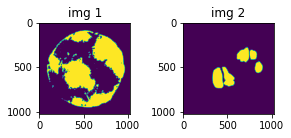

0.3902437090873718


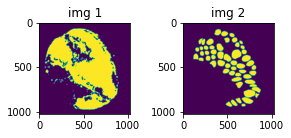

1.023427128791809


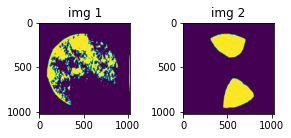

0.3975551128387451


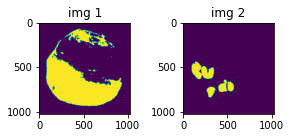

0.3055945634841919


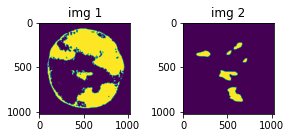

0.22009402513504028


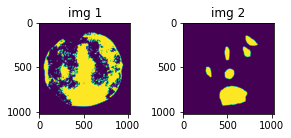

0.7378795742988586


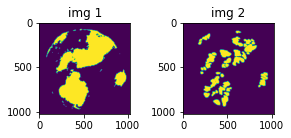

0.6853188276290894


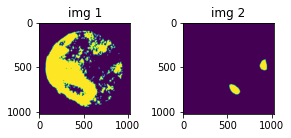

0.3591478168964386


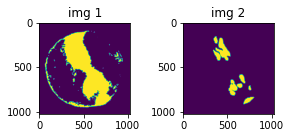

0.38809022307395935


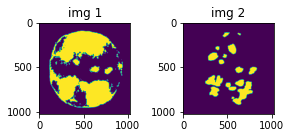

0.46189990639686584


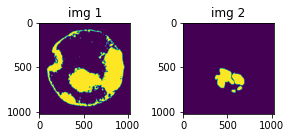

0.30751094222068787


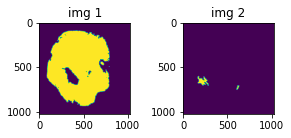

0.12975357472896576


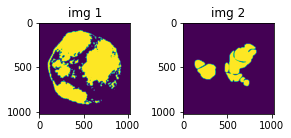

0.45062872767448425


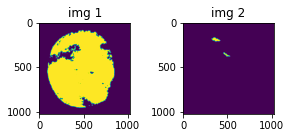

0.06340247392654419


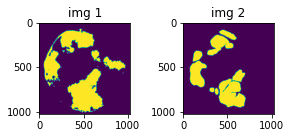

0.7080417275428772


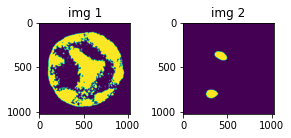

0.47508758306503296


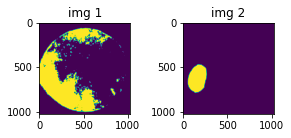

0.4502745568752289


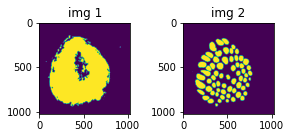

1.1986842155456543


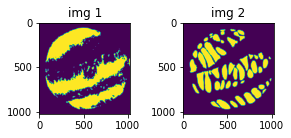

0.8871482014656067


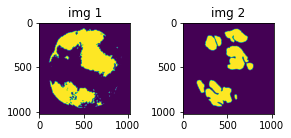

0.7129059433937073


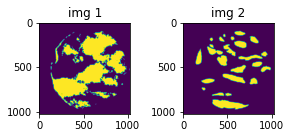

0.5042717456817627


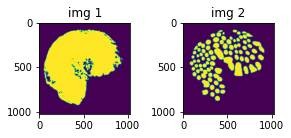

1.1227837800979614


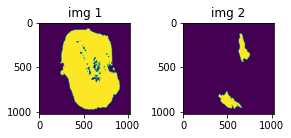

0.5839869379997253


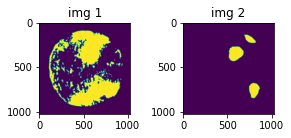

0.8806931972503662


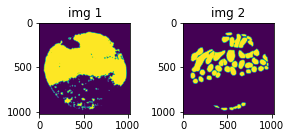

1.1726785898208618


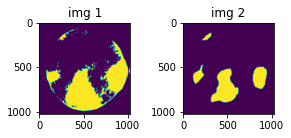

0.9696363806724548


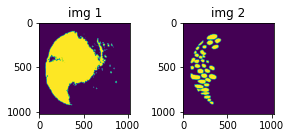

0.8409793972969055


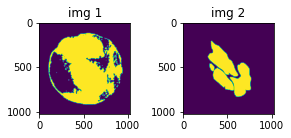

0.5397655963897705


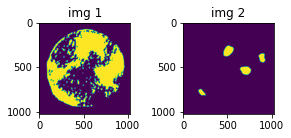

0.6181374788284302


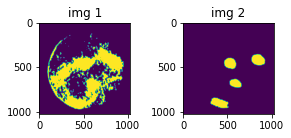

1.038931131362915


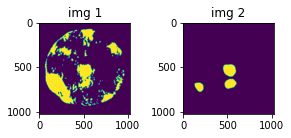

0.9157065153121948


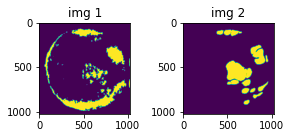

0.4872266352176666


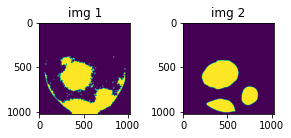

1.0772664546966553


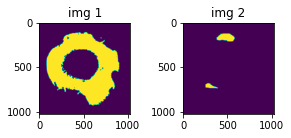

0.3510860502719879


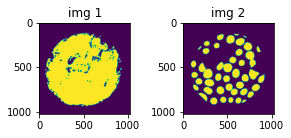

1.0927164554595947


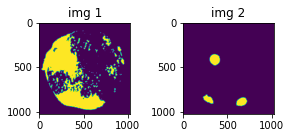

0.6964669823646545


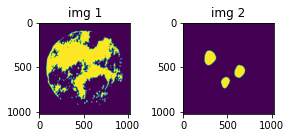

0.7923099398612976


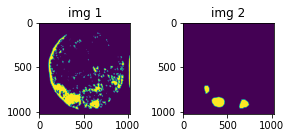

0.7359990477561951


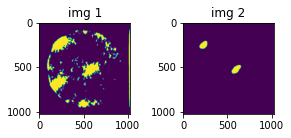

0.7289872765541077


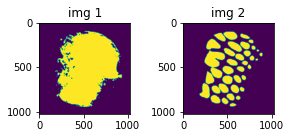

1.1421055793762207


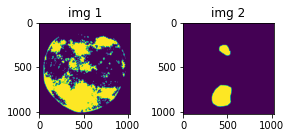

0.551280677318573


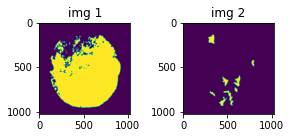

0.2933175563812256


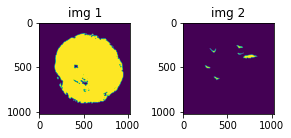

0.13033002614974976


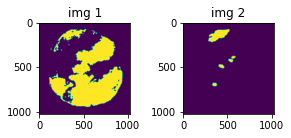

0.10655434429645538


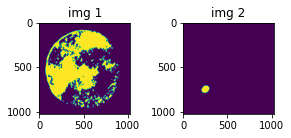

0.17941561341285706


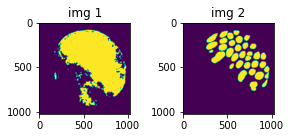

1.1398340463638306


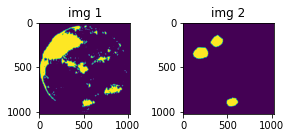

1.04457688331604


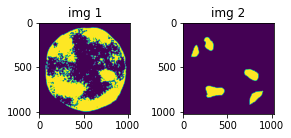

0.552104651927948


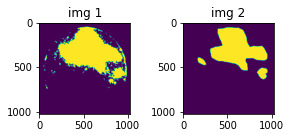

1.096703290939331


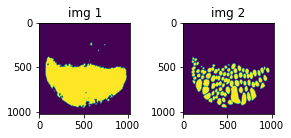

1.1988087892532349


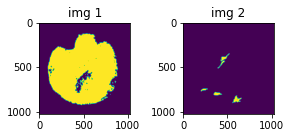

0.18967288732528687


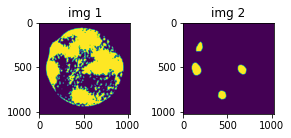

0.6406081318855286


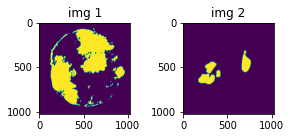

0.2836810052394867


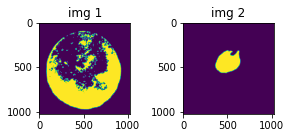

0.16099362075328827


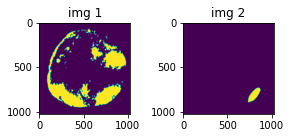

0.12156298756599426


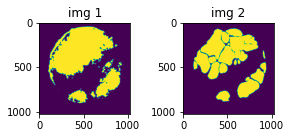

0.8512399196624756


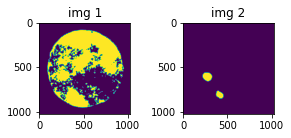

0.32516831159591675
FOLD: 0, EPOCH: 21, valid_loss: 0.6703168456865982 , Val Dice COE : 0.6546717153184793


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 22, train_loss: 0.5904063926850046 , Dice coe : 0.620712512314658 
0.15955878794193268
0.6373756527900696
0.6625781655311584
0.38270774483680725
0.040012143552303314
1.0306541919708252
1.1518642902374268
0.7791695594787598
0.6068798899650574
0.34121832251548767
0.578611433506012
0.7106412649154663
0.8534528613090515
0.8525038957595825
0.43321824073791504
1.1170604228973389
0.6496429443359375
0.534420371055603
0.8742296695709229
1.227059006690979
1.3716273307800293
1.0520316362380981
0.356326699256897
1.1046322584152222
0.8311874866485596
0.013319713994860649
0.06892241537570953
0.5750768780708313
0.42318201065063477
0.4146648943424225
1.182331919670105
0.951957106590271
0.79388028383255
0.7588270306587219
1.0737944841384888
0.8409445285797119
0.7170186638832092
0.18293260037899017
0.5907232165336609
0.4645688831806183
0.37666863203048706
0.07487747818231583
1.0574843883514404
0.4623524844646454
1.0312858819961548
0.7966679334640503
1.106188416481018
0.8172941207885742
0

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 23, train_loss: 0.5760809803434781 , Dice coe : 0.6115799847559122 
0.15099835395812988
0.9168422818183899
0.6328905820846558
0.7999635934829712
0.034915219992399216
1.1193970441818237
1.1565159559249878
1.04114830493927
0.5783132910728455
0.3392888903617859
0.46728944778442383
0.5596317648887634
0.9159122705459595
0.9230448007583618
0.5489348769187927
1.1083385944366455
0.670207679271698
0.5120771527290344
0.7649646997451782
1.234936237335205
1.3286025524139404
0.8571199774742126
0.461918443441391
0.9612401127815247
0.6739470362663269
0.2427823394536972
0.11106178909540176
0.5905387997627258
0.934222400188446
0.39074739813804626
1.221837043762207
0.8969403505325317
0.5695093274116516
0.6992433071136475
1.0525658130645752
0.7583717107772827
0.7921534180641174
0.18029427528381348
0.5535926818847656
0.1652742326259613
0.3533148169517517
0.0893525779247284
0.7093924880027771
0.45761269330978394
0.6943846344947815
0.7877028584480286
1.068101167678833
0.7769602537155151
0.69

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 24, train_loss: 0.5778771188003676 , Dice coe : 0.6179003413150869 
0.1704948991537094
0.8478912115097046
0.5898849964141846
0.6161981821060181
0.04163328558206558
0.9021832346916199
1.1275371313095093
0.976525068283081
0.6165494918823242
0.37039023637771606
0.4583447575569153
0.6125302910804749
0.9538067579269409
0.9317435622215271
0.29670411348342896
1.1168988943099976
0.6624090671539307
0.4527803361415863
0.6875970363616943
1.2294976711273193
1.2995272874832153
0.8918780088424683
0.41908204555511475
1.050304889678955
0.6783245801925659
0.1334022730588913
0.14242488145828247
0.6322343349456787
0.8002038598060608
0.3935944139957428
1.1022334098815918
0.7914882898330688
0.512749433517456
0.7179598808288574
0.9696862697601318
1.0322978496551514
0.751189649105072
0.18460193276405334
0.553706705570221
0.4336307942867279
0.3985530436038971
0.1283894181251526
0.8913320302963257
0.5306631326675415
0.8497257232666016
0.7950593829154968
0.9828404784202576
0.7994274497032166
0.4

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 25, train_loss: 0.6017346147980008 , Dice coe : 0.5323599417453917 
0.06404972076416016
0.5383880734443665
0.2709690034389496
0.15809091925621033
0.005524518899619579
0.3056181073188782
0.6743655800819397
0.11770861595869064
0.009535077027976513
0.003481550607830286
0.0457119457423687
0.0032040139194577932
0.24775993824005127
0.036922354251146317
0.39076730608940125
0.12769100069999695
0.07934930920600891
0.09560544788837433
0.4702792465686798
0.04243403673171997
0.09378983080387115
0.044593535363674164
0.020656267181038857
0.035160720348358154
0.0033862623386085033
0.04403168335556984
0.0014648548094555736
0.41126614809036255
0.12029030919075012
0.003879906376823783
0.10111992061138153
0.04316214472055435
0.032664891332387924
0.04027511179447174
0.05992232263088226
0.006907961331307888
0.026156146079301834
0.05698799341917038
0.10858017206192017
0.13140769302845
0.018845295533537865
0.07734239846467972
0.004688755609095097
0.09805494546890259
0.18305005133152008
0.0282

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 26, train_loss: 0.582769530788064 , Dice coe : 0.5352728209984291 


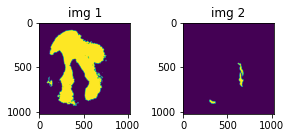

0.1569971889257431


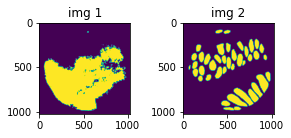

0.6732895374298096


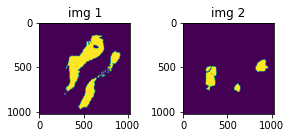

0.23133814334869385


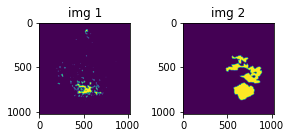

0.072627954185009


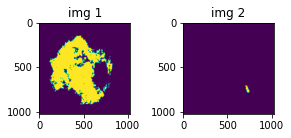

0.011151621118187904


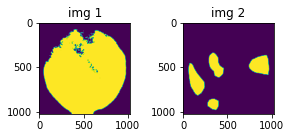

0.5276504755020142


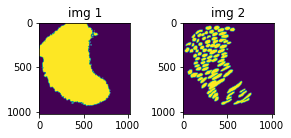

1.1138163805007935


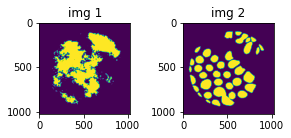

0.6336900591850281


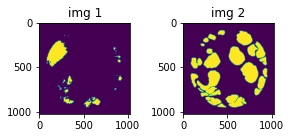

0.1755572259426117


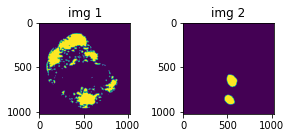

0.3916187286376953


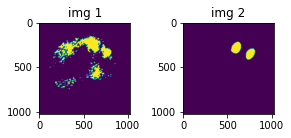

0.9058531522750854


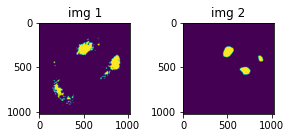

0.722915768623352


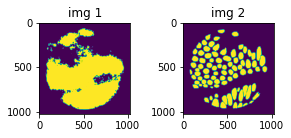

1.022464394569397


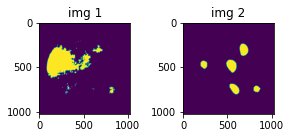

0.48232927918434143


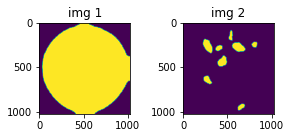

0.2360384315252304


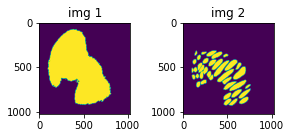

1.0969583988189697


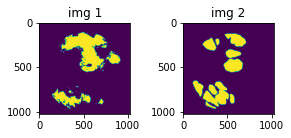

0.5999449491500854


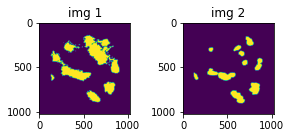

0.5934089422225952


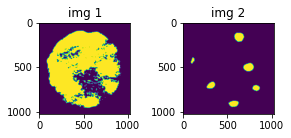

0.5781240463256836


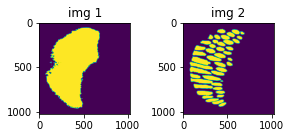

1.1884105205535889


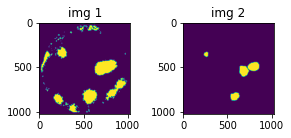

1.1336902379989624


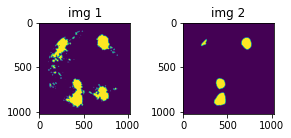

1.2437413930892944


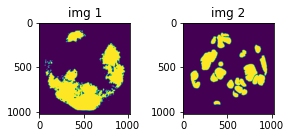

0.369830846786499


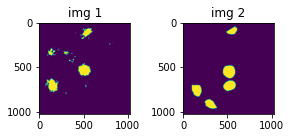

0.7056306600570679


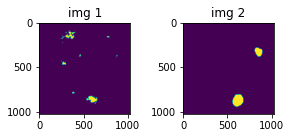

0.39575207233428955


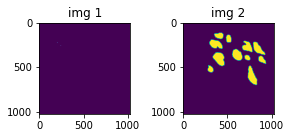

3.3464217267464846e-05


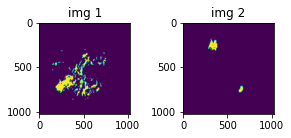

0.07763179391622543


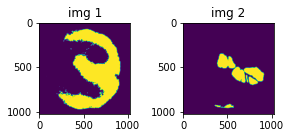

0.4036996364593506


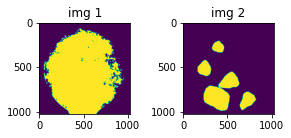

0.6670007705688477


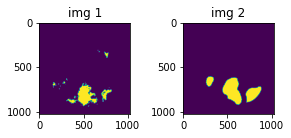

0.4836435317993164


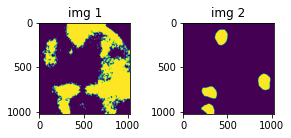

0.9361308813095093


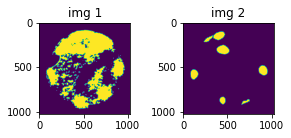

0.8148432970046997


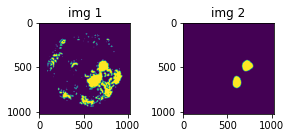

1.0086508989334106


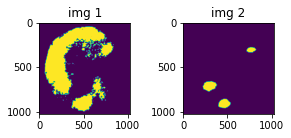

0.6797364950180054


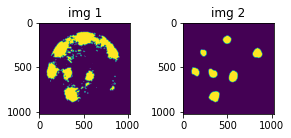

1.189171314239502


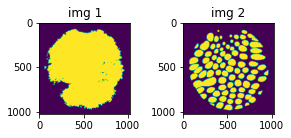

1.1704035997390747


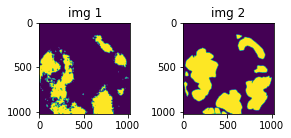

0.4895454943180084


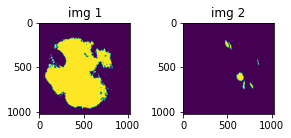

0.1286131739616394


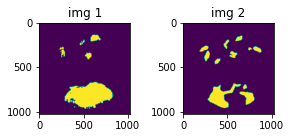

0.5640426874160767


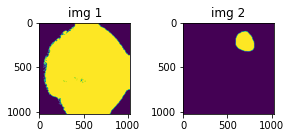

0.17372697591781616


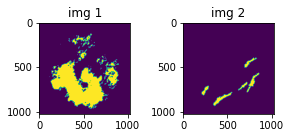

0.27424389123916626


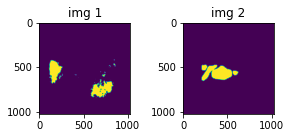

0.05153030902147293


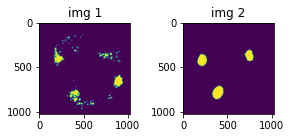

0.6736812591552734


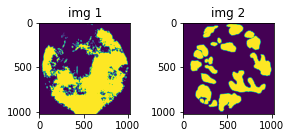

0.5470231771469116


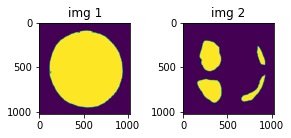

0.683569073677063


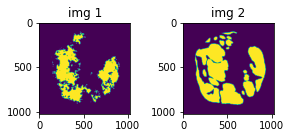

0.5362945795059204


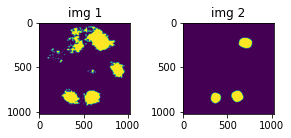

1.1898603439331055


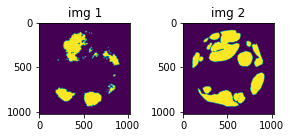

0.5035207271575928


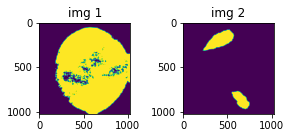

0.37877053022384644


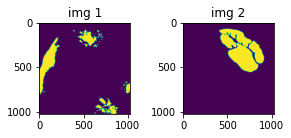

0.13355101644992828


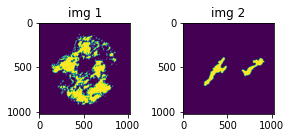

0.27310866117477417


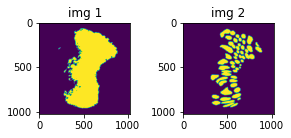

1.154586911201477


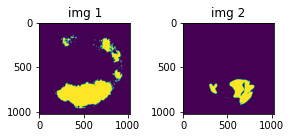

0.4469236135482788


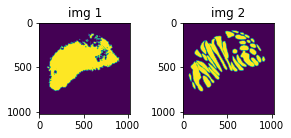

1.0640605688095093


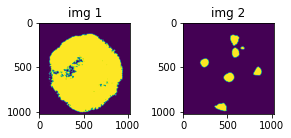

0.6310802698135376


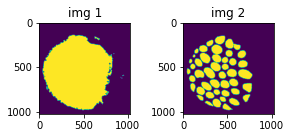

1.2210605144500732


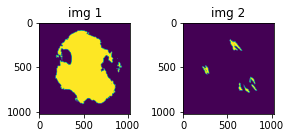

0.31653696298599243


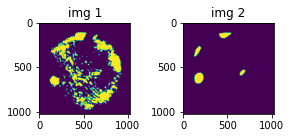

0.5754864811897278


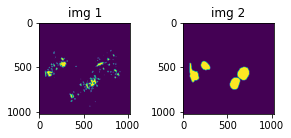

0.38237276673316956


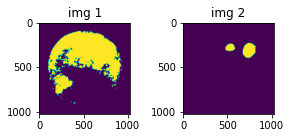

0.6289065480232239


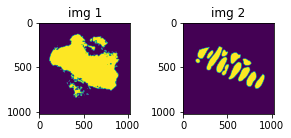

1.0278136730194092


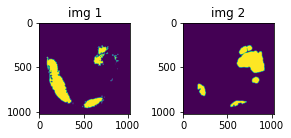

0.32472777366638184


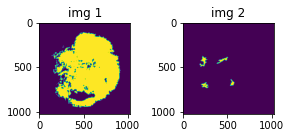

0.15042684972286224


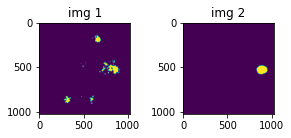

0.6244814395904541


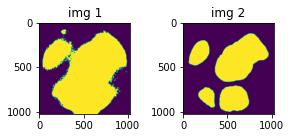

1.1180517673492432


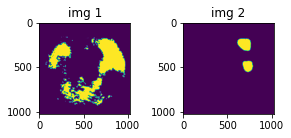

0.7013760209083557


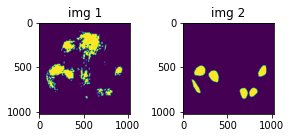

0.8443180322647095


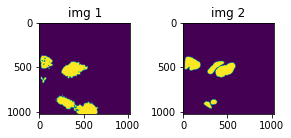

0.5585512518882751


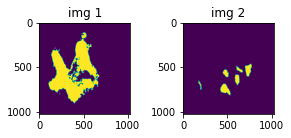

0.32871437072753906


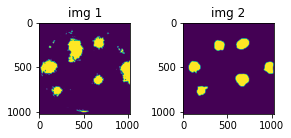

1.2430709600448608


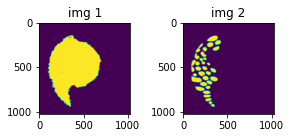

0.8153152465820312


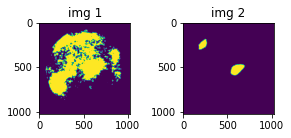

0.5601845383644104


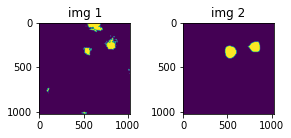

0.6946166157722473


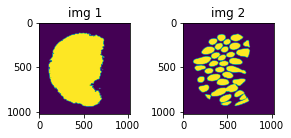

1.1831079721450806


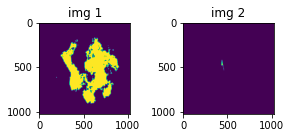

5.0528274186945055e-06


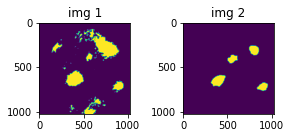

1.137116551399231


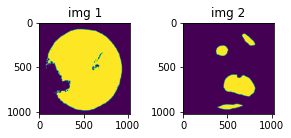

0.5180112719535828


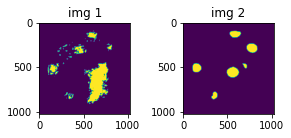

0.6058790683746338


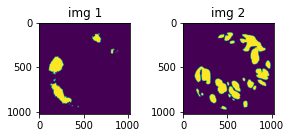

0.11532477289438248


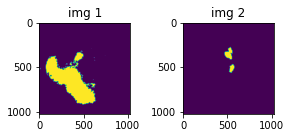

0.04031458497047424


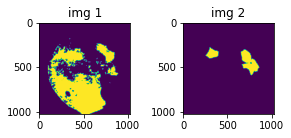

0.3455003499984741


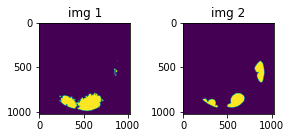

0.5452330708503723


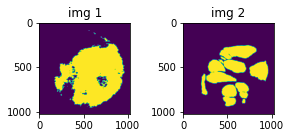

0.6854894161224365


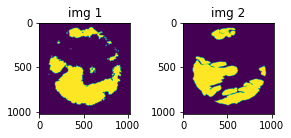

0.7314809560775757


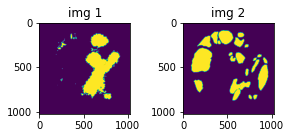

0.3611142039299011


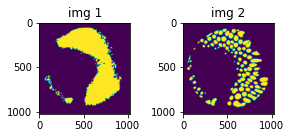

1.0569777488708496


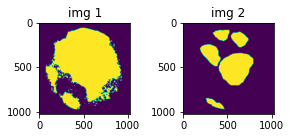

0.9051657915115356


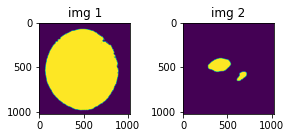

0.2204151153564453


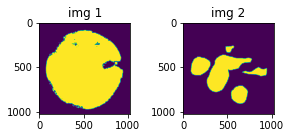

0.7918627858161926


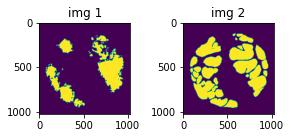

0.5785796046257019


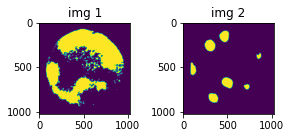

0.9788216948509216


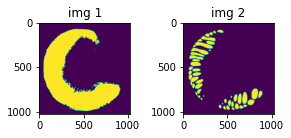

1.0058391094207764


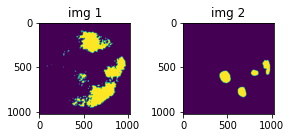

0.7232568860054016


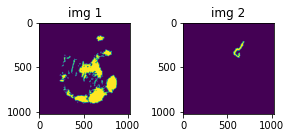

0.001074856729246676


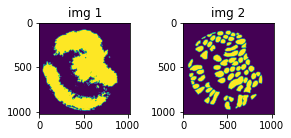

1.056648850440979


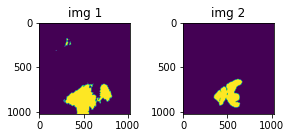

0.6007710099220276


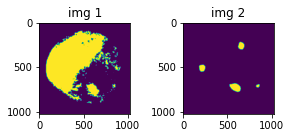

0.44051218032836914


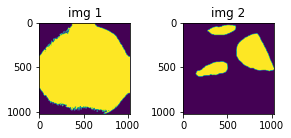

0.6116527318954468


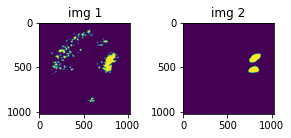

0.9300603270530701


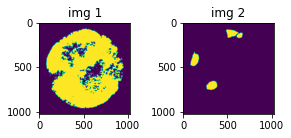

0.4917791783809662


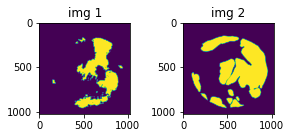

0.5184842348098755


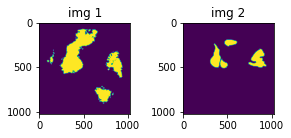

0.5001514554023743


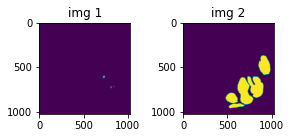

0.00615002540871501


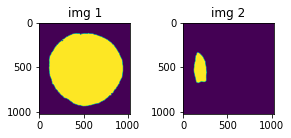

0.24862825870513916


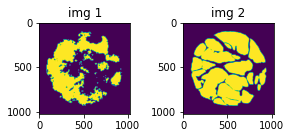

0.6572705507278442


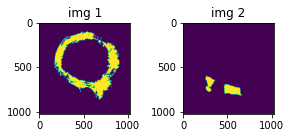

0.20957419276237488


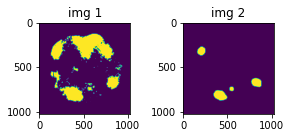

0.9488376975059509


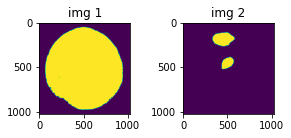

0.23863644897937775


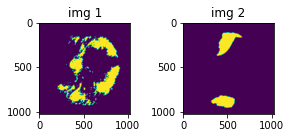

0.3790104389190674


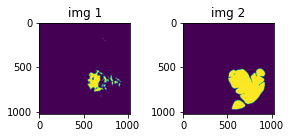

0.34714528918266296


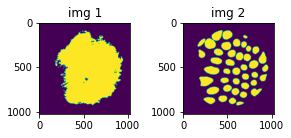

0.9844729900360107


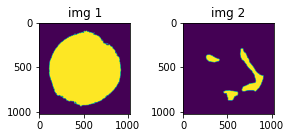

0.37759271264076233


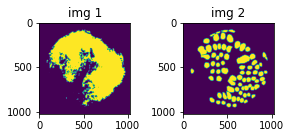

0.9899240136146545


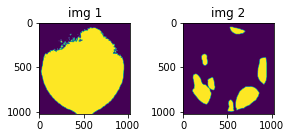

0.6172903180122375


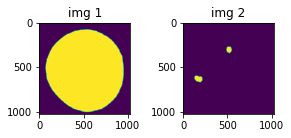

0.052210789173841476


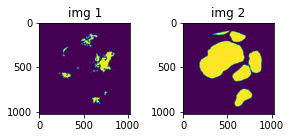

0.20482459664344788


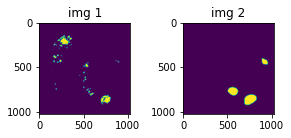

0.5154898762702942


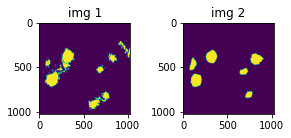

1.0909756422042847


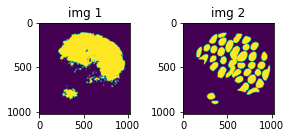

0.9223835468292236


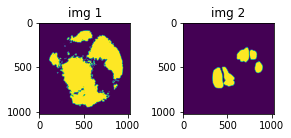

0.3799455165863037


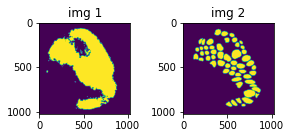

1.1401556730270386


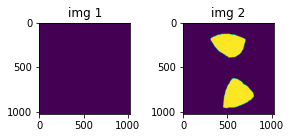

0.000950160960201174


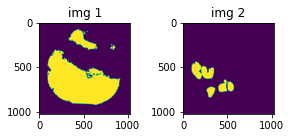

0.2837115526199341


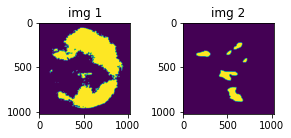

0.19827571511268616


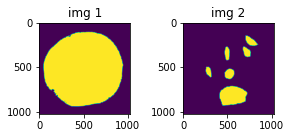

0.47616907954216003


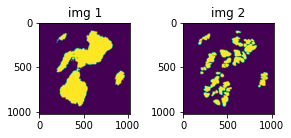

0.7222423553466797


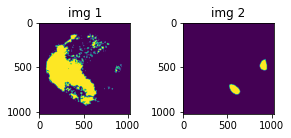

0.3509385287761688


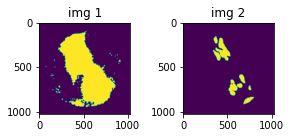

0.3250960111618042


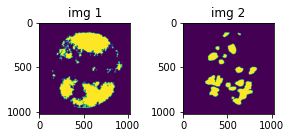

0.42263051867485046


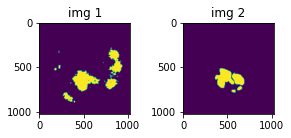

0.47125712037086487


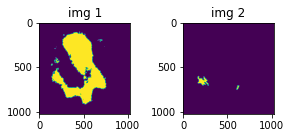

0.211308553814888


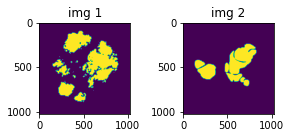

0.4590843617916107


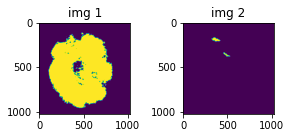

0.06162714958190918


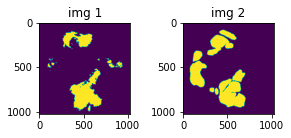

0.5817661285400391


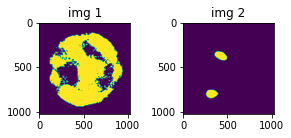

0.41939544677734375


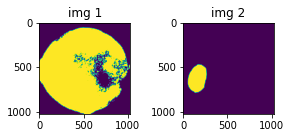

0.27491307258605957


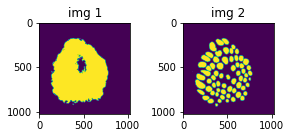

1.2143855094909668


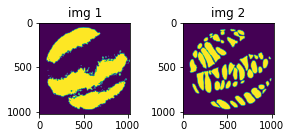

0.9251216053962708


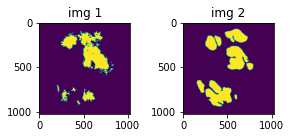

0.6075462698936462


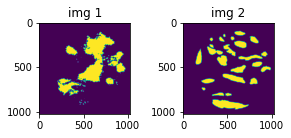

0.4634413421154022


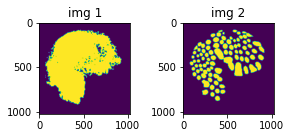

1.0975974798202515


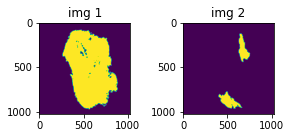

0.6089218258857727


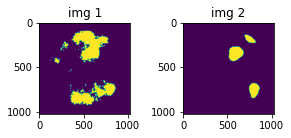

1.037275791168213


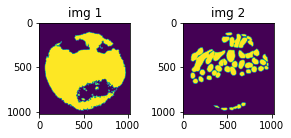

1.0633457899093628


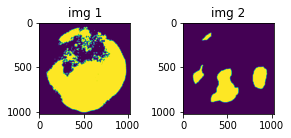

0.6772416234016418


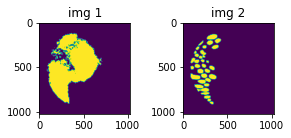

0.8017926216125488


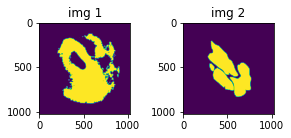

0.5557546019554138


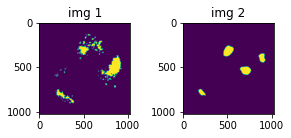

0.6346495747566223


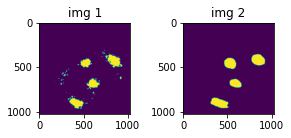

1.220424771308899


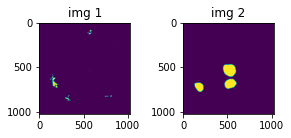

0.087677963078022


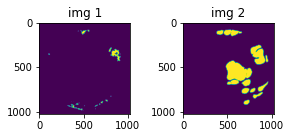

0.1318884938955307


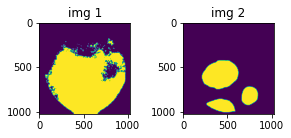

0.8366662859916687


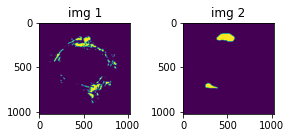

0.33768588304519653


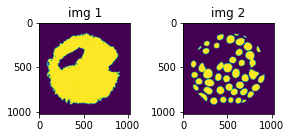

1.0877671241760254


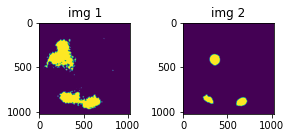

0.8554362058639526


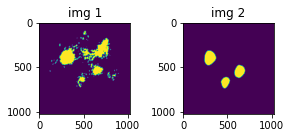

1.049696445465088


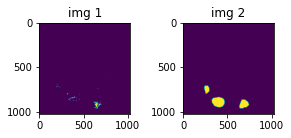

0.11446064710617065


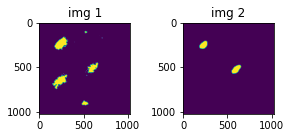

1.1674766540527344


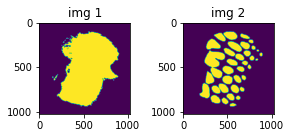

1.1044292449951172


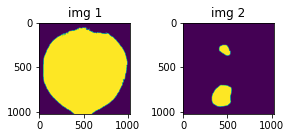

0.26755380630493164


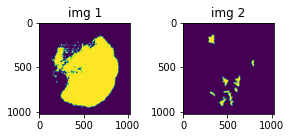

0.3302992880344391


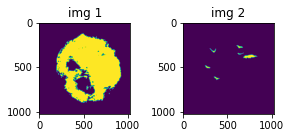

0.16859279572963715


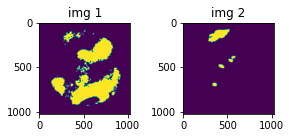

0.09380627423524857


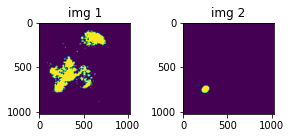

0.32486456632614136


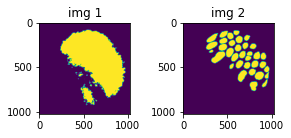

1.160086750984192


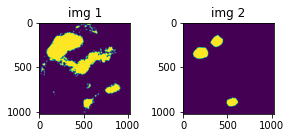

1.0270591974258423


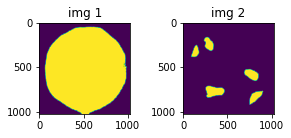

0.3161746561527252


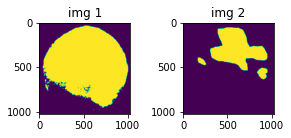

0.7658758163452148


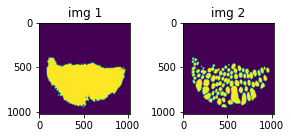

1.1633515357971191


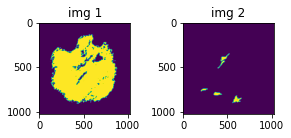

0.16935281455516815


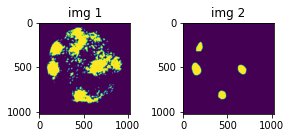

0.9089210629463196


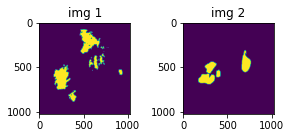

0.3077075779438019


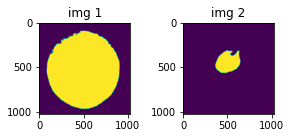

0.32332107424736023


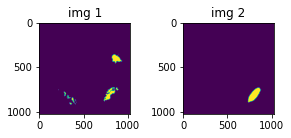

0.4618779420852661


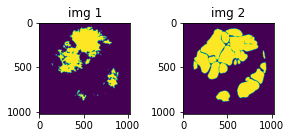

0.6018540859222412


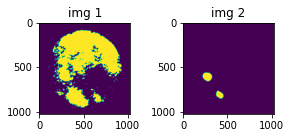

0.34505516290664673
FOLD: 0, EPOCH: 26, valid_loss: 0.6779688098891214 , Val Dice COE : 0.593036786912651


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 27, train_loss: 0.6039760059118271 , Dice coe : 0.5785459276327402 
0.15834909677505493
0.8541399836540222
0.6315665245056152
0.7242299914360046
0.034887488931417465
0.5890162587165833
1.1169452667236328
1.0457440614700317
0.6151754260063171
0.35137665271759033
0.32471027970314026
0.4870022237300873
0.991823673248291
0.8135719299316406
0.24424579739570618
1.097690463066101
0.609439492225647
0.38289111852645874
0.4570748805999756
1.1936382055282593
0.42733776569366455
0.6243367195129395
0.4077532887458801
0.6583171486854553
0.34045448899269104
0.19659548997879028
0.1396973580121994
0.5195678472518921
0.590100109577179
0.3389846086502075
0.8231272101402283
0.5894531607627869
0.32042568922042847
0.5339903831481934
0.8322213292121887
1.1708990335464478
0.6925194263458252
0.16952550411224365
0.5388023257255554
0.19237034022808075
0.3303634822368622
0.1571081131696701
0.4206255078315735
0.516214907169342
0.6856908798217773
0.7671239376068115
0.5939918160438538
0.7698117494583

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 28, train_loss: 0.5829773872239249 , Dice coe : 0.5897644211277995 
0.16162358224391937
0.9220382571220398
0.6628494262695312
0.4812288284301758
0.03219860419631004
0.9195924401283264
1.1373720169067383
1.0110713243484497
0.6383084058761597
0.32171136140823364
0.25903043150901794
0.4874495267868042
0.9629119038581848
0.7414500713348389
0.38279199600219727
1.1233854293823242
0.47120964527130127
0.46592724323272705
0.5624890327453613
1.2301104068756104
0.6243060231208801
0.42672473192214966
0.4244938790798187
0.5761176943778992
0.28198370337486267
0.16008086502552032
0.1175868883728981
0.48256853222846985
0.6316224932670593
0.38915497064590454
1.1541967391967773
0.6661632657051086
0.2079019844532013
0.5932096838951111
0.9590499401092529
1.0567781925201416
0.7644715905189514
0.17150558531284332
0.5771351456642151
0.37024161219596863
0.3147744834423065
0.0983663946390152
0.4421818256378174
0.5393601655960083
0.9705703258514404
0.7468001246452332
0.9475976824760437
0.7797278

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 29, train_loss: 0.5505136096477509 , Dice coe : 0.6308711914960856 
0.1526077538728714
0.8944317698478699
0.696675717830658
0.6011695861816406
0.036488525569438934
0.8304672837257385
1.1245495080947876
1.0548275709152222
0.6491848230361938
0.35458818078041077
0.34804245829582214
0.5186335444450378
1.0086467266082764
0.7343472242355347
0.3218594789505005
1.1066491603851318
0.6278804540634155
0.45231059193611145
0.5636948347091675
1.2262166738510132
0.6751891374588013
0.5512373447418213
0.4321537911891937
0.7137999534606934
0.3925016224384308
0.16490697860717773
0.1322469413280487
0.5186484456062317
0.6178171634674072
0.31951630115509033
1.0891900062561035
0.7653982043266296
0.2506410479545593
0.5748316049575806
0.9475120306015015
1.066558837890625
0.7668849229812622
0.17371124029159546
0.5774871706962585
0.3268297612667084
0.3437504470348358
0.12253542989492416
0.5301330089569092
0.552799642086029
0.777489185333252
0.7840456962585449
0.9102078080177307
0.7912008762359619

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 30, train_loss: 0.5876285777773176 , Dice coe : 0.6172891818037156 
0.1592402458190918
1.0158641338348389
0.8176934123039246
0.7665063142776489
0.03342043235898018
0.7767255902290344
1.1016443967819214
1.067711353302002
0.48355844616889954
0.3444894254207611
0.4336555302143097
0.8543813824653625
1.0395002365112305
0.851517379283905
0.255558043718338
1.1152504682540894
0.7994377613067627
0.6765502095222473
0.5001126527786255
1.2381566762924194
0.5876787304878235
0.9565725326538086
0.4759852886199951
0.9726394414901733
0.6938536763191223
0.2212148904800415
0.09529436379671097
0.6041786074638367
0.8016182780265808
0.4426172375679016
1.015051245689392
0.939530074596405
0.5515802502632141
0.5762783288955688
1.1074215173721313
1.0814220905303955
0.7770069241523743
0.16837488114833832
0.6212015748023987
0.17848272621631622
0.3590176999568939
0.1593567579984665
0.5008270144462585
0.5529820322990417
0.8784440159797668
0.7015684843063354
1.0319775342941284
0.7582017779350281
0.52

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 31, train_loss: 0.5865732190438679 , Dice coe : 0.645542828667372 


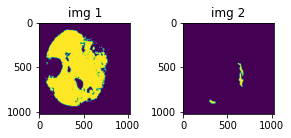

0.16734476387500763


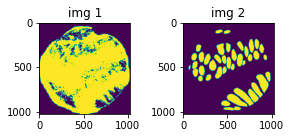

0.9329489469528198


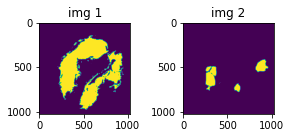

0.7774815559387207


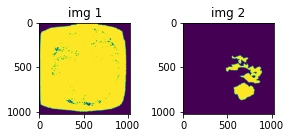

0.5060662627220154


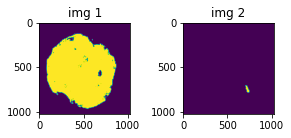

0.03521805629134178


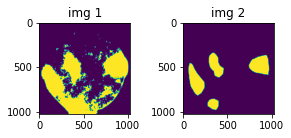

0.8856704831123352


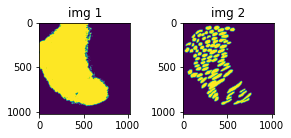

1.126060962677002


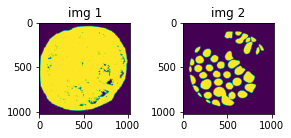

0.9615440964698792


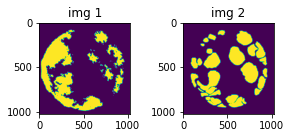

0.5407190918922424


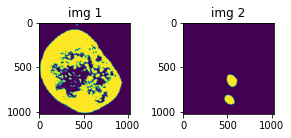

0.28734248876571655


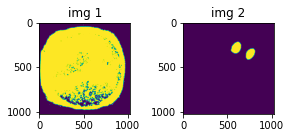

0.2592814862728119


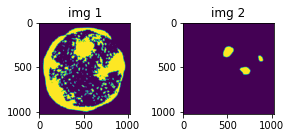

0.5006049275398254


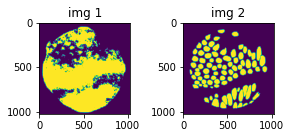

1.030232310295105


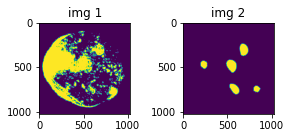

0.7223281860351562


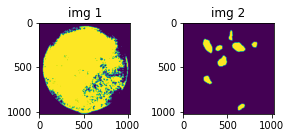

0.2858160436153412


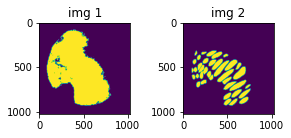

1.1227742433547974


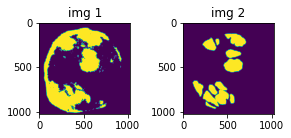

0.6687304973602295


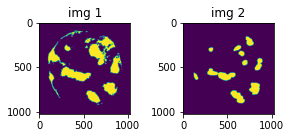

0.6442223787307739


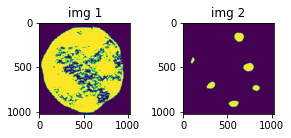

0.47951433062553406


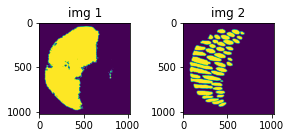

1.2433602809906006


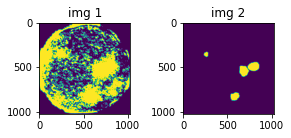

0.5330856442451477


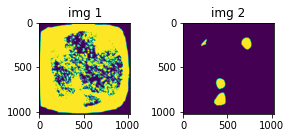

0.4256211519241333


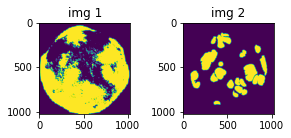

0.41877254843711853


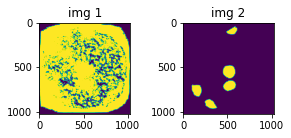

0.5199950933456421


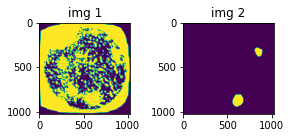

0.2758687436580658


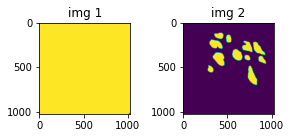

0.1575097292661667


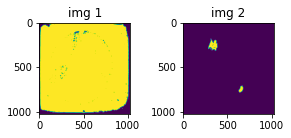

0.08368435502052307


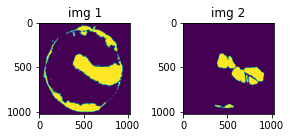

0.5974545478820801


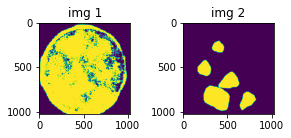

0.5809051990509033


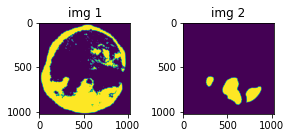

0.32269129157066345


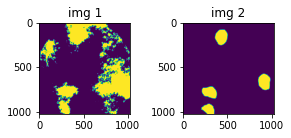

1.083619236946106


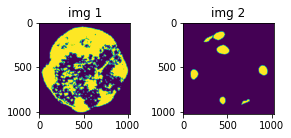

0.7413520216941833


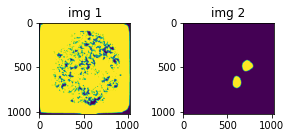

0.2098686546087265


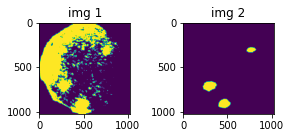

0.5806675553321838


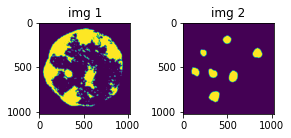

1.055598497390747


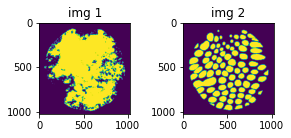

1.0963464975357056


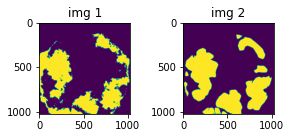

0.7664554119110107


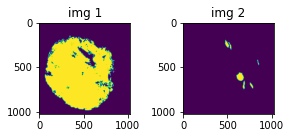

0.167002335190773


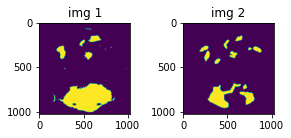

0.6161130666732788


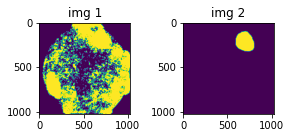

0.26635757088661194


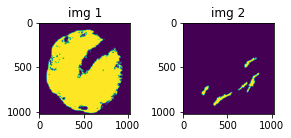

0.3247987926006317


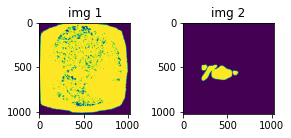

0.09586253017187119


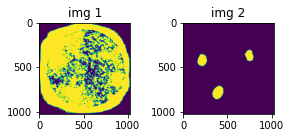

0.38922587037086487


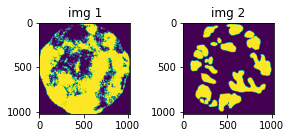

0.5502502918243408


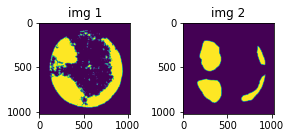

0.9718121290206909


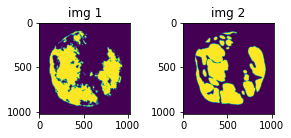

0.7580625414848328


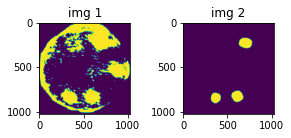

0.793231189250946


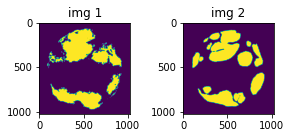

0.7919024229049683


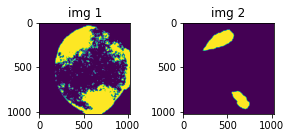

0.6843453645706177


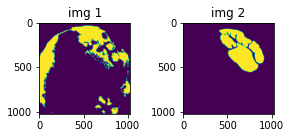

0.4231245219707489


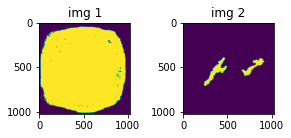

0.3205040991306305


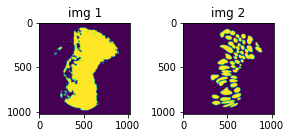

1.1285455226898193


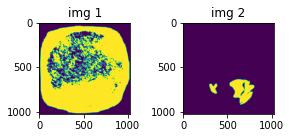

0.1506742388010025


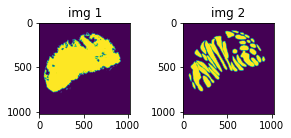

1.1518734693527222


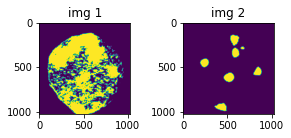

0.7871764302253723


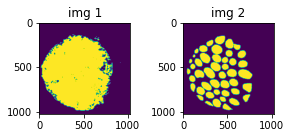

1.2295771837234497


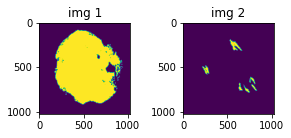

0.26695504784584045


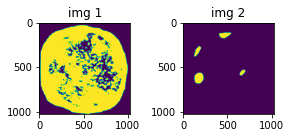

0.3030269145965576


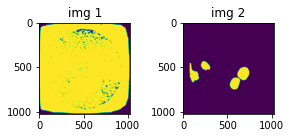

0.3959808051586151


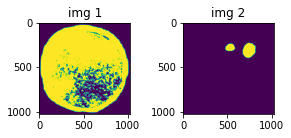

0.3422502875328064


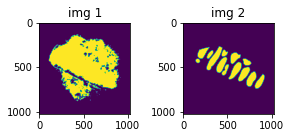

0.9663634896278381


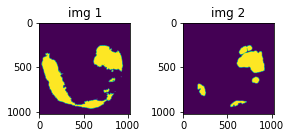

0.5573523640632629


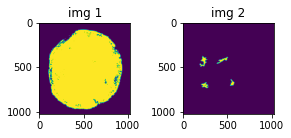

0.14743342995643616


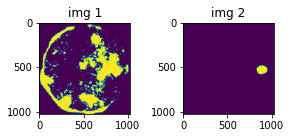

0.3136405050754547


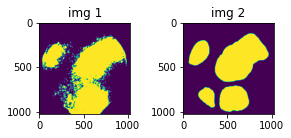

1.1090073585510254


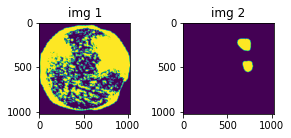

0.4675069749355316


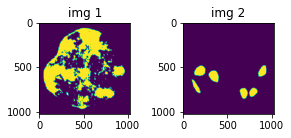

0.9287394285202026


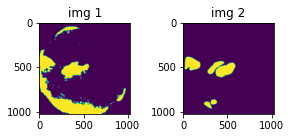

0.44165125489234924


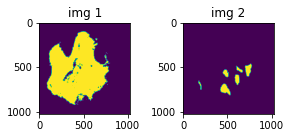

0.4772319197654724


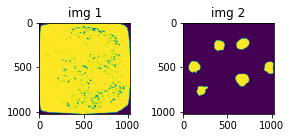

0.5582471489906311


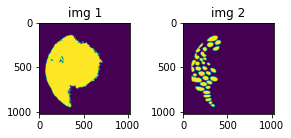

0.8626822829246521


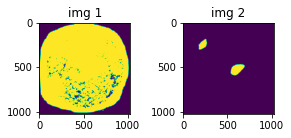

0.22882691025733948


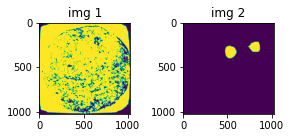

0.2587093710899353


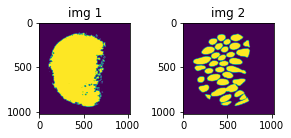

1.1859421730041504


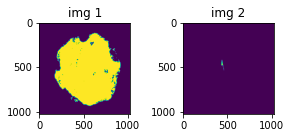

0.014913486316800117


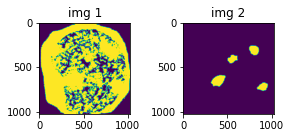

0.4492619037628174


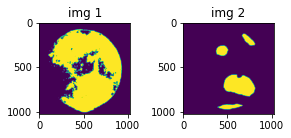

0.6035982370376587


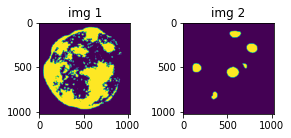

0.7741948962211609


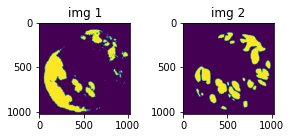

0.42685359716415405


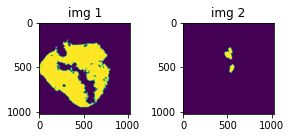

0.22998732328414917


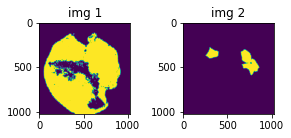

0.525989294052124


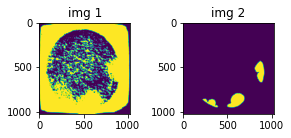

0.13450922071933746


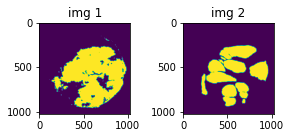

0.7383354902267456


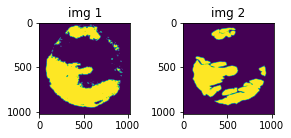

0.7951294779777527


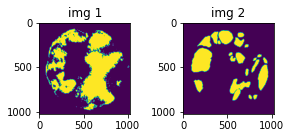

0.5011340379714966


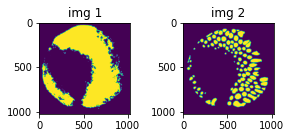

1.0694588422775269


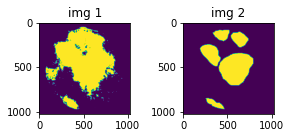

1.0533161163330078


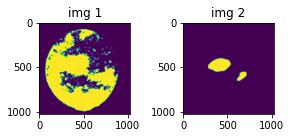

0.3290407955646515


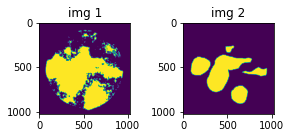

1.0206636190414429


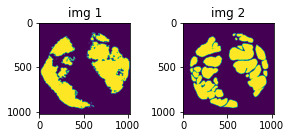

0.7727668881416321


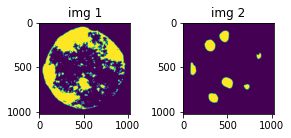

1.0127416849136353


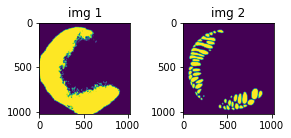

0.9910632967948914


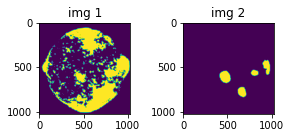

0.6821624636650085


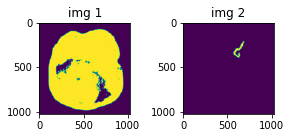

0.07878777384757996


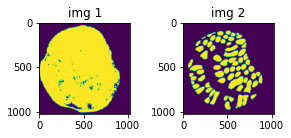

1.0925754308700562


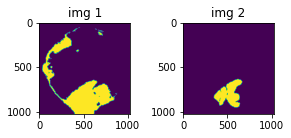

0.4609745740890503


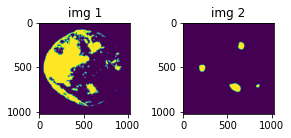

0.4846033751964569


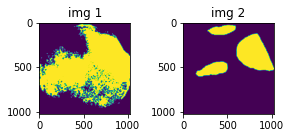

0.7451664805412292


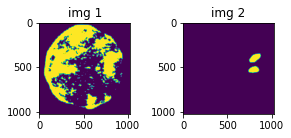

0.39140191674232483


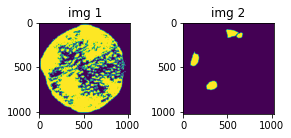

0.4888063669204712


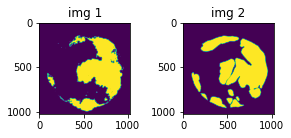

0.7880756258964539


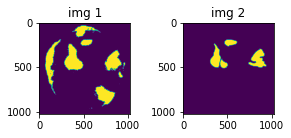

0.511393666267395


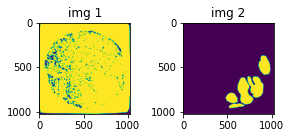

0.1903720200061798


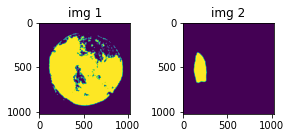

0.30745166540145874


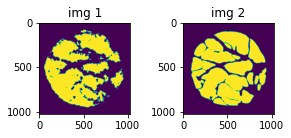

0.8275023102760315


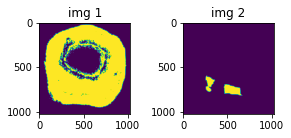

0.3463112711906433


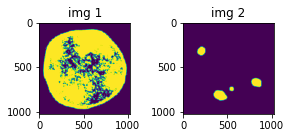

0.4632374346256256


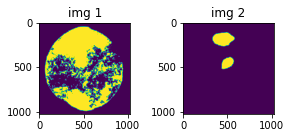

0.3656967580318451


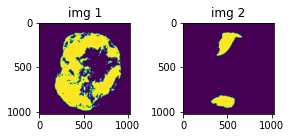

0.7737374901771545


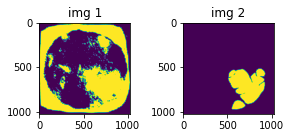

0.39331918954849243


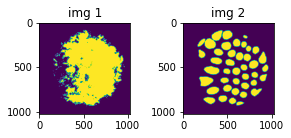

1.0062795877456665


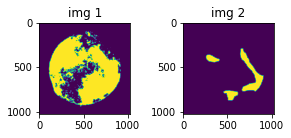

0.5112869739532471


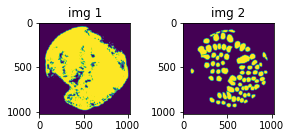

1.0220476388931274


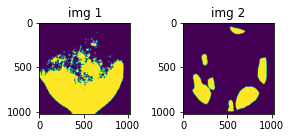

0.7529910206794739


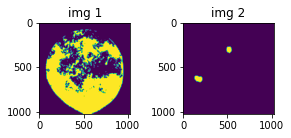

0.08162147551774979


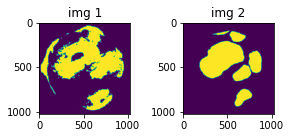

0.7509329915046692


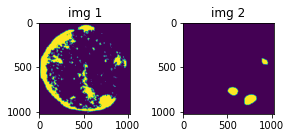

0.7229201793670654


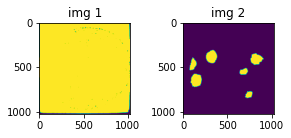

0.44476252794265747


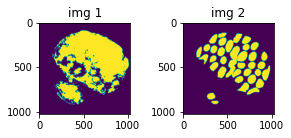

1.093366026878357


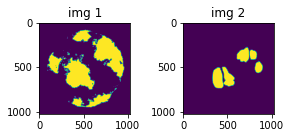

0.4638840854167938


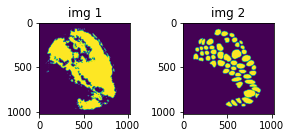

1.074410319328308


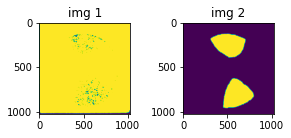

0.4306957423686981


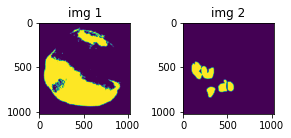

0.3295111060142517


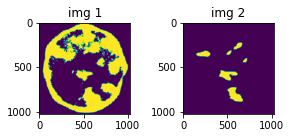

0.20720438659191132


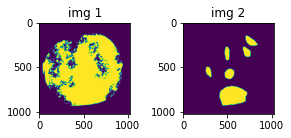

0.593553900718689


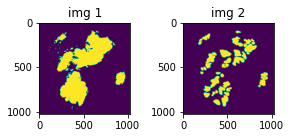

0.7039740681648254


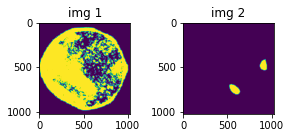

0.29045000672340393


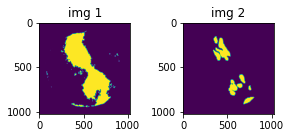

0.45959168672561646


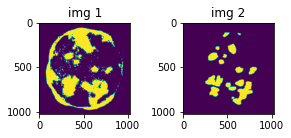

0.5216066837310791


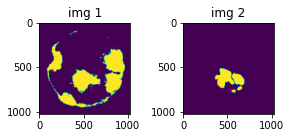

0.32357603311538696


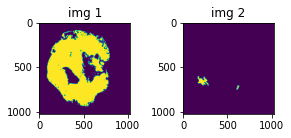

0.1535930186510086


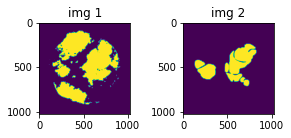

0.48772773146629333


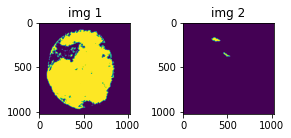

0.06645652651786804


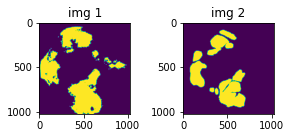

0.6971927881240845


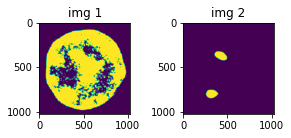

0.35552799701690674


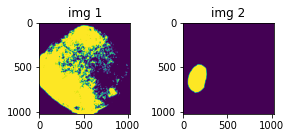

0.36551302671432495


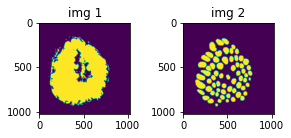

1.222529411315918


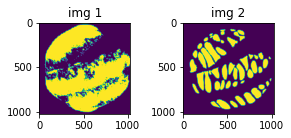

0.9485535025596619


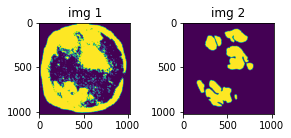

0.5056644082069397


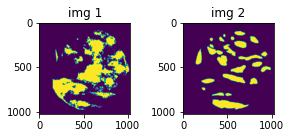

0.5103864669799805


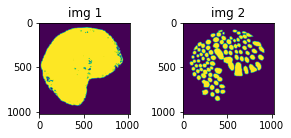

1.106950283050537


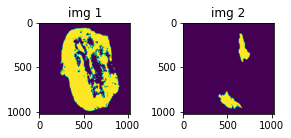

0.5917584896087646


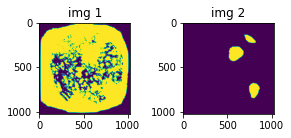

0.4695146679878235


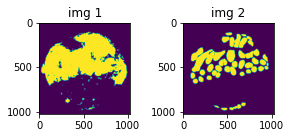

1.198793649673462


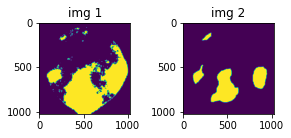

0.8936263918876648


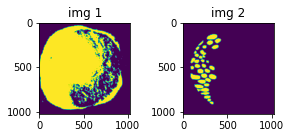

0.6141726970672607


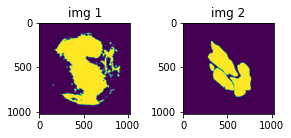

0.6046295762062073


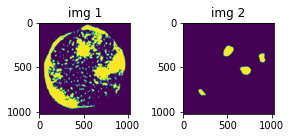

0.7062333226203918


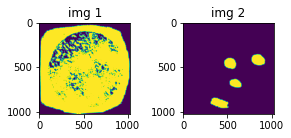

0.5317784547805786


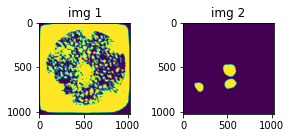

0.3706683814525604


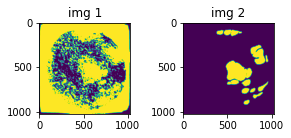

0.2500945031642914


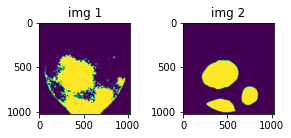

1.066879391670227


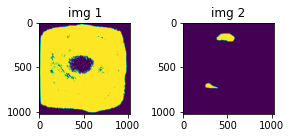

0.17071357369422913


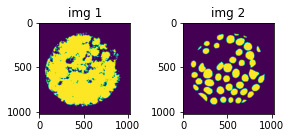

1.0847184658050537


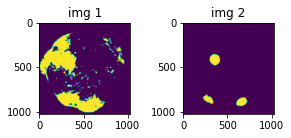

0.8044875264167786


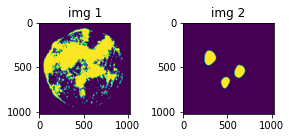

0.781705915927887


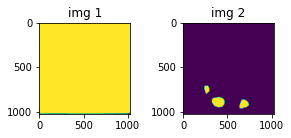

0.21300575137138367


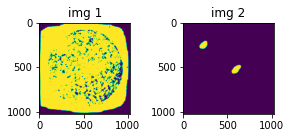

0.1401463747024536


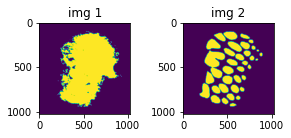

1.1021322011947632


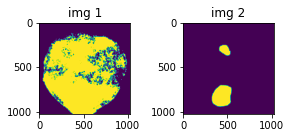

0.33858567476272583


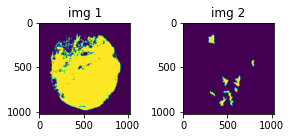

0.29580047726631165


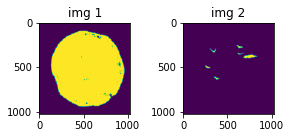

0.11010676622390747


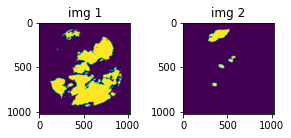

0.09474395960569382


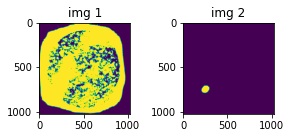

0.08111656457185745


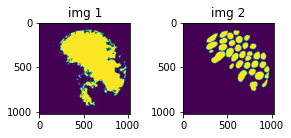

1.1241213083267212


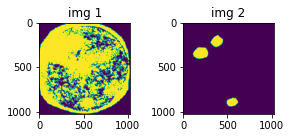

0.471981406211853


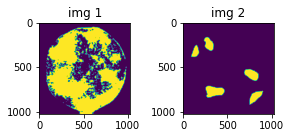

0.45649680495262146


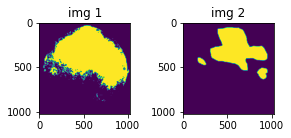

0.9855008125305176


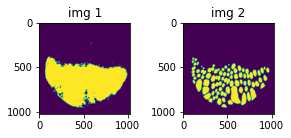

1.1784251928329468


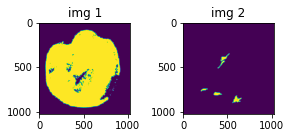

0.1632087081670761


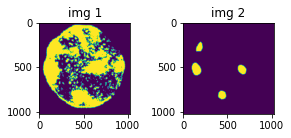

0.6204341650009155


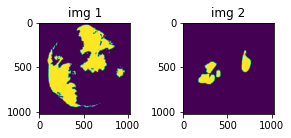

0.26134830713272095


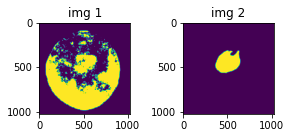

0.369373619556427


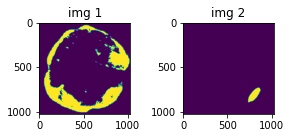

0.12141987681388855


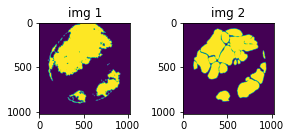

0.8080928921699524


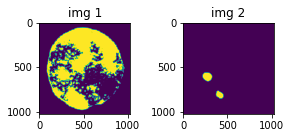

0.30731508135795593
FOLD: 0, EPOCH: 31, valid_loss: 0.6903732350434769 , Val Dice COE : 0.5821657465157014


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 32, train_loss: 0.5714125972986221 , Dice coe : 0.6303463729643837 
0.16795283555984497
0.8059639930725098
0.7250919938087463
0.7685442566871643
0.04043499007821083
0.812565267086029
1.1236335039138794
1.0490761995315552
0.6659658551216125
0.316150039434433
0.501620352268219
0.6373629570007324
1.0511113405227661
0.8058100342750549
0.25189340114593506
1.1250429153442383
0.7169263362884521
0.5591235756874084
0.5540621280670166
1.2434396743774414
0.5250532627105713
0.8112198114395142
0.43457159399986267
0.8913978934288025
0.7119013667106628
0.16186748445034027
0.16203738749027252
0.48602449893951416
0.46373024582862854
0.36509969830513
1.0809369087219238
0.9004902243614197
0.5391605496406555
0.5746891498565674
0.9986696839332581
1.1081559658050537
0.7263870239257812
0.16789467632770538
0.6067765355110168
0.22222740948200226
0.3511747419834137
0.18322594463825226
0.7729486227035522
0.5778529047966003
0.8917027115821838
0.7565581798553467
0.9206066131591797
0.799041807651519

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 33, train_loss: 0.5872575483364718 , Dice coe : 0.6397516192187179 
0.17307862639427185
0.8708614706993103
0.8001132011413574
0.7134663462638855
0.03411172330379486
1.014435052871704
1.1285475492477417
1.0730218887329102
0.5903930068016052
0.3529210388660431
0.49896034598350525
0.5982394218444824
1.0216388702392578
0.7855982780456543
0.25862669944763184
1.1291102170944214
0.726347029209137
0.6788954734802246
0.5261557698249817
1.2550660371780396
0.3875218331813812
0.6433767080307007
0.47344475984573364
0.6058686375617981
0.44129708409309387
0.1585092842578888
0.1383591592311859
0.5415081977844238
0.39877352118492126
0.27870649099349976
1.2334543466567993
1.0766005516052246
0.39944374561309814
0.5304280519485474
1.0487775802612305
0.830210268497467
0.7675928473472595
0.16554494202136993
0.6760538220405579
0.2624400556087494
0.36287593841552734
0.1297507882118225
0.5179383754730225
0.5615667700767517
0.9301412105560303
0.6698662638664246
0.8988186717033386
0.7658899426460

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 34, train_loss: 0.589256779551506 , Dice coe : 0.6454225588755136 
0.1615266650915146
0.9290273785591125
0.6520174145698547
0.5518655776977539
0.03628192096948624
0.9721558690071106
1.1123051643371582
1.0201342105865479
0.5853545665740967
0.3232094943523407
0.3722692131996155
0.3607434034347534
1.082908272743225
0.6345377564430237
0.2549331486225128
1.123823881149292
0.5558576583862305
0.5192862153053284
0.46953284740448
1.2559475898742676
0.3329170346260071
0.4029843807220459
0.46274206042289734
0.4933423399925232
0.2480642944574356
0.15758012235164642
0.11014091968536377
0.3965296149253845
0.44932833313941956
0.18357162177562714
1.2120057344436646
0.9806311130523682
0.23297512531280518
0.4533758759498596
0.9033119082450867
0.950506329536438
0.8023585677146912
0.1739835888147354
0.585824728012085
0.24589575827121735
0.3395337164402008
0.10167514532804489
0.39614468812942505
0.576977014541626
0.9008188843727112
0.7333200573921204
0.769501268863678
0.7538573145866394
0.6

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 35, train_loss: 0.5739031586476735 , Dice coe : 0.6526373313613242 
0.1781553328037262
0.9960736036300659
0.6753990054130554
0.588553786277771
0.03358862176537514
1.079415202140808
1.1310923099517822
1.0551543235778809
0.5660803914070129
0.3163434863090515
0.41361382603645325
0.39851245284080505
1.0554066896438599
0.706310510635376
0.3172045052051544
1.1235828399658203
0.5978221297264099
0.6320511698722839
0.5816050171852112
1.2402106523513794
0.386031836271286
0.46570611000061035
0.5620362162590027
0.5479651093482971
0.31997770071029663
0.15785351395606995
0.12239232659339905
0.5371074080467224
0.33872875571250916
0.18411700427532196
1.031845211982727
0.9380541443824768
0.2850704491138458
0.5498113632202148
1.0888540744781494
0.7725552320480347
0.7673249840736389
0.1765589714050293
0.6517729759216309
0.3677486479282379
0.35986265540122986
0.10755237936973572
0.3998088240623474
0.5475533604621887
0.7666014432907104
0.6450515389442444
0.9975129961967468
0.748812139034271

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 36, train_loss: 0.5741485581227711 , Dice coe : 0.6943190082810348 


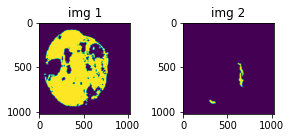

0.16572418808937073


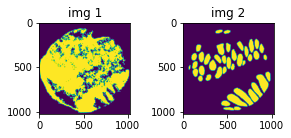

1.003493070602417


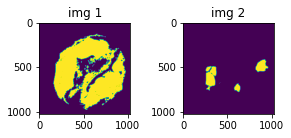

0.6282998323440552


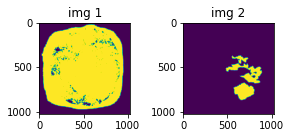

0.5814657211303711


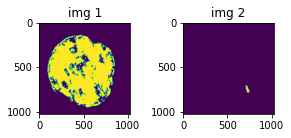

0.03427454084157944


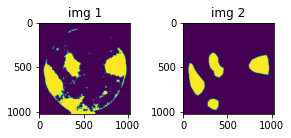

1.0787274837493896


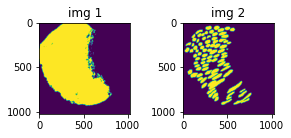

1.1213295459747314


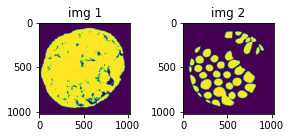

1.0325260162353516


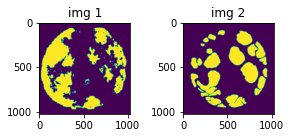

0.5594787001609802


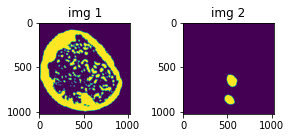

0.2883516848087311


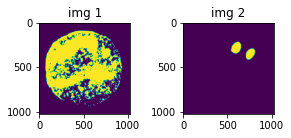

0.4104425609111786


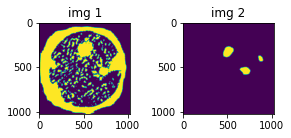

0.3923207223415375


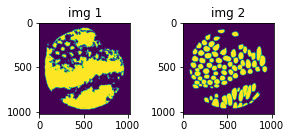

1.0734474658966064


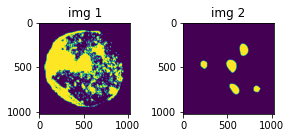

0.7300313115119934


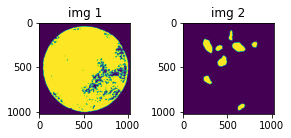

0.267801970243454


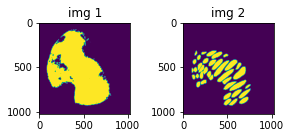

1.1365209817886353


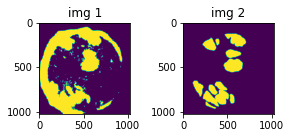

0.5745850801467896


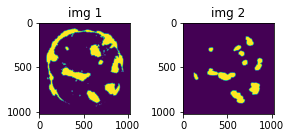

0.5745452642440796


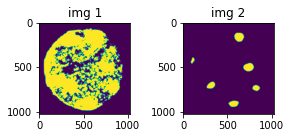

0.5481337904930115


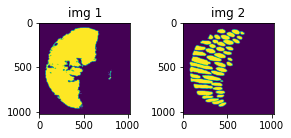

1.2628508806228638


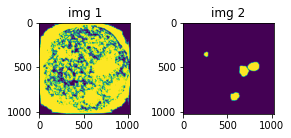

0.34382301568984985


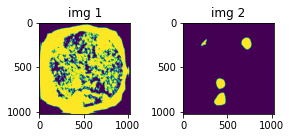

0.460187703371048


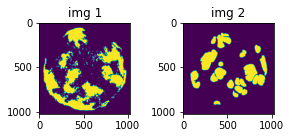

0.5564771890640259


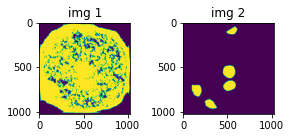

0.5441752672195435


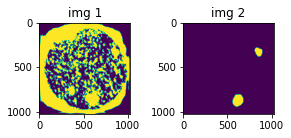

0.31466925144195557


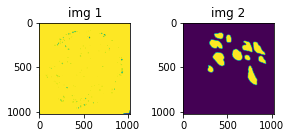

0.1580498218536377


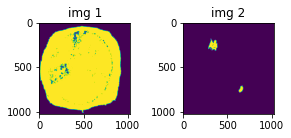

0.11313381046056747


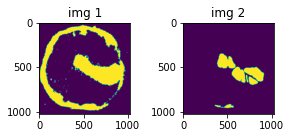

0.4658871293067932


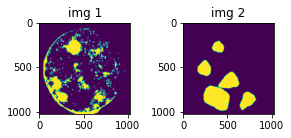

0.3783220648765564


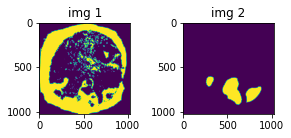

0.17860883474349976


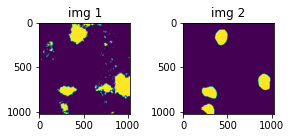

1.1681941747665405


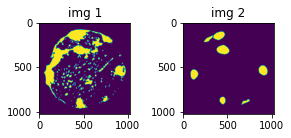

1.0533618927001953


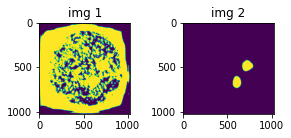

0.2798243463039398


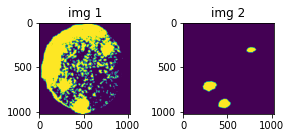

0.5369538068771362


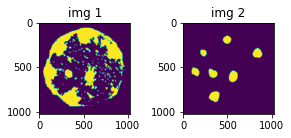

1.0416462421417236


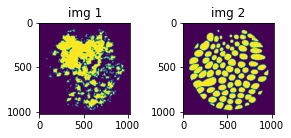

0.7748913168907166


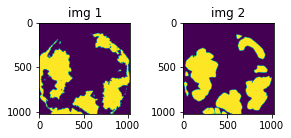

0.7910779714584351


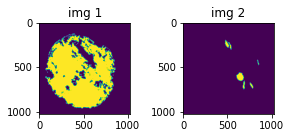

0.16966019570827484


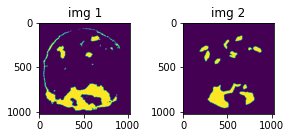

0.587963342666626


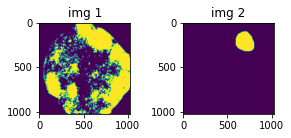

0.31068432331085205


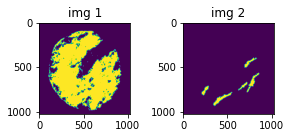

0.36050310730934143


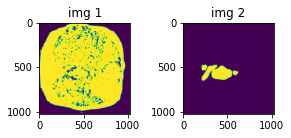

0.10190436244010925


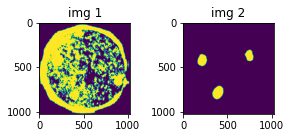

0.392901748418808


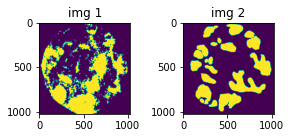

0.5764038562774658


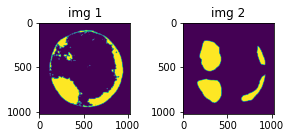

0.8193653225898743


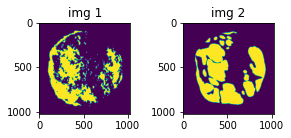

0.6740458607673645


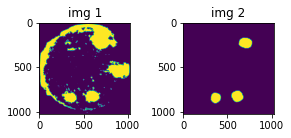

0.9512004256248474


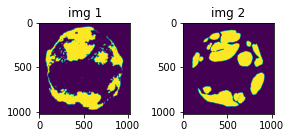

0.7481997609138489


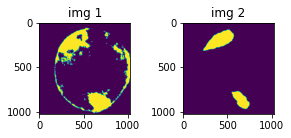

0.8626607656478882


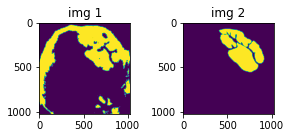

0.5460656881332397


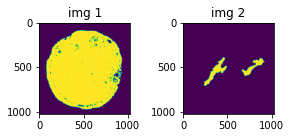

0.4034636616706848


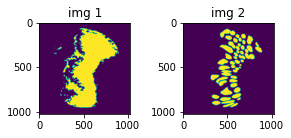

1.0902396440505981


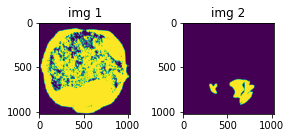

0.1641315370798111


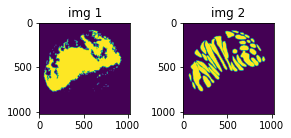

1.0522358417510986


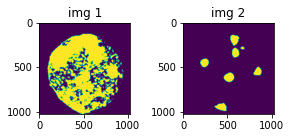

0.7464460134506226


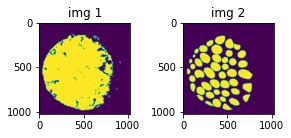

1.2218914031982422


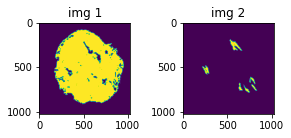

0.2530914545059204


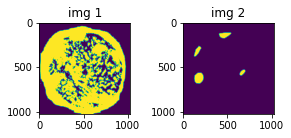

0.3335375189781189


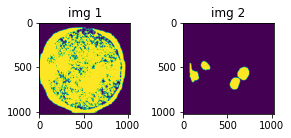

0.5383854508399963


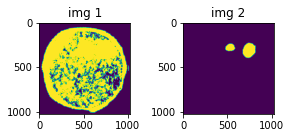

0.36937350034713745


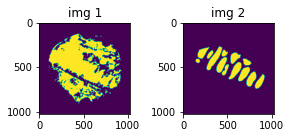

0.8952563405036926


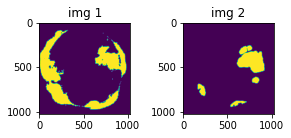

0.42459315061569214


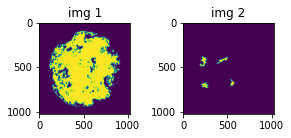

0.18118199706077576


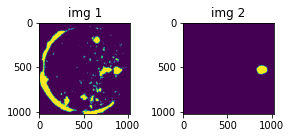

0.42251110076904297


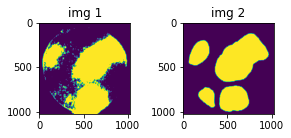

1.108750343322754


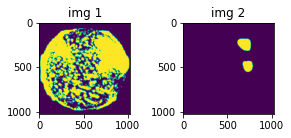

0.4500950872898102


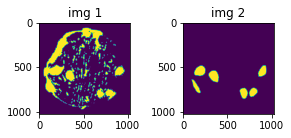

1.0494059324264526


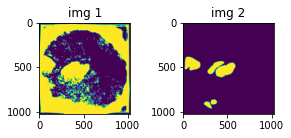

0.2254740446805954


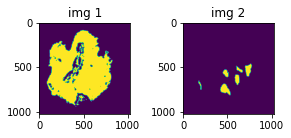

0.4618520736694336


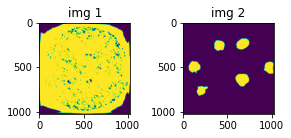

0.5902715921401978


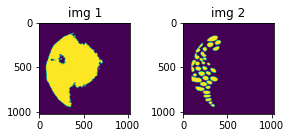

0.8588046431541443


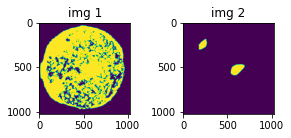

0.3102860748767853


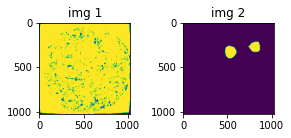

0.2273423969745636


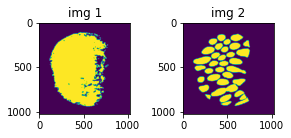

1.1650136709213257


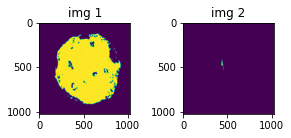

0.015385150909423828


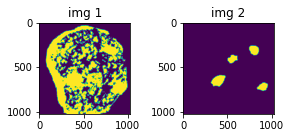

0.5603634119033813


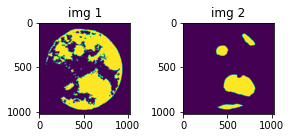

0.7330103516578674


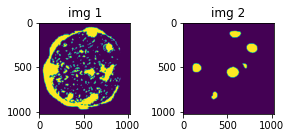

0.7943084239959717


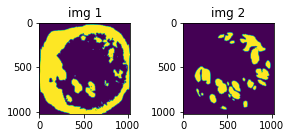

0.30894380807876587


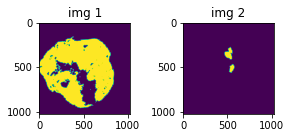

0.2022550106048584


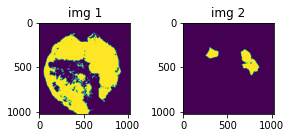

0.6009247303009033


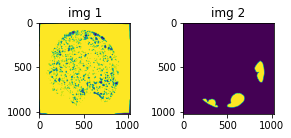

0.08500383049249649


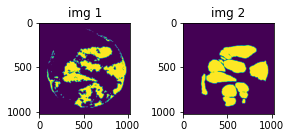

0.6963122487068176


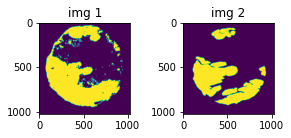

0.7744729518890381


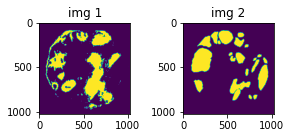

0.4747033417224884


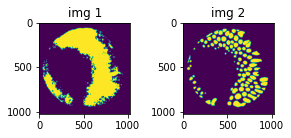

1.035452127456665


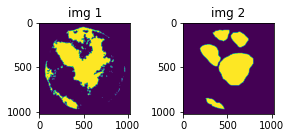

1.0726438760757446


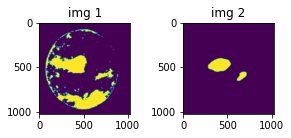

0.5610832571983337


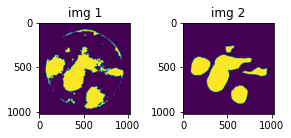

1.0978431701660156


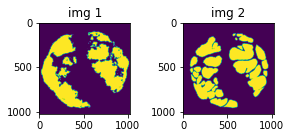

0.7552207112312317


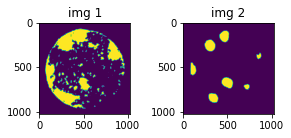

1.1132581233978271


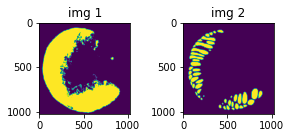

0.9930959939956665


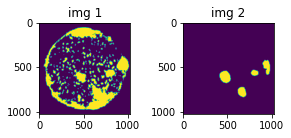

0.8102016448974609


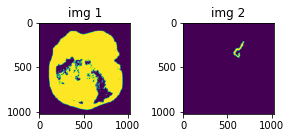

0.08769410848617554


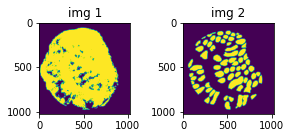

1.1257380247116089


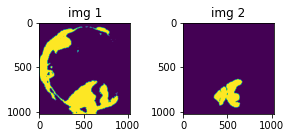

0.3799351751804352


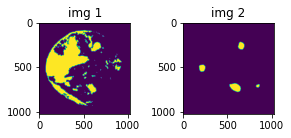

0.5335647463798523


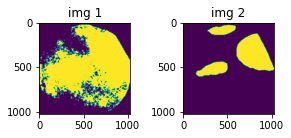

0.7479856610298157


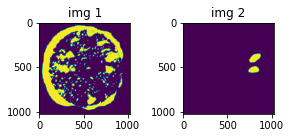

0.43623220920562744


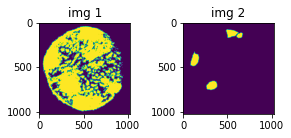

0.4964292645454407


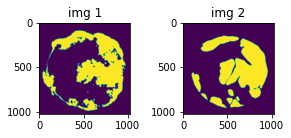

0.7417702674865723


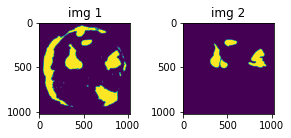

0.43120941519737244


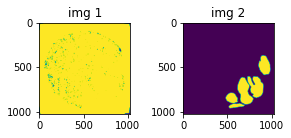

0.1791016012430191


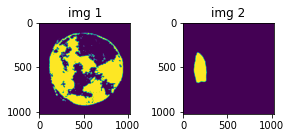

0.3908454477787018


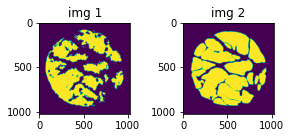

0.7741701602935791


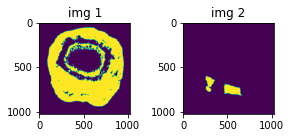

0.42932912707328796


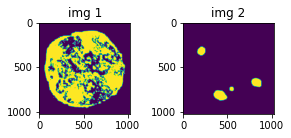

0.5488790273666382


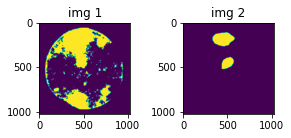

0.5090898871421814


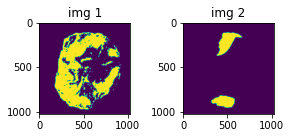

0.8026411533355713


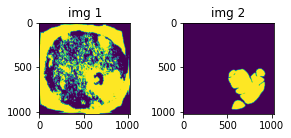

0.31989869475364685


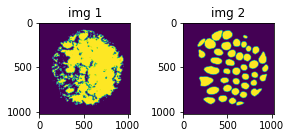

1.0100970268249512


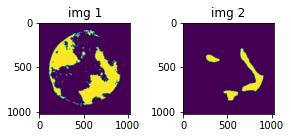

0.7226448655128479


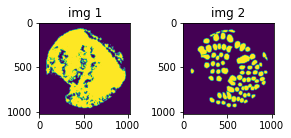

1.0252472162246704


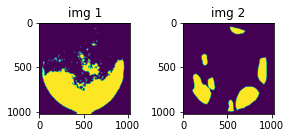

0.8318902850151062


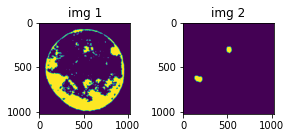

0.12687355279922485


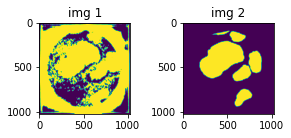

0.46911710500717163


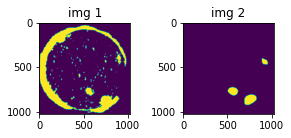

0.6509022116661072


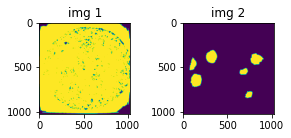

0.4610813558101654


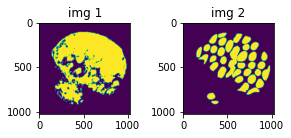

1.114117980003357


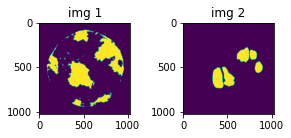

0.5126054286956787


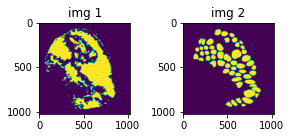

0.9516681432723999


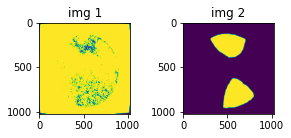

0.3850383758544922


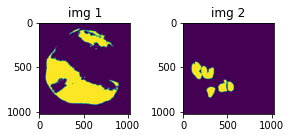

0.36328086256980896


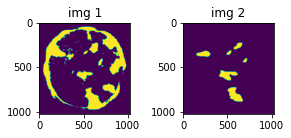

0.3047308027744293


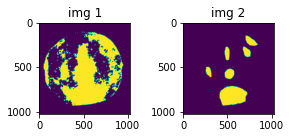

0.7100750803947449


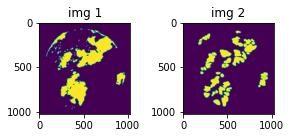

0.7524157762527466


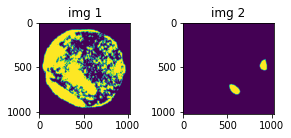

0.36460328102111816


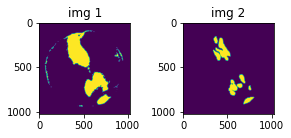

0.5975204110145569


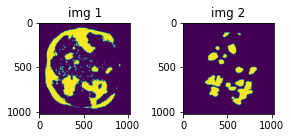

0.49962514638900757


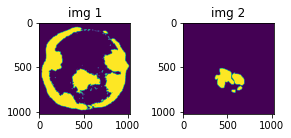

0.2205597311258316


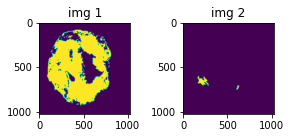

0.15837810933589935


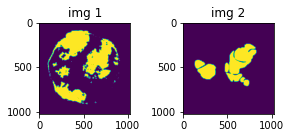

0.4119175970554352


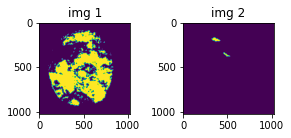

0.09216149151325226


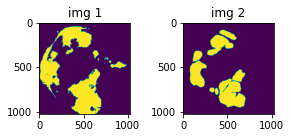

0.6861640810966492


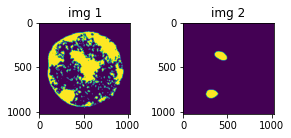

0.5741011500358582


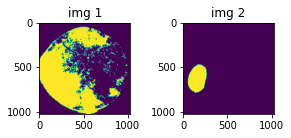

0.41399484872817993


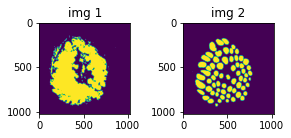

1.2164164781570435


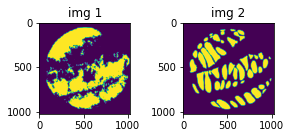

0.9247848391532898


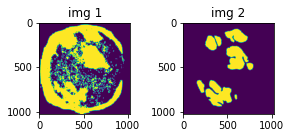

0.497264564037323


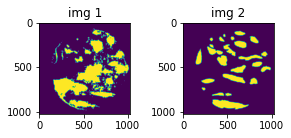

0.5205814242362976


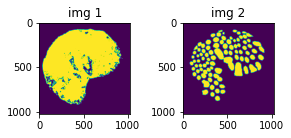

1.130395770072937


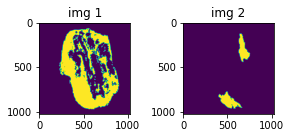

0.585402250289917


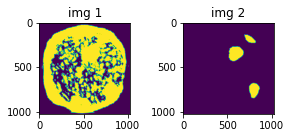

0.5668522715568542


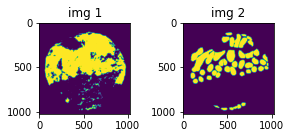

1.2151674032211304


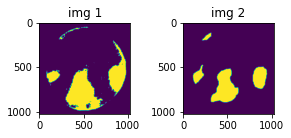

1.0558849573135376


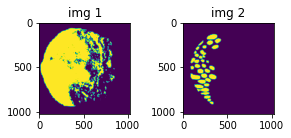

0.7571719884872437


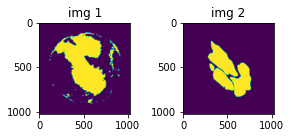

0.6590510010719299


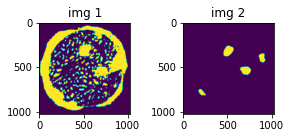

0.6090574860572815


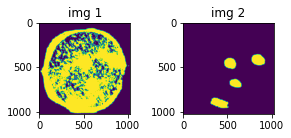

0.6747434139251709


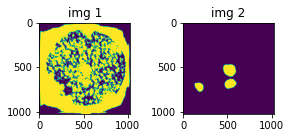

0.3827010989189148


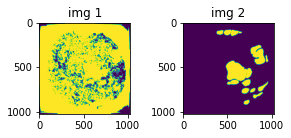

0.20709510147571564


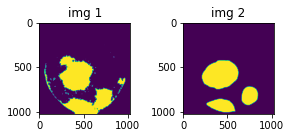

1.0868513584136963


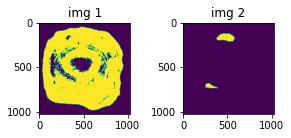

0.21950167417526245


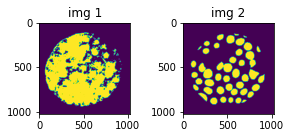

1.0198006629943848


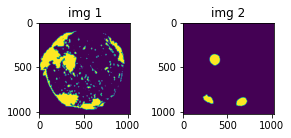

0.8470951318740845


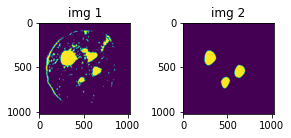

1.0153838396072388


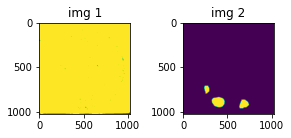

0.21284349262714386


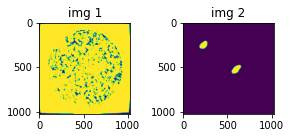

0.11973296850919724


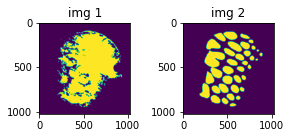

1.0674747228622437


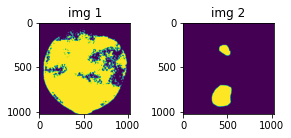

0.33304229378700256


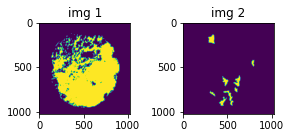

0.3405008316040039


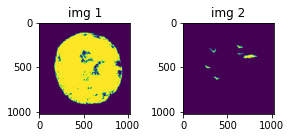

0.1301272064447403


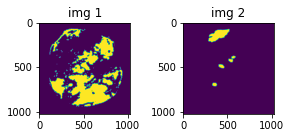

0.09837252646684647


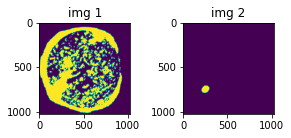

0.13837820291519165


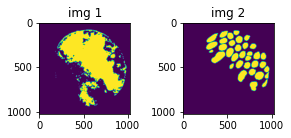

1.0792263746261597


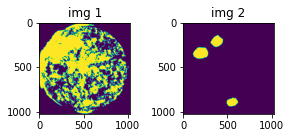

0.5935194492340088


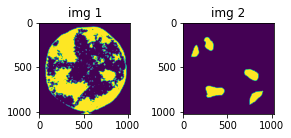

0.5418993830680847


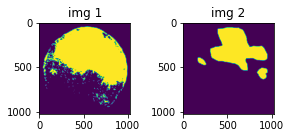

0.9722108244895935


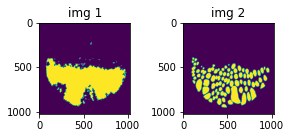

1.0535821914672852


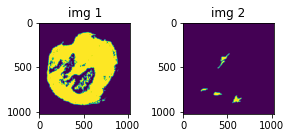

0.20887517929077148


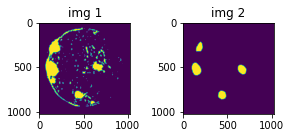

1.15396249294281


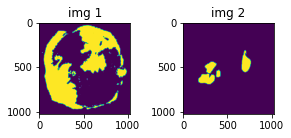

0.20879249274730682


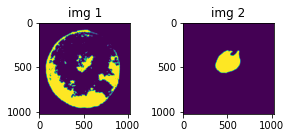

0.2057626098394394


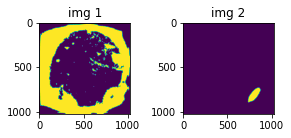

0.053516969084739685


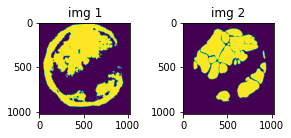

0.6910115480422974


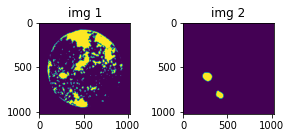

0.3789909780025482
FOLD: 0, EPOCH: 36, valid_loss: 0.6868407301266085 , Val Dice COE : 0.5969980760816146


  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 37, train_loss: 0.5720967636363847 , Dice coe : 0.6902630511271068 
0.1634620726108551
0.9956887364387512
0.6589744091033936
0.5734850168228149
0.03565472736954689
1.0031100511550903
1.108473777770996
1.0389379262924194
0.595232367515564
0.29826727509498596
0.38132959604263306
0.38871750235557556
1.1177008152008057
0.6637914180755615
0.25976598262786865
1.1433665752410889
0.6008368134498596
0.596460223197937
0.49039074778556824
1.2696080207824707
0.2896130681037903
0.4143182337284088
0.5696540474891663
0.4961506724357605
0.26839861273765564
0.1575816124677658
0.11598961055278778
0.45101985335350037
0.44323235750198364
0.19672049582004547
1.1258083581924438
1.0189197063446045
0.24416349828243256
0.46897628903388977
1.002683162689209
0.9584257006645203
0.79344642162323
0.16567276418209076
0.6000536680221558
0.26181113719940186
0.36092451214790344
0.10170827060937881
0.36591941118240356
0.5872598886489868
0.7981792092323303
0.7105467319488525
0.8817581534385681
0.781596004

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 38, train_loss: 0.5549048377360617 , Dice coe : 0.7202431950068422 
0.1722479611635208
1.0098371505737305
0.6846981048583984
0.5910382270812988
0.039622098207473755
0.9744694232940674
1.105006456375122
1.0536991357803345
0.6259805560112
0.32026970386505127
0.39537379145622253
0.4339759349822998
1.1293540000915527
0.7065492272377014
0.25150778889656067
1.142078161239624
0.6359056234359741
0.6270684599876404
0.5012157559394836
1.2672051191329956
0.3090954124927521
0.44075363874435425
0.5877549052238464
0.5146092772483826
0.2966610789299011
0.15763457119464874
0.11970194429159164
0.4857395589351654
0.47687217593193054
0.21557241678237915
1.1666408777236938
1.041839361190796
0.2609701454639435
0.4946480989456177
1.0318379402160645
0.9968259930610657
0.8177548050880432
0.17551842331886292
0.6335742473602295
0.24164842069149017
0.36193060874938965
0.10561122745275497
0.4022158682346344
0.5907444953918457
0.8275160789489746
0.7343733310699463
0.9320656657218933
0.8054783940315

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 39, train_loss: 0.5681718772649765 , Dice coe : 0.6813517817855804 
0.1726979911327362
1.0022599697113037
0.7133882641792297
0.6090782880783081
0.03794131055474281
1.0360127687454224
1.11832594871521
1.059059739112854
0.6035428643226624
0.31586700677871704
0.43076133728027344
0.49488386511802673
1.0894885063171387
0.76980060338974
0.2589322328567505
1.1449280977249146
0.6516379117965698
0.6455973386764526
0.5497427582740784
1.2661218643188477
0.36772528290748596
0.5051658749580383
0.5733418464660645
0.5625460147857666
0.36163052916526794
0.1581813544034958
0.12466677278280258
0.5097801089286804
0.4052348732948303
0.2252061367034912
1.1918838024139404
1.090712070465088
0.30237868428230286
0.5553625822067261
1.0835833549499512
0.872434675693512
0.808029055595398
0.1680072844028473
0.647534966468811
0.3006688952445984
0.3661620616912842
0.10802304744720459
0.44076135754585266
0.5882700085639954
0.8223299384117126
0.7046830654144287
0.9938417673110962
0.7956799268722534
0.8

  0%|          | 0/175 [00:00<?, ?it/s]

FOLD: 0, EPOCH: 40, train_loss: 0.5723271807176726 , Dice coe : 0.6962314190693035 
0.16891731321811676
0.9970188140869141
0.7098845839500427
0.6054360866546631
0.039351936429739
0.9678884744644165
1.1014952659606934
1.0528895854949951
0.6070235967636108
0.30679526925086975
0.41540923714637756
0.47640261054039
1.1135172843933105
0.7398290038108826
0.24966026842594147
1.1375484466552734
0.6371428966522217
0.6220005750656128
0.5095266699790955
1.2651838064193726
0.32750871777534485
0.4753810167312622
0.5673444867134094
0.5354363322257996
0.3277357220649719
0.15787655115127563
0.12300779670476913
0.47182634472846985
0.4569135308265686
0.2214898020029068
1.1896837949752808
1.0677464008331299
0.28407031297683716
0.5075653791427612
1.032004475593567
0.9870664477348328
0.8106192350387573
0.1688135862350464
0.6272642612457275
0.2518722712993622
0.36038416624069214
0.10629638284444809
0.42724305391311646
0.5937417149543762
0.8326882123947144
0.716458797454834
0.9188441634178162
0.79566115140914

In [20]:
print(f"Running on device :  {DEVICE}" )
for fold in range(nfolds):
    
    val_losses = []
    losses = []
    train_scores=[]
    val_scores = []
    best_loss = 999
    best_score = 0
    
    ds_train = HuBMAPDataset(fold=fold, train=True, tfms=transformer())
    ds_val = HuBMAPDataset(fold=fold, train=False)
    
    dataloader_train = torch.utils.data.DataLoader(ds_train,batch_size=BATCH_SIZE, shuffle=True,num_workers=NUM_WORKERS)
    dataloader_val = torch.utils.data.DataLoader(ds_val,batch_size=1, shuffle=False,num_workers=NUM_WORKERS)
    
    model = init_model().to(DEVICE)
    
    optimizer = torch.optim.Adam([
        {'params': model.decoder.parameters(), 'lr': 5e-4}, 
        {'params': model.encoder.parameters(), 'lr': 8e-4},  
    ])
    
    scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer=optimizer, pct_start=0.1, div_factor=1e3, 
                                              max_lr=1e-3, epochs=EPOCHS, steps_per_epoch=len(dataloader_train))
    
    loss_func = CustomLoss()
    dice_coe = DiceCoef()
    
    print(f"######## FOLD: {fold} ##############")
    
    
    
    for epoch in tqdm.notebook.tqdm(range(EPOCHS)):
        
        ### Train ###########################################################################################
        
        model.train()
        train_loss = 0
        score = 0
        
        for data in tqdm.notebook.tqdm(dataloader_train ,total = len(dataloader_train)):
            optimizer.zero_grad()
            img, mask = data
            img = img.to(DEVICE)
            mask = mask.to(DEVICE)
        
            outputs = model(img)['probability']    

            loss = loss_func(outputs, mask)
            loss.backward()
            optimizer.step()
            scheduler.step()
            train_loss += loss.item()
            score += dice_coe(outputs,mask).item()

            
        train_loss /= len(dataloader_train)
        score /= len(dataloader_train)
        losses.append(train_loss)
        train_scores.append(score)
        print(f"FOLD: {fold}, EPOCH: {epoch + 1}, train_loss: {train_loss} , Dice coe : {score} ") #
        
        
        gc.collect()
        torch.cuda.empty_cache()
        
        ### Validation ####################################################################################
        
        model.eval()
        
        with torch.no_grad():
            
            valid_loss = 0
            val_score = 0
            
            for data in dataloader_val:
                
                img, mask = data
                img = img.to(DEVICE)
                mask = mask.to(DEVICE)

                outputs = model(img)['probability']
                


                if epoch%5 == 0:
                    masks = (outputs.permute((0, 2, 3, 1))>0.4).to(torch.uint8).cpu().detach().numpy()
                    msk = cv2.resize(masks[0].squeeze(), dsize=(1024, 1024), interpolation=cv2.INTER_NEAREST)

                    #msk.astype(np.float32)

                    fig = plt.figure()
                    rows = 1; cols = 3

                    ax1 = fig.add_subplot(rows, cols, 1)
                    ax1.set_title('img 1')
                    ax1.imshow(msk*255)

                    ax2 = fig.add_subplot(rows, cols, 2)
                    ax2.set_title('img 2')
                    ax2.imshow(mask.to(torch.uint8).cpu().detach().numpy().squeeze()*255)

                    #gc.collect()


                    #plt.imshow(msk*255)

                    #plt.imshow(mask.to(torch.uint8).cpu().detach().numpy().squeeze()*255)

                    fig.tight_layout()
                    plt.show()
                    #print(outputs.cpu().size())

                loss = loss_func(outputs, mask)
                valid_loss += loss.item()
                temp = dice_coe(outputs,mask).item()
                print(temp)
                val_score += temp
                #gc.collect()
                
            valid_loss /= len(dataloader_val)
            val_losses.append(valid_loss)
            
            val_score /= len(dataloader_val)
            val_scores.append(val_score)
            
            print(f"FOLD: {fold}, EPOCH: {epoch + 1}, valid_loss: {valid_loss} , Val Dice COE : {val_score}") #
            
            gc.collect()
            torch.cuda.empty_cache()
            
        if val_score > best_score:
            best_score = val_score
            torch.save(model.state_dict(), f"/kaggle/working/FOLD{fold}_best_score.pth")
            print(f"Saved model for best score : FOLD{fold}_best_score.pth")
            
        if valid_loss < best_loss:
            best_loss = valid_loss
            torch.save(model.state_dict(), f"/kaggle/working/FOLD{fold}_best_loss.pth")
            print(f"Saved model for best loss : FOLD{fold}_best_loss.pth")   
           
    break
    
    column_names = ['Train_loss','Val_loss','Train_Dice','Val_Dice']
    df = pd.DataFrame(np.stack([losses,val_losses,train_scores,val_scores],axis=1),columns=column_names)
    print(f" ################# FOLD {fold} #####################")
    plot_df(df)
    plt.show(block=False)
    df.to_csv(f"logs_fold{fold}.csv")

## Model

## Train